In [21]:
import sys
sys.version_info 

sys.version_info(major=3, minor=7, micro=3, releaselevel='final', serial=0)

I like to use this little trick: since many of the cistopic commands take a long time (>1 hour), I let the notebook play a sound after they're finished.

In [22]:
from IPython.display import Audio
sound_file = '/staging/leuven/stg_00002/lcb/fderop/data/00000000_scripts/beep_silent.wav'
Audio(sound_file, autoplay=True)

In [23]:
import pycisTopic
pycisTopic.__version__

'0.1.dev214+gc72ef83.d20210522'

In [24]:
%matplotlib inline

In [25]:
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

In [26]:
import pybiomart as pbm
import pandas as pd
import pickle

from pycisTopic.cistopic_class import *
from pycisTopic.qc import *
from pycisTopic.lda_models import *
from pycisTopic.clust_vis import *
from pycisTopic.topic_qc import *
from pycisTopic.diff_features import *
from pycisTopic.pseudobulk_peak_calling import *
from pycisTopic.iterative_peak_calling import *
from pycisTopic.topic_binarization import *

import glob

change the working directory to where you stored your `fragments/` directory.

In [27]:
import os
wdir = '/staging/leuven/stg_00002/lcb/fderop/data/20210407_20210323_reseq/'
os.chdir(wdir)

cistopic_out is where the cistopic output will go.

In [28]:
cistopic_out = 'pycistopic_consensus/'

# Get genome annotations from biomart
This information is necessary for cisTopic to calculate e.g. TSS enrichment. We are analysing mm10 mapped data here, so we pick the mm10 option. The biomart output is reshaped a little to fit cisTopic's needs.

In [29]:
# For mm10:
dataset = pbm.Dataset(name='mmusculus_gene_ensembl',  host='http://nov2020.archive.ensembl.org/')
# For human:
# dataset = pbm.Dataset(name='hsapiens_gene_ensembl',  host='http://www.ensembl.org')
# dataset = pbm.Dataset(name='hsapiens_gene_ensembl',  host='http://grch37.ensembl.org/')


# For fly
#dataset = pbm.Dataset(name='dmelanogaster_gene_ensembl',  host='http://www.ensembl.org')

annot = dataset.query(attributes=['chromosome_name', 'transcription_start_site', 'strand', 'external_gene_name', 'transcript_biotype'])
filter = annot['Chromosome/scaffold name'].str.contains('CHR|GL|JH|MT')
annot = annot[~filter]
annot['Chromosome/scaffold name'] = annot['Chromosome/scaffold name'].str.replace(r'(\b\S)', r'chr\1')
annot.columns=['Chromosome', 'Start', 'Strand', 'Gene', 'Transcript_type']
annot = annot[annot.Transcript_type == 'protein_coding']

In [30]:
annot

,Chromosome,Start,Strand,Gene,Transcript_type
58,chr2,154551776,1,Actl10,protein_coding
624,chrX,31117674,1,Btbd35f29,protein_coding
946,chr7,84915781,1,Olfr290,protein_coding
977,chrY,90839177,-1,Gm21748,protein_coding
1000,chr4,108719649,1,3110021N24Rik,protein_coding
...,...,...,...,...,...
136372,chr6,134791334,-1,Dusp16,protein_coding
136373,chr14,51203391,1,Ear14,protein_coding
136374,chr14,51203689,1,Ear14,protein_coding
136378,chr12,85274286,1,Zc2hc1c,protein_coding


# Calculate cell metadata
Cistopic is going to calculate a number of statistics, e.g. number of total unique fragments, number of reads in peaks, TSS enrichment, ... on which we will later base our cell filtering. We make two dictionaries, one with a fragments file for each sample, and one with a regions file for each sample.

In [5]:
filenames = glob.glob('fragments/*.fragments.NONEGS.tsv.gz')
samples = [item.replace(".sinto.fragments.NONEGS.tsv.gz", "") for item in filenames]
samples = [item.replace("fragments/", "") for item in samples]
fragments_dict = {samples[i]: filenames[i] for i in range(len(samples))}
fragments_dict

{'HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5.sinto.fragments.NONEGS.tsv.gz',
 'HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2': 'fragments/HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4.sinto.fragments.NONEGS.tsv.gz',
 'HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3': 'fragments/HYA__af8d60__20210309_mouse_cortex_MC

In [1]:
!md5sum fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1.sinto.fragments.NONEGS.tsv.gz
!md5sum fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5.sinto.fragments.NONEGS.tsv.gz
!md5sum fragments/HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2.sinto.fragments.NONEGS.tsv.gz
!md5sum fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3.sinto.fragments.NONEGS.tsv.gz
!md5sum fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2.sinto.fragments.NONEGS.tsv.gz
!md5sum fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4.sinto.fragments.NONEGS.tsv.gz
!md5sum fragments/HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3.sinto.fragments.NONEGS.tsv.gz

4482f047aa400aee1263040822c91893  fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1.sinto.fragments.NONEGS.tsv.gz
d85a2170ae114d1ff057e9c22e280e28  fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5.sinto.fragments.NONEGS.tsv.gz
cfd87502669b7b6144e7965c23e6382f  fragments/HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2.sinto.fragments.NONEGS.tsv.gz
7f92ad43fa92f500c9daf11a6ead631b  fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3.sinto.fragments.NONEGS.tsv.gz
63249395f21de953f1a291e64aa8af79  fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2.sinto.fragments.NONEGS.tsv.gz
fcb305fe754db0bab4f6fae44361ee3e  fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4.sinto.fragments.NONEGS.tsv.gz
214079180f2469e2f20914bbcea49f8c  fragments/HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3.sinto.fragments.NONEGS.tsv.gz


In the first pass of cisTopic, I use SCREEN regions. Later on, I will call peaks on the aggregate of the resulting clusters of this first pass. Re-counting fragments in these consensus peaks will deliver a more accurate clustering. We use a version of the mm10 SCREEN regions that is filtered for the genome blacklist.

In [6]:
regions = '/staging/leuven/stg_00002/lcb/fderop/data/00000000_regions/mm10_SCREEN_regions/V2.mm10-rDHS-Unfiltered.blacklisted.bed'
regionslist = [regions] * len(fragments_dict)
path_to_regions = {samples[i]: regionslist[i] for i in range(len(samples))}
path_to_regions

{'HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1': '/staging/leuven/stg_00002/lcb/fderop/data/00000000_regions/mm10_SCREEN_regions/V2.mm10-rDHS-Unfiltered.blacklisted.bed',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5': '/staging/leuven/stg_00002/lcb/fderop/data/00000000_regions/mm10_SCREEN_regions/V2.mm10-rDHS-Unfiltered.blacklisted.bed',
 'HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2': '/staging/leuven/stg_00002/lcb/fderop/data/00000000_regions/mm10_SCREEN_regions/V2.mm10-rDHS-Unfiltered.blacklisted.bed',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3': '/staging/leuven/stg_00002/lcb/fderop/data/00000000_regions/mm10_SCREEN_regions/V2.mm10-rDHS-Unfiltered.blacklisted.bed',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2': '/staging/leuven/stg_00002/lcb/fderop/data/00000000_regions/mm10_SCREEN_regions/V2.mm10-rDHS-Unfiltered.blacklisted.bed',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4': '/staging/leuven/stg_00002/lcb/fderop/data/00000000_regions

Now, I let cisTopic do its thing and calculate all the metadata. You can vary `n_cpu` to speed up the process and `n_frag` to change the minimum number of fragments associated with a barcode for cisTopic to even consider it for metadata calculation.

In [13]:
ray.shutdown()
metadata_bc_dict, profile_data_dict = compute_qc_stats(fragments_dict = fragments_dict,
                tss_annotation = annot,
                stats=['barcode_rank_plot', 'duplicate_rate', 'insert_size_distribution', 'profile_tss', 'frip'],
                label_list = None,
                path_to_regions = path_to_regions,
                n_cpu = 16,
                valid_bc = None,
                n_frag = 10,
                n_bc = None,
                tss_flank_window = 2000,
                tss_window = 50,
                tss_minimum_signal_window = 100,
                tss_rolling_window = 10,
                # min_norm=0.2,
                remove_duplicates = True)

2021-04-09 23:19:12,448	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=37516) 2021-04-09 23:19:46,144 cisTopic     INFO     Reading HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5
(pid=37513) 2021-04-09 23:19:46,149 cisTopic     INFO     Reading HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1
(pid=37512) 2021-04-09 23:19:46,148 cisTopic     INFO     Reading HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4
(pid=37514) 2021-04-09 23:19:46,155 cisTopic     INFO     Reading HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2
(pid=37517) 2021-04-09 23:19:46,148 cisTopic     INFO     Reading HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2
(pid=37515) 2021-04-09 23:19:46,159 cisTopic     INFO     Reading HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3
(pid=37514) 2021-04-09 23:19:50,548 cisTopic     INFO     Computing barcode rank plot for HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2
(pid=37514) 2021-04-09 23:19:50,548 cisTopic     INFO     Counting fragments
(pid=37515) 2021-04-09 23:19:50,675 cisTopic     INFO     Computing barcode r

(pid=37514) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=37514)   warnings.warn(msg, FutureWarning)


(pid=37514) 2021-04-09 23:21:27,577 cisTopic     INFO     Sample HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2 done!
(pid=37514) 2021-04-09 23:21:28,131 cisTopic     INFO     Reading HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3
(pid=37515) 2021-04-09 23:21:46,122 cisTopic     INFO     Returning normalized sample TSS enrichment data
(pid=37515) 2021-04-09 23:21:46,275 cisTopic     INFO     Computing FRIP profile for HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3
(pid=37515) 2021-04-09 23:21:47,178 cisTopic     INFO     Using provided valid barcodes
(pid=37515) 2021-04-09 23:21:51,158 cisTopic     INFO     Counting fragments
(pid=37515) 2021-04-09 23:21:52,581 cisTopic     INFO     Intersecting fragments with regions


(pid=37515) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=37515)   warnings.warn(msg, FutureWarning)


(pid=37515) 2021-04-09 23:21:55,128 cisTopic     INFO     Sample HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3 done!
(pid=37514) 2021-04-09 23:22:17,623 cisTopic     INFO     Computing barcode rank plot for HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3
(pid=37514) 2021-04-09 23:22:17,623 cisTopic     INFO     Counting fragments
(pid=37514) 2021-04-09 23:22:52,063 cisTopic     INFO     Marking barcodes with more than 10
(pid=37514) 2021-04-09 23:22:54,109 cisTopic     INFO     Returning plot data
(pid=37514) 2021-04-09 23:22:54,175 cisTopic     INFO     Returning valid barcodes
(pid=37514) 2021-04-09 23:22:54,341 cisTopic     INFO     Computing duplicate rate plot for HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3
(pid=37514) 2021-04-09 23:22:54,342 cisTopic     INFO     Using provided valid barcodes
(pid=37513) 2021-04-10 00:17:58,279 cisTopic     INFO     Computing insert size distribution for HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1
(pid=37513) 2021-04-10 00:

(pid=37513) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=37513)   warnings.warn(msg, FutureWarning)


(pid=37513) 2021-04-10 00:37:09,352 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1 done!
(pid=37512) 2021-04-10 00:41:46,723 cisTopic     INFO     Computing insert size distribution for HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4
(pid=37512) 2021-04-10 00:41:46,723 cisTopic     INFO     Using provided valid barcodes
(pid=37512) 2021-04-10 00:41:58,352 cisTopic     INFO     Counting fragments
(pid=37512) 2021-04-10 00:41:59,435 cisTopic     INFO     Returning plot data
(pid=37512) 2021-04-10 00:41:59,837 cisTopic     INFO     Computing TSS profile for HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4
(pid=37512) 2021-04-10 00:42:10,006 cisTopic     INFO     Using provided valid barcodes
(pid=37512) 2021-04-10 00:42:23,561 cisTopic     INFO     Formatting annnotation
(pid=37512) 2021-04-10 00:42:23,623 cisTopic     INFO     Overlapping fragments with TSS
(pid=37512) 2021-04-10 00:42:33,024 cisTopic     INFO     Getting cut sites
(pid=37512) 2021-0

(pid=37517) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=37517)   warnings.warn(msg, FutureWarning)


(pid=37517) 2021-04-10 00:51:43,703 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2 done!
(pid=37512) 2021-04-10 00:54:33,229 cisTopic     INFO     Returning normalized TSS coverage matrix per barcode
(pid=37512) 2021-04-10 01:00:12,099 cisTopic     INFO     Returning normalized sample TSS enrichment data
(pid=37512) 2021-04-10 01:00:14,507 cisTopic     INFO     Computing FRIP profile for HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4
(pid=37512) 2021-04-10 01:00:23,830 cisTopic     INFO     Using provided valid barcodes
(pid=37512) 2021-04-10 01:00:39,687 cisTopic     INFO     Counting fragments
(pid=37512) 2021-04-10 01:01:00,697 cisTopic     INFO     Intersecting fragments with regions


(pid=37512) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=37512)   warnings.warn(msg, FutureWarning)


(pid=37512) 2021-04-10 01:01:34,435 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4 done!
(pid=37516) 2021-04-10 01:09:33,712 cisTopic     INFO     Computing insert size distribution for HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5
(pid=37516) 2021-04-10 01:09:33,712 cisTopic     INFO     Using provided valid barcodes
(pid=37516) 2021-04-10 01:09:43,498 cisTopic     INFO     Counting fragments
(pid=37516) 2021-04-10 01:09:44,976 cisTopic     INFO     Returning plot data
(pid=37516) 2021-04-10 01:09:45,491 cisTopic     INFO     Computing TSS profile for HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5
(pid=37516) 2021-04-10 01:09:56,462 cisTopic     INFO     Using provided valid barcodes
(pid=37516) 2021-04-10 01:10:07,667 cisTopic     INFO     Formatting annnotation
(pid=37516) 2021-04-10 01:10:07,734 cisTopic     INFO     Overlapping fragments with TSS
(pid=37516) 2021-04-10 01:10:17,935 cisTopic     INFO     Getting cut sites
(pid=37516) 2021-0

(pid=37516) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=37516)   warnings.warn(msg, FutureWarning)


(pid=37516) 2021-04-10 01:34:45,270 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5 done!
(pid=37514) 2021-04-10 01:38:28,935 cisTopic     INFO     Returning normalized TSS coverage matrix per barcode
(pid=37514) 2021-04-10 01:46:06,524 cisTopic     INFO     Returning normalized sample TSS enrichment data
(pid=37514) 2021-04-10 01:46:10,341 cisTopic     INFO     Computing FRIP profile for HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3
(pid=37514) 2021-04-10 01:46:21,785 cisTopic     INFO     Using provided valid barcodes
(pid=37514) 2021-04-10 01:46:39,719 cisTopic     INFO     Counting fragments
(pid=37514) 2021-04-10 01:47:13,949 cisTopic     INFO     Intersecting fragments with regions


(pid=37514) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=37514)   warnings.warn(msg, FutureWarning)


(pid=37514) 2021-04-10 01:47:59,903 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3 done!


In [33]:
Audio(sound_file, autoplay=True)

# Save metadata
Save cistopic's calculated metadata

In [35]:
cistopic_out = wdir  + 'cistopic_out/'
if not os.path.exists(cistopic_out):
    os.makedirs(cistopic_out)

In [36]:
cistopic_out = cistopic_out + 'quality+control/'
if not os.path.exists(cistopic_out):
    os.makedirs(cistopic_out)

In [18]:
with open(cistopic_out + 'metadata_bc.pkl', 'wb') as f:
  pickle.dump(metadata_bc_dict, f, protocol=4)

with open(cistopic_out + 'profile_data_dict.pkl', 'wb') as f:
  pickle.dump(profile_data_dict, f, protocol=4)

# load metadata
Load the metadata. You can come back to this checkpoint later

In [37]:
# Load metadata
import pickle
infile = open(cistopic_out + '/metadata_bc.pkl', 'rb')
metadata_bc_dict = pickle.load(infile)
infile.close()

infile = open(cistopic_out + '/profile_data_dict.pkl', 'rb')
profile_data_dict = pickle.load(infile)
infile.close()

FileNotFoundError: [Errno 2] No such file or directory: '/staging/leuven/stg_00002/lcb/fderop/data/20210407_20210323_reseq/cistopic_out/quality+control//metadata_bc.pkl'

# QC filtering
Now, we filter the cells based on the metadata calculations

In [22]:
from fastkde import fastKDE
from pycisTopic.qc import plot_sample_metrics
from scipy.stats import gaussian_kde
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

%matplotlib inline

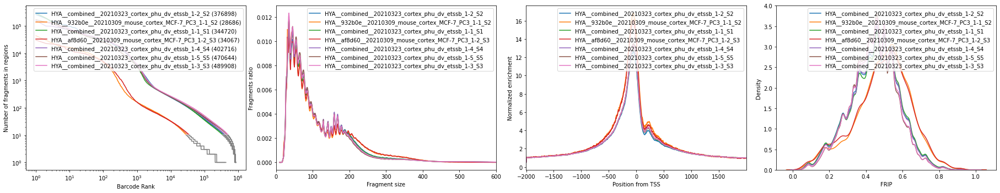

In [25]:
cistopic_out = 'pycistopic_consensus/'

plot_sample_metrics(
           profile_data_dict,
           profile_list=['barcode_rank_plot', 'insert_size_distribution', 'profile_tss', 'frip'],
           insert_size_distriubtion_xlim=[0,600],
           #legend_outside=True,
           ncol=4,
           cmap='Paired',
           plot=True,
           save=cistopic_out + 'sample_metrics.pdf')

We can inspect these plots and check if the data is up to par. We now define lower bounds for number of unique fragments and TSS enrichment and filter cells based on these minima.

In [35]:
frags_lower = [1000, 1000, 1000, 1000, 1000]
tss_lower = [5, 5, 5, 5, 5]
filenames = glob.glob('fragments/*.fragments.tsv.gz')
filter_frags_lower = {samples[i]: frags_lower[i] for i in range(len(samples))}
filter_tss_lower = {samples[i]: tss_lower[i] for i in range(len(samples))}

In [38]:
def plot_frag_qc(x, y, 
                 ax,
                 x_thr_min=None, x_thr_max=None,
                 y_thr_min=None, y_thr_max=None,
                 ylab=None,
                 xlab="Number of (unique) fragments",
                 cmap='viridis',
                 density_overlay=False,
                 s=10,
                 marker='+',
                 c='#343434',
                 xlim=None,
                 ylim=None,
                 **kwargs
                ):
    assert all(x.index == y.index)
    barcodes = x.index.values
    if density_overlay:
        pdf,axes = fastKDE.pdf(x.to_numpy(),y.to_numpy())
        xy = np.vstack([np.log(x),y])
        z = gaussian_kde(xy)(xy)
        idx = z.argsort()
        x, y, z, barcodes = x[idx], y[idx], z[idx], barcodes[idx]
    else:
        z=c
    barcodes_to_keep=[]
    sp=ax.scatter(x, y, c=z, s=s, edgecolors=None, marker=marker, cmap=cmap, **kwargs)
    #fig.colorbar(sp)
    if ylim is not None:
        ax.set_ylim(ylim[0], ylim[1])
    if xlim is not None:
        ax.set_xlim(xlim[0], xlim[1])
    # thresholds:
    if x_thr_min is not None:    
        ax.axvline(x=x_thr_min, color='r', linestyle='--')
        barcodes_to_keep.append(barcodes[x>x_thr_min])
    if x_thr_max is not None:    
        ax.axvline(x=x_thr_max, color='r', linestyle='--')
        barcodes_to_keep.append(barcodes[x<x_thr_max])
    if y_thr_min is not None:    
        ax.axhline(y=y_thr_min, color='r', linestyle='--')
        barcodes_to_keep.append(barcodes[y>y_thr_min])
    if y_thr_max is not None:    
        ax.axhline(y=y_thr_max, color='r', linestyle='--')
        barcodes_to_keep.append(barcodes[y<y_thr_max])
    ax.set_xscale("log")
    ax.set_xmargin(0.01)
    ax.set_ymargin(0.01)
    ax.set_xlabel(xlab,fontsize=10)
    ax.set_ylabel(ylab,fontsize=10)
    #ax.colorbar().set_label('Density')
    #return barcodes_to_keep
    if len(barcodes_to_keep)>0:
        return list(set.intersection(*map(set, barcodes_to_keep)))
    else:
        return barcodes


In [36]:
include_kde = False # set to False for faster draft-quality plots
detailed_title=True
s=4
bc_passing_filters = {}
for k,v in metadata_bc_dict.items():
    fig, (ax1,ax2,ax3) = plt.subplots(1,3, figsize=(12,4), dpi=150 )
    p1_cells = plot_frag_qc(
        x = metadata_bc_dict[k]['Unique_nr_frag'],
        y = metadata_bc_dict[k]['TSS_enrichment'],
        ylab = 'TSS Enrichment',
        s=s,
        x_thr_min=filter_frags_lower[k],
        y_thr_min=filter_tss_lower[k],
        density_overlay=include_kde,
        ax=ax1
    )
    p2_cells = plot_frag_qc(
        x = metadata_bc_dict[k]['Unique_nr_frag'],
        y = metadata_bc_dict[k]['FRIP'],
        x_thr_min=filter_frags_lower[k],
        ylab = 'FRIP',
        s=s,
        ylim=[0,1],
        density_overlay=include_kde,
        ax=ax2
    )
    p3_cells = plot_frag_qc(
        x = metadata_bc_dict[k]['Unique_nr_frag'],
        y = metadata_bc_dict[k]['Dupl_rate'],
        x_thr_min=filter_frags_lower[k],
        ylab = 'Duplicate rate per cell',
        s=s,
        ylim=[0,1],
        density_overlay=include_kde,
        ax=ax3
    )
    bc_passing_filters[k] = list(set(p1_cells) & set(p2_cells) & set(p3_cells))
    if detailed_title:
        med_nf = metadata_bc_dict[k].loc[bc_passing_filters[k],'Unique_nr_frag'].median()
        med_tss = metadata_bc_dict[k].loc[bc_passing_filters[k],'TSS_enrichment'].median()
        title = f"{k}: Kept {len(bc_passing_filters[k])} cells. Median(fragments): {med_nf:.0f}. Median(TSS Enrichment): {med_tss:.2f})"
    else:
        title = k
    fig.suptitle(title, x=0.5, y=0.95, fontsize=10)
    plt.tight_layout()
    plt.savefig(cistopic_out + k + ".png", bbox_inches = "tight", transparent=False, facecolor='w', edgecolor='w', dpi=150)

In [32]:
Audio(sound_file, autoplay=True)

# Save the barcodes passing filters

In [37]:
with open(cistopic_out + 'bc_passing_filters.pkl', 'wb') as f:
  pickle.dump(bc_passing_filters, f)

## Create merged figure for all samples

In [ ]:
metadata_bc_dict_merged = pd.concat(metadata_bc_dict.values(), ignore_index=True)

In [ ]:
k, v = metadata_bc_dict_merged.items()

In [19]:
include_kde = False # set to False for faster draft-quality plots
detailed_title=True
s=2
bc_passing_filters = {}
filter_frags_lower = 1000
filter_tss_lower = 5
fig, (ax1,ax2,ax3) = plt.subplots(1,3, figsize=(12,4), dpi=150 )
p1_cells = plot_frag_qc(
	x = metadata_bc_dict_merged['Unique_nr_frag'],
	y = metadata_bc_dict_merged['TSS_enrichment'],
	ylab = 'TSS Enrichment',
	s=s,
	x_thr_min=filter_frags_lower,
	y_thr_min=filter_tss_lower,
	density_overlay=include_kde,
	ax=ax1
)
p2_cells = plot_frag_qc(
	x = metadata_bc_dict_merged['Unique_nr_frag'],
	y = metadata_bc_dict_merged['FRIP'],
	x_thr_min=filter_frags_lower,
	ylab = 'FRIP',
	s=s,
	ylim=[0,1],
	density_overlay=include_kde,
	ax=ax2
)
p3_cells = plot_frag_qc(
	x = metadata_bc_dict_merged['Unique_nr_frag'],
	y = metadata_bc_dict_merged['Dupl_rate'],
	x_thr_min=filter_frags_lower,
	ylab = 'Duplicate rate per cell',
	s=s,
	ylim=[0,1],
	density_overlay=include_kde,
	ax=ax3
)
bc_passing_filters = list(set(p1_cells) & set(p2_cells) & set(p3_cells))
if detailed_title:
	med_nf = metadata_bc_dict_merged.loc[bc_passing_filters,'Unique_nr_frag'].median()
	med_tss = metadata_bc_dict_merged.loc[bc_passing_filters,'TSS_enrichment'].median()
	title = f"{k}: Kept {len(bc_passing_filters)} cells. Median(fragments): {med_nf:.0f}. Median(TSS Enrichment): {med_tss:.2f})"
else:
	title = 'merged'
fig.suptitle(title, x=0.5, y=0.95, fontsize=10)
plt.tight_layout()
plt.savefig(cistopic_out + 'merged' + "_nokde.png", bbox_inches = "tight", transparent=False, facecolor='w', edgecolor='w', dpi=150)

In [20]:
Audio(sound_file, autoplay=True)

# Create cisTopic object
Now, we will generate a cistopic object for the selected cells. First, reload the metadata for good measure.

In [13]:
# Metrics
infile = open(cistopic_out + '/metadata_bc.pkl', 'rb')
metadata_bc = pickle.load(infile)
infile.close()
# Valid barcodes
infile = open(cistopic_out + 'bc_passing_filters.pkl', 'rb')
bc_passing_filters = pickle.load(infile)
infile.close()

In [14]:
from pycisTopic.cistopic_class import create_cistopic_object_from_fragments

In [15]:
path_to_blacklist = '/ddn1/vol1/staging/leuven/stg_00002/lcb/cbravo/Multiomics_pipeline/pycisTopic/blacklist/mm10-blacklist.v2.bed'
# path_to_blacklist = '/ddn1/vol1/staging/leuven/stg_00002/lcb/cbravo/Multiomics_pipeline/pycisTopic/blacklist/hg38-blacklist.v2.bed'

Double check if all the dictionaries involved have the same keys.

In [16]:
fragments_dict.keys() == fragments_dict.keys() == path_to_regions.keys() == metadata_bc_dict.keys()

True

Create the cistopic objects for all samples

In [18]:
#Create all objects
cistopic_obj_list=[create_cistopic_object_from_fragments(path_to_fragments=fragments_dict[key],
                                               path_to_regions=path_to_regions[key],
                                               path_to_blacklist=path_to_blacklist,
                                               metrics=metadata_bc_dict[key],
                                               valid_bc=bc_passing_filters[key],
                                               n_cpu=45,
                                               project=key) for key in fragments_dict.keys()]

2021-04-10 02:22:56,206 cisTopic     INFO     Reading data for HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2
2021-04-10 02:23:47,438 cisTopic     INFO     metrics provided!
2021-04-10 02:23:58,372 cisTopic     INFO     valid_bc provided, selecting barcodes!
2021-04-10 02:24:02,272 cisTopic     INFO     Counting fragments in regions


2021-04-10 02:24:13,865	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


2021-04-10 02:24:42,543 cisTopic     INFO     Creating fragment matrix
2021-04-10 02:26:47,389 cisTopic     INFO     Converting fragment matrix to sparse matrix
2021-04-10 02:27:13,911 cisTopic     INFO     Removing blacklisted regions
2021-04-10 02:27:17,999 cisTopic     INFO     Creating CistopicObject
2021-04-10 02:27:20,399 numexpr.utils INFO     Note: NumExpr detected 48 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
2021-04-10 02:27:20,611 cisTopic     INFO     Done!
2021-04-10 02:27:21,197 cisTopic     INFO     Reading data for HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2
2021-04-10 02:27:29,376 cisTopic     INFO     metrics provided!
2021-04-10 02:27:30,074 cisTopic     INFO     valid_bc provided, selecting barcodes!
2021-04-10 02:27:30,399 cisTopic     INFO     Counting fragments in regions


2021-04-10 02:27:39,992	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


2021-04-10 02:28:07,567 cisTopic     INFO     Creating fragment matrix
2021-04-10 02:28:11,057 cisTopic     INFO     Converting fragment matrix to sparse matrix
2021-04-10 02:28:12,175 cisTopic     INFO     Removing blacklisted regions
2021-04-10 02:28:13,453 cisTopic     INFO     Creating CistopicObject
2021-04-10 02:28:14,168 cisTopic     INFO     Done!
2021-04-10 02:28:14,213 cisTopic     INFO     Reading data for HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1
2021-04-10 02:29:02,684 cisTopic     INFO     metrics provided!
2021-04-10 02:29:12,196 cisTopic     INFO     valid_bc provided, selecting barcodes!
2021-04-10 02:29:16,145 cisTopic     INFO     Counting fragments in regions


2021-04-10 02:29:26,559	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


2021-04-10 02:29:47,641 cisTopic     INFO     Creating fragment matrix
2021-04-10 02:31:18,578 cisTopic     INFO     Converting fragment matrix to sparse matrix
2021-04-10 02:31:35,862 cisTopic     INFO     Removing blacklisted regions
2021-04-10 02:31:40,493 cisTopic     INFO     Creating CistopicObject
2021-04-10 02:31:42,921 cisTopic     INFO     Done!
2021-04-10 02:31:43,416 cisTopic     INFO     Reading data for HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3
2021-04-10 02:31:51,957 cisTopic     INFO     metrics provided!
2021-04-10 02:31:52,680 cisTopic     INFO     valid_bc provided, selecting barcodes!
2021-04-10 02:31:53,049 cisTopic     INFO     Counting fragments in regions


2021-04-10 02:32:03,602	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


2021-04-10 02:32:23,128 cisTopic     INFO     Creating fragment matrix
2021-04-10 02:32:26,973 cisTopic     INFO     Converting fragment matrix to sparse matrix
2021-04-10 02:32:27,959 cisTopic     INFO     Removing blacklisted regions
2021-04-10 02:32:29,223 cisTopic     INFO     Creating CistopicObject
2021-04-10 02:32:29,943 cisTopic     INFO     Done!
2021-04-10 02:32:29,991 cisTopic     INFO     Reading data for HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4
2021-04-10 02:33:23,002 cisTopic     INFO     metrics provided!
2021-04-10 02:33:35,227 cisTopic     INFO     valid_bc provided, selecting barcodes!
2021-04-10 02:33:40,396 cisTopic     INFO     Counting fragments in regions


2021-04-10 02:33:51,158	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


2021-04-10 02:34:17,434 cisTopic     INFO     Creating fragment matrix
2021-04-10 02:36:16,275 cisTopic     INFO     Converting fragment matrix to sparse matrix
2021-04-10 02:36:37,040 cisTopic     INFO     Removing blacklisted regions
2021-04-10 02:36:41,039 cisTopic     INFO     Creating CistopicObject
2021-04-10 02:36:43,519 cisTopic     INFO     Done!
2021-04-10 02:36:44,194 cisTopic     INFO     Reading data for HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5
2021-04-10 02:37:36,047 cisTopic     INFO     metrics provided!
2021-04-10 02:37:46,597 cisTopic     INFO     valid_bc provided, selecting barcodes!
2021-04-10 02:37:51,482 cisTopic     INFO     Counting fragments in regions


2021-04-10 02:38:02,762	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


2021-04-10 02:38:27,692 cisTopic     INFO     Creating fragment matrix
2021-04-10 02:40:20,443 cisTopic     INFO     Converting fragment matrix to sparse matrix
2021-04-10 02:40:46,514 cisTopic     INFO     Removing blacklisted regions
2021-04-10 02:40:50,311 cisTopic     INFO     Creating CistopicObject
2021-04-10 02:40:52,581 cisTopic     INFO     Done!
2021-04-10 02:40:53,403 cisTopic     INFO     Reading data for HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3
2021-04-10 02:41:51,897 cisTopic     INFO     metrics provided!
2021-04-10 02:42:03,857 cisTopic     INFO     valid_bc provided, selecting barcodes!
2021-04-10 02:42:08,166 cisTopic     INFO     Counting fragments in regions


2021-04-10 02:42:19,912	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


2021-04-10 02:42:42,387 cisTopic     INFO     Creating fragment matrix
2021-04-10 02:45:13,144 cisTopic     INFO     Converting fragment matrix to sparse matrix
2021-04-10 02:45:54,125 cisTopic     INFO     Removing blacklisted regions
2021-04-10 02:45:58,974 cisTopic     INFO     Creating CistopicObject
2021-04-10 02:46:01,459 cisTopic     INFO     Done!


Now, merge the per-sample cistopic objects into a single cistopic object. Here, you can also run a single sample quickly just to see what the data looks like instead.

In [19]:
cistopic_obj = merge(cistopic_obj_list)

2021-04-10 02:46:08,257 cisTopic     INFO     cisTopic object 1 merged
2021-04-10 02:46:19,572 cisTopic     INFO     cisTopic object 2 merged
2021-04-10 02:46:28,544 cisTopic     INFO     cisTopic object 3 merged
2021-04-10 02:46:41,202 cisTopic     INFO     cisTopic object 4 merged
2021-04-10 02:46:54,608 cisTopic     INFO     cisTopic object 5 merged
2021-04-10 02:47:08,505 cisTopic     INFO     cisTopic object 6 merged


Write the cistopic object.

In [20]:
cistopicobjname = 'cistopicobj_merged_from_individual_samples.pkl'
cistopicobjpath = cistopic_out + 'cistopicobj/' + cistopicobjname
with open(cistopicobjpath, 'wb') as f:
  pickle.dump(cistopic_obj, f)

# Scrublet
Scrublet can filter out doublets

In [22]:
cistopicobjname = 'cistopicobj_merged_from_individual_samples.pkl'
cistopicobjpath = cistopic_out + 'cistopicobj/' + cistopicobjname
infile = open(cistopicobjpath, 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

Run scrublet using. Threshold may be varied (see below)

In [167]:
import scrublet as scr
scrub = scr.Scrublet(cistopic_obj.fragment_matrix.T, expected_doublet_rate=0.1)
doublet_scores, predicted_doublets = scrub.scrub_doublets()
scrub.call_doublets(threshold=0.35)
scrublet = pd.DataFrame([scrub.doublet_scores_obs_, scrub.predicted_doublets_], columns=cistopic_obj.cell_names, index=['Doublet_scores_fragments', 'Predicted_doublets_fragments']).T

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.29
Detected doublet rate = 8.2%
Estimated detectable doublet fraction = 48.1%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 17.0%
Elapsed time: 73.3 seconds
Detected doublet rate = 5.7%
Estimated detectable doublet fraction = 41.4%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 13.7%


TypeError: plot_histogram() got an unexpected keyword argument 'save'

We can look at the histogram of doublet scores to define the best cutoff.

<AxesSubplot:ylabel='Frequency'>

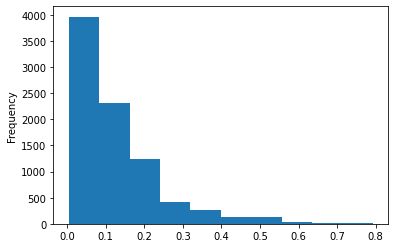

In [175]:
scrublet['Doublet_scores_fragments'].plot.hist()

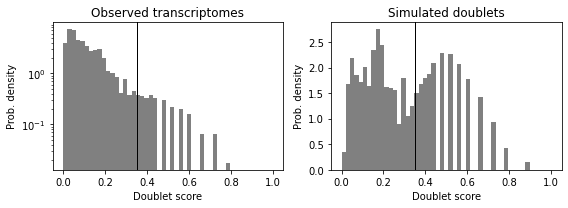

In [176]:
scrub.plot_histogram();

It seelms like 0.35 is a good cutoff.

In [157]:
cistopic_obj.add_cell_data(scrublet)

In [158]:
sum(cistopic_obj.cell_data.Predicted_doublets_fragments == True)

481

We find 481 doublets detected by scrublet. Remove those from the cistopic object.

In [177]:
# Remove doublets 
singlets = cistopic_obj.cell_data[cistopic_obj.cell_data.Predicted_doublets_fragments == False].index.tolist()
# Subset cisTopic object
cistopic_obj_noDBL = cistopic_obj.subset(singlets, copy=True)
print(cistopic_obj_noDBL)

CistopicObject from project cisTopic_merge with n_cells × n_regions = 8021 × 1190863


I like to save an intermediate cistopic object without doublets.

In [178]:
cistopicobjname = 'cistopicobj_merged_from_individual_samples_noDBL.pkl'
cistopicobjpath = cistopic_out + 'cistopicobj/' + cistopicobjname
with open(cistopicobjpath, 'wb') as f:
  pickle.dump(cistopic_obj_noDBL, f)

# Run Models
Calculate models, this step takes time and does not scale well with numbers of cells and regions. Parallel implementations of this step exist, I refer to the pycisTopic github repository. Reopen the cistopic object:

In [181]:
cistopicobjname = 'cistopicobj_merged_from_individual_samples_noDBL.pkl'
cistopicobjpath = cistopic_out + 'cistopicobj/' + cistopicobjname
infile = open(cistopicobjpath, 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

Calculate. `topics` is an array with numbers of topics. The cistopic models will be trained for these numbers of topics. Generally, 50 is about a good number. Models with higher numbers of topics require longer to calculate.

In [183]:
ray.shutdown()
niterations = 400
topics = [2, 5, 10, 15, 20, 25, 30, 35, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 60, 65, 70]
models=run_cgs_models(cistopic_obj,
                    n_topics=topics,
                    n_cpu=len(topics),
                    n_iter=niterations,
                    random_state=555,
                    alpha=50,
                    alpha_by_topic=True,
                    eta=0.1,
                    eta_by_topic=False,
                    save_path=None)

2021-04-10 11:22:10,909	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=15483) 2021-04-10 11:22:44,084 cisTopic     INFO     Running model with 40 topics
(pid=15483) 2021-04-10 11:22:44,084 cisTopic     INFO     Running model with 40 topics
(pid=15483) 2021-04-10 11:22:44,084 cisTopic     INFO     Running model with 40 topics
(pid=15493) 2021-04-10 11:22:44,074 cisTopic     INFO     Running model with 41 topics
(pid=15493) 2021-04-10 11:22:44,074 cisTopic     INFO     Running model with 41 topics
(pid=15493) 2021-04-10 11:22:44,074 cisTopic     INFO     Running model with 41 topics
(pid=15476) 2021-04-10 11:22:44,069 cisTopic     INFO     Running model with 35 topics
(pid=15476) 2021-04-10 11:22:44,069 cisTopic     INFO     Running model with 35 topics
(pid=15476) 2021-04-10 11:22:44,069 cisTopic     INFO     Running model with 35 topics
(pid=15495) 2021-04-10 11:22:44,083 cisTopic     INFO     Running model with 30 topics
(pid=15495) 2021-04-10 11:22:44,083 cisTopic     INFO     Running model with 30 topics
(pid=15495) 2021-04-10 11:22:44,083 cisTopi

In [186]:
Audio(sound_file, autoplay=True)

Then save the models

In [184]:
modelpath = cistopic_out + 'models/'
if not os.path.exists(modelpath):
    os.makedirs(modelpath)

# Save
# modelpath = cistopic_out + 'models/model_merged_from_individual_samples.pkl'
modelpath = cistopic_out + 'models/model_merged_from_individual_samples_'+str(niterations)+'it_noDBL.pkl'
with open(modelpath, 'wb') as f:
  pickle.dump(models, f)

Reopen.

In [185]:
modelpath = cistopic_out + 'models/model_merged_from_individual_samples_'+str(niterations)+'it_noDBL.pkl'
infile = open(modelpath, 'rb')
models = pickle.load(infile)
infile.close()

# Select model
Now, based on these 4 model QC stats, we can pick the most suitable model.

In [193]:
ntopics = 51

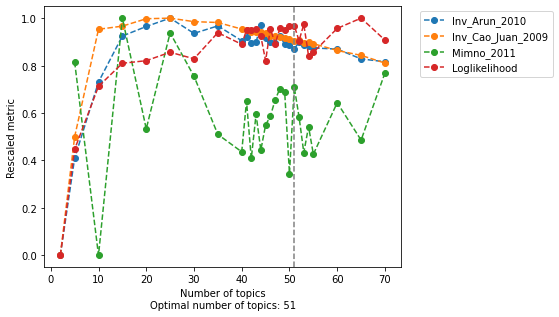

In [194]:
model_selectionpath = cistopic_out + 'models/' + 'model_selection_400it_noDBL.pdf'
model=evaluate_models(models,
                     select_model=ntopics, 
                     return_model=True, 
                     metrics=['Arun_2010','Cao_Juan_2009', 'Minmo_2011', 'loglikelihood'],
                     plot_metrics=False,
                     save=model_selectionpath)

Add the selected model to the cistopic object and save.

In [195]:
cistopic_obj.add_LDA_model(model)

In [196]:
cistopicobjname = 'cistopicobj_merged_from_individual_samples_'+str(niterations)+'it_noDBL.pkl'
cistopicobjpath = cistopic_out + 'cistopicobj/' + cistopicobjname
with open(cistopicobjpath, 'wb') as f:
  pickle.dump(cistopic_obj, f)

# Dimensionality reduction
Load the cistopic object, which also contains the selected models.

In [197]:
cistopicobjname = 'cistopicobj_merged_from_individual_samples_'+str(niterations)+'it_noDBL.pkl'
cistopicobjpath = cistopic_out + 'cistopicobj/' + cistopicobjname
infile = open(cistopicobjpath, 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

Double check the samples.

In [200]:
cistopic_obj.cell_data['sample_id'].unique()

array(['HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2',
       'HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2',
       'HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1',
       'HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3',
       'HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4',
       'HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5',
       'HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3'], dtype=object)

Reload models if necessary


In [16]:
modelpath = cistopic_out + 'models/model_merged_from_individual_samples_'+str(niterations)+'it_noDBL.pkl'
infile = open(modelpath, 'rb')
models = pickle.load(infile)
infile.close()

Perform leiden clustering. Calculate both UMAP and tSNE

In [222]:
nk = 10
nres = 0.9
from pycisTopic.clust_vis import *
find_clusters(cistopic_obj,
                 target  = 'cell',
                 k = nk,
                 res = nres,
                 prefix = 'pycisTopic_'+str(niterations)+'it_')

run_umap(cistopic_obj, target  = 'cell')
run_tsne(cistopic_obj, target  = 'cell')

2021-04-10 15:54:19,912 cisTopic     INFO     Finding neighbours
2021-04-10 15:54:21,525 cisTopic     INFO     Finding clusters
2021-04-10 15:54:21,647 cisTopic     INFO     Running UMAP
2021-04-10 15:54:39,743 cisTopic     INFO     Running TSNE


Plot UMAP colored by Leiden clusters

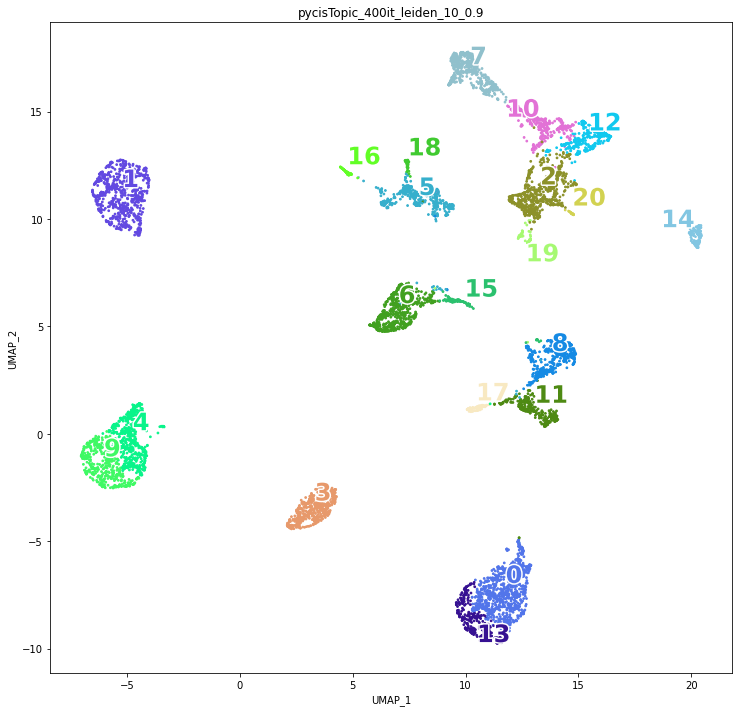

In [223]:
if not os.path.exists(cistopic_out + 'dimreduc/'):
    os.makedirs(cistopic_out + 'dimreduc/')
    
umapdir = cistopic_out + 'dimreduc/UMAP_'+str(niterations)+'it_' + str(ntopics) + 'topics_noDBL.pdf'
plot_metadata(cistopic_obj,
                 reduction_name='UMAP',
                 variables=['pycisTopic_'+str(niterations)+'it_leiden_'+str(nk)+'_'+str(nres)], # Labels from RNA and new clusters
                 target='cell', num_columns=2,
                 text_size=24,
                 dot_size=3,
                 figsize=(20,10),
                 save=umapdir)

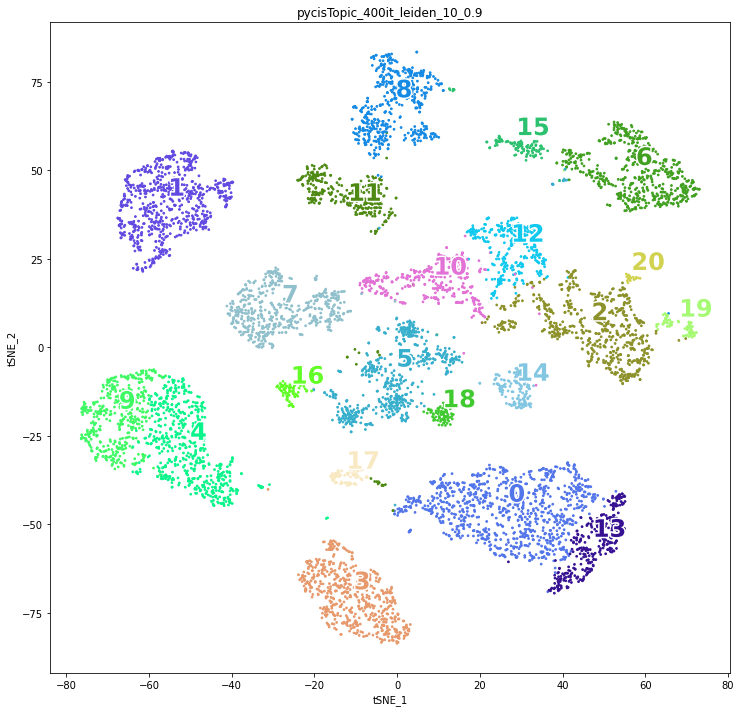

In [224]:
umapdir = cistopic_out + 'dimreduc/tSNE_'+str(niterations)+'it_' + str(ntopics) + 'topics_noDBL.pdf'
plot_metadata(cistopic_obj,
                 reduction_name='tSNE',
                 variables=['pycisTopic_'+str(niterations)+'it_leiden_'+str(nk)+'_'+str(nres)], # Labels from RNA and new clusters
                 target='cell', num_columns=2,
                 text_size=24,
                 dot_size=3,
                 figsize=(20,10),
                 save=umapdir)

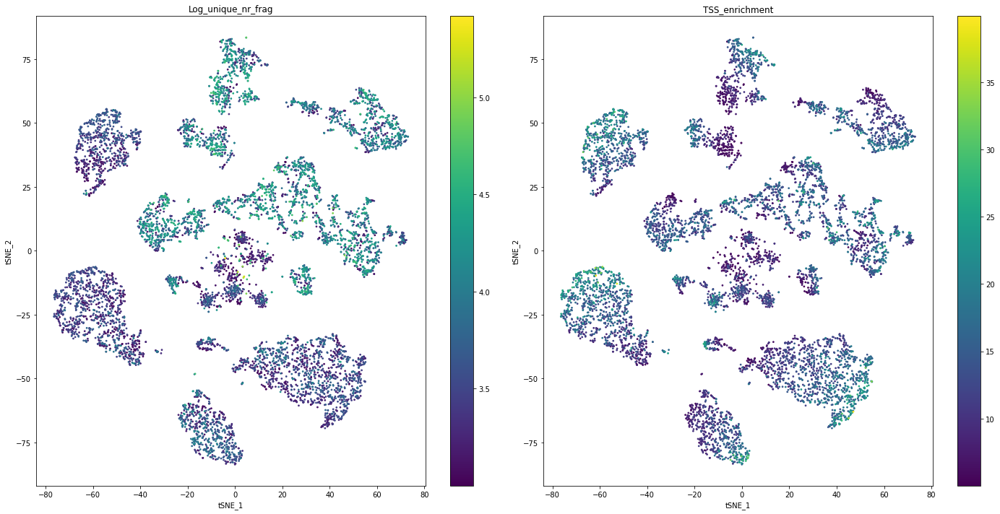

In [225]:
umapdir = cistopic_out + 'dimreduc/tSNE_'+str(niterations)+'it_' + str(ntopics) + 'topics_QC_noDBL.pdf'
plot_metadata(cistopic_obj,
                 reduction_name='tSNE',
                 variables=['Log_unique_nr_frag', 'TSS_enrichment'], 
                 target='cell', num_columns=2,
                 text_size=24,
                 dot_size=3,
                 figsize=(20,10),
                 save=umapdir)

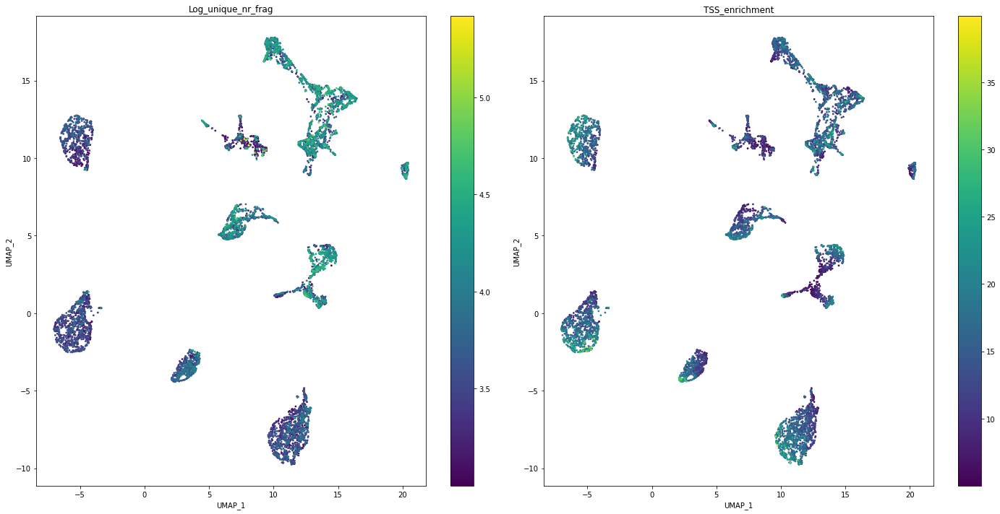

In [226]:
umapdir = cistopic_out + 'dimreduc/UMAP_'+str(niterations)+'it_' + str(ntopics) + 'topics_QC_noDBL.pdf'
plot_metadata(cistopic_obj,
                 reduction_name='UMAP',
                 variables=['Log_unique_nr_frag', 'TSS_enrichment'], 
                 target='cell', num_columns=2,
                 text_size=24,
                 dot_size=3,
                 figsize=(20,10),
                 save=umapdir)

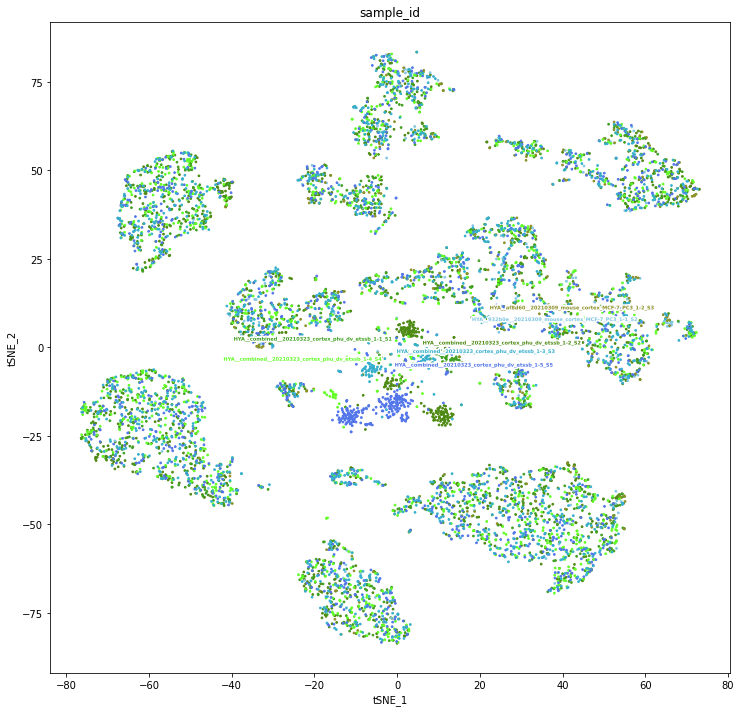

In [227]:
umapdir = cistopic_out + 'dimreduc/tSNE_'+str(niterations)+'it_' + str(ntopics) + 'topics_sampleid_noDBL.pdf'
plot_metadata(cistopic_obj,
                 reduction_name='tSNE',
                 variables=['sample_id'], 
                 target='cell', num_columns=2,
                 text_size=5,
                 dot_size=3,
                 figsize=(20,10),
                 save=umapdir)

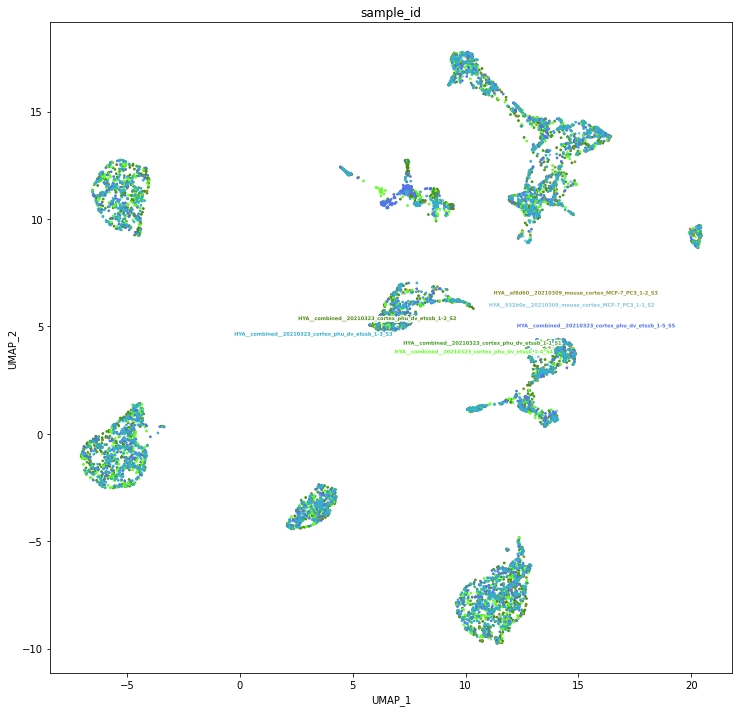

In [228]:
umapdir = cistopic_out + 'dimreduc/UMAP_'+str(niterations)+'it_' + str(ntopics) + 'topics_sampleid_noDBL.pdf'
plot_metadata(cistopic_obj,
                 reduction_name='UMAP',
                 variables=['sample_id'], 
                 target='cell', num_columns=2,
                 text_size=5,
                 dot_size=3,
                 figsize=(20,10),
                 save=umapdir)

In [229]:
with open(cistopicobjpath, 'wb') as f:
  pickle.dump(cistopic_obj, f)

Perform harmony batch correction

In [230]:
niter = niterations
# Harmony
harmony(cistopic_obj, 'sample_id', random_state=555)  
# Clusters
find_clusters(cistopic_obj,
                 target  = 'cell',
                 k = 10,
                 res = 0.9,
                 prefix = 'pycisTopic_harmony_'+str(niter)+'it_',
                 harmony=True)

# UMAP
run_umap(cistopic_obj, reduction_name='harmony_probability_'+str(niter)+'it_UMAP_1',
                 target  = 'cell', harmony=True)
run_umap(cistopic_obj, scale=True, reduction_name='harmony_scaled_'+str(niter)+'it_UMAP_1',
                 target  = 'cell', harmony=True)
#tSNE
run_tsne(cistopic_obj,reduction_name='harmony_probability_'+str(niter)+'it_tSNE_1',
                 target  = 'cell', harmony=True)
run_tsne(cistopic_obj,reduction_name='harmony_scaled_'+str(niter)+'it_tSNE_1',
         target  = 'cell', harmony=True)


2021-04-10 15:56:08,738 - harmonypy - INFO - Iteration 1 of 10


2021-04-10 15:56:08,738 harmonypy    INFO     Iteration 1 of 10


2021-04-10 15:56:10,668 - harmonypy - INFO - Iteration 2 of 10


2021-04-10 15:56:10,668 harmonypy    INFO     Iteration 2 of 10


2021-04-10 15:56:12,007 - harmonypy - INFO - Iteration 3 of 10


2021-04-10 15:56:12,007 harmonypy    INFO     Iteration 3 of 10


2021-04-10 15:56:12,689 - harmonypy - INFO - Iteration 4 of 10


2021-04-10 15:56:12,689 harmonypy    INFO     Iteration 4 of 10


2021-04-10 15:56:13,368 - harmonypy - INFO - Iteration 5 of 10


2021-04-10 15:56:13,368 harmonypy    INFO     Iteration 5 of 10


2021-04-10 15:56:14,045 - harmonypy - INFO - Converged after 5 iterations


2021-04-10 15:56:14,045 harmonypy    INFO     Converged after 5 iterations
2021-04-10 15:56:14,049 cisTopic     INFO     Finding neighbours
2021-04-10 15:56:15,632 cisTopic     INFO     Finding clusters
2021-04-10 15:56:15,748 cisTopic     INFO     Running UMAP
2021-04-10 15:56:35,144 cisTopic     INFO     Running UMAP
2021-04-10 15:56:55,197 cisTopic     INFO     Running TSNE
2021-04-10 15:57:09,138 cisTopic     INFO     Running TSNE


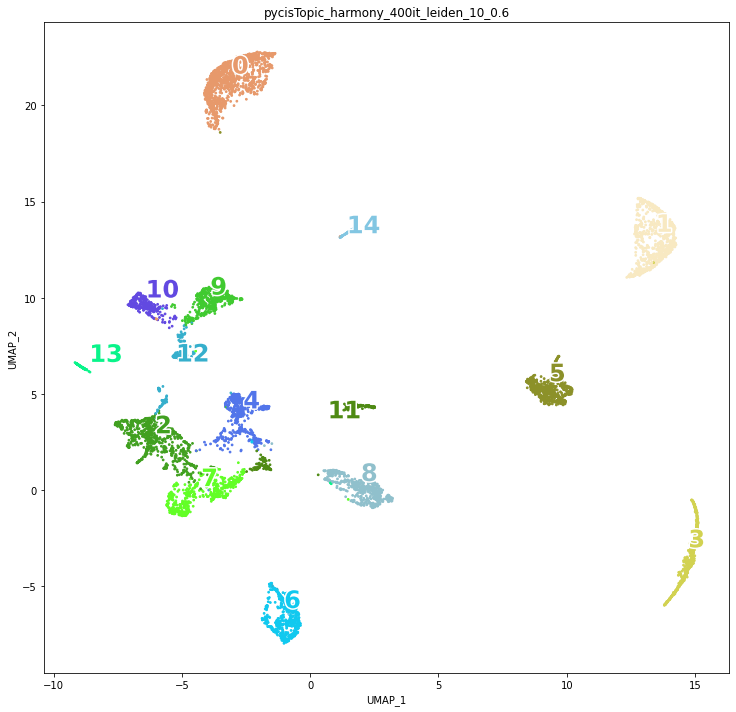

In [214]:
umapdir = cistopic_out + 'dimreduc/harmony_UMAP_'+str(niter)+'it_' + str(ntopics) + 'topics_noDBL.pdf'
plot_metadata(cistopic_obj,
                 reduction_name='harmony_probability_'+str(niter)+'it_UMAP_1',
                 variables=['pycisTopic_harmony_'+str(niter)+'it_leiden_10_'+str(nres)], # Labels from RNA and new clusters
                 target='cell', num_columns=2,
                 text_size=24,
                 dot_size=3,
                 figsize=(20,10),
                 save=umapdir)

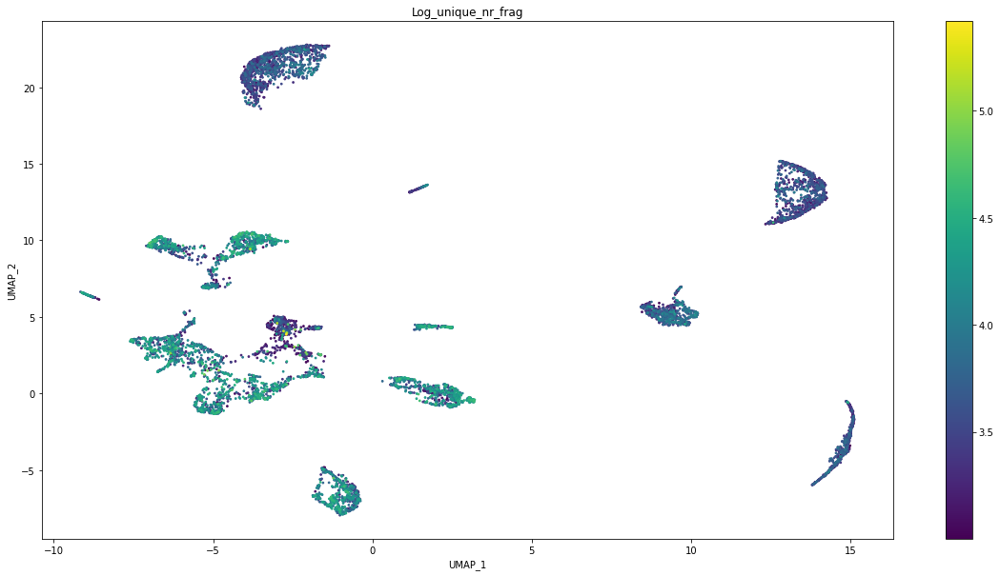

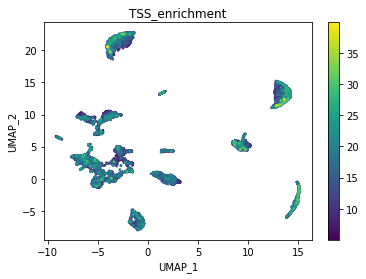

In [232]:
# Plot
umapdir = cistopic_out + 'dimreduc/harmony_UMAP_'+str(niter)+'it_' + str(ntopics) + 'topics_QC_noDBL.pdf'
plot_metadata(cistopic_obj,
                 reduction_name='harmony_probability_'+str(niter)+'it_UMAP_1',
                 variables=['Log_unique_nr_frag', 'TSS_enrichment'], 
                 target='cell', num_columns=1,
                 text_size=24,
                 dot_size=3,
                 figsize=(20,10),
                 save=umapdir)

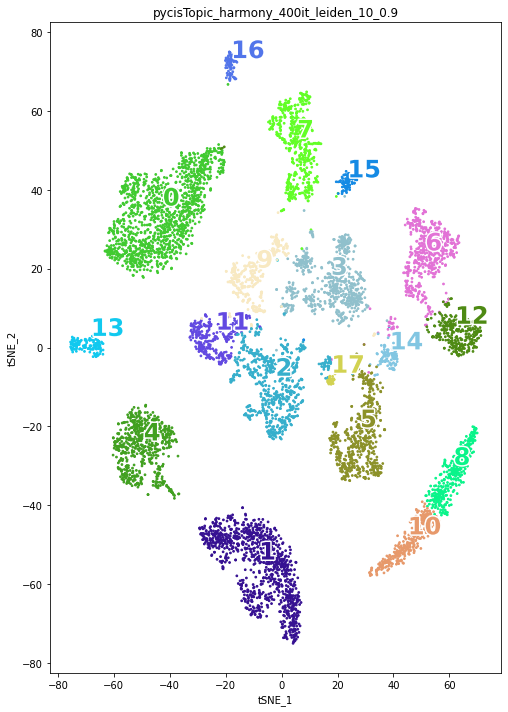

In [233]:
# Plot
umapdir = cistopic_out + 'dimreduc/harmony_tSNE_'+str(niter)+'it_' + str(ntopics) + 'topics_noDBL.pdf'
plot_metadata(cistopic_obj,
                 reduction_name='harmony_probability_'+str(niter)+'it_tSNE_1',
                 variables=['pycisTopic_harmony_'+str(niter)+'it_leiden_10_'+str(nres)], # Labels from RNA and new clusters
                 target='cell', num_columns=3,
                 text_size=24,
                 dot_size=3,
                 figsize=(20,10),
                 save=umapdir)

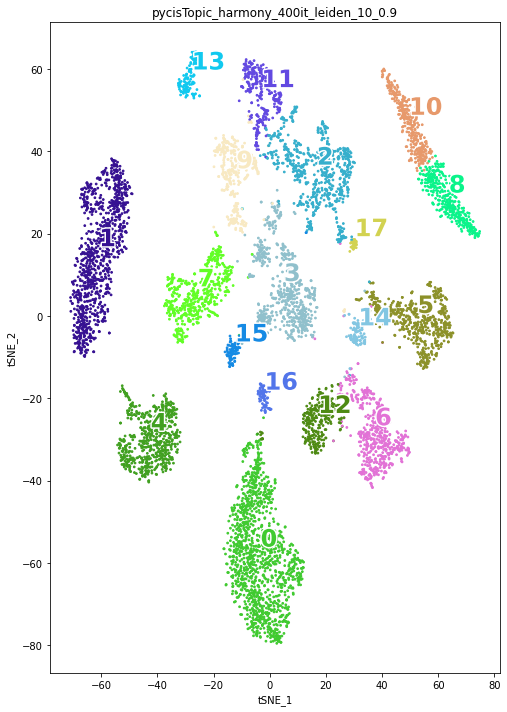

In [234]:
# Plot
umapdir = cistopic_out + 'dimreduc/harmony_scaled_tSNE_'+str(niter)+'it_' + str(ntopics) + 'topics_noDBL.pdf'
plot_metadata(cistopic_obj,
                 reduction_name='harmony_scaled_'+str(niter)+'it_tSNE_1',
                 variables=['pycisTopic_harmony_'+str(niter)+'it_leiden_10_'+str(nres)], # Labels from RNA and new clusters
                 target='cell', num_columns=3,
                 text_size=24,
                 dot_size=3,
                 figsize=(20,10),
                 save=umapdir)

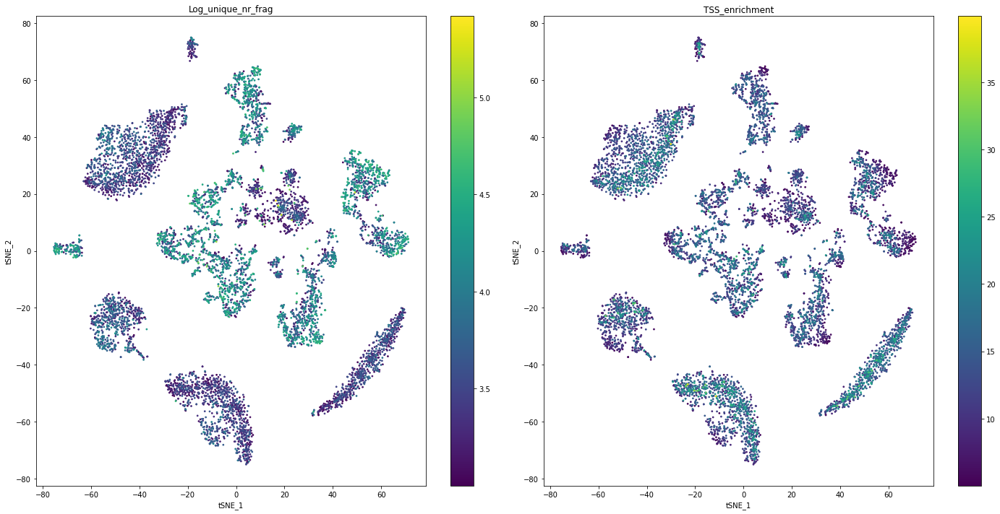

In [239]:
umapdir = cistopic_out + 'dimreduc/harmony_tSNE_'+str(niter)+'it_' + str(ntopics) + 'topics_QC_noDBL.pdf'
plot_metadata(cistopic_obj,
                 reduction_name='harmony_probability_'+str(niter)+'it_tSNE_1',
                 variables=['Log_unique_nr_frag', 'TSS_enrichment'], 
                 target='cell', num_columns=2,
                 text_size=24,
                 dot_size=3,
                 figsize=(20,10),
                 save=umapdir)

In [242]:
cistopicobjname = 'cistopicobj_merged_from_individual_samples_'+str(niter)+'it_noDBL.pkl'
cistopicobjpath = cistopic_out + 'cistopicobj/' + cistopicobjname
with open(cistopicobjpath, 'wb') as f:
  pickle.dump(cistopic_obj, f)

In [241]:
Audio(sound_file, autoplay=True)

Harmony did not improve much for us. We therefore proceeded with the non-batch=corrected data.

# Write cell barcodes
If you want to write cell barcodes to a tsv file

In [26]:
numbers = '1 2 3 4 5 6 7'.split()
for sample in cistopic_obj.cell_data['sample_id'].unique():
    sample_id_number = numbers[sample.index(sample)]
    cistopic_obj.cell_data.loc[(cistopic_obj.cell_data['sample_id'] == sample), 'sample_id_number'] = sample_id_number

In [ ]:
cistopic_obj.cell_data.to_csv('quality_control/cistopic_obj_cell_data.tsv', sep='\t', index=False, header=True)

# Writing per-cluster bigwigs and peak calling

In [243]:
cistopicobjname = 'cistopicobj_merged_from_individual_samples_'+str(niter)+'it_noDBL.pkl'
cistopicobjpath = cistopic_out + 'cistopicobj/' + cistopicobjname
infile = open(cistopicobjpath, 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

In [245]:
cistopic_obj.cell_data['pycisTopic_400it_leiden_10_0.9'].unique()

array(['13', '16', '10', '0', '7', '1', '9', '8', '2', '5', '14', '3',
       '4', '6', '15', '19', '11', '12', '17', '20', '18'], dtype=object)

We need to make a dictionary with samples appearing in this barcode as corresponding to each fragments.tsv.gz. For this, we need a dictionary with sample id and fragments file location

In [247]:
filenames = glob.glob('fragments/*.fragments.NONEGS.tsv.gz')
samples = [item.replace(".sinto.fragments.NONEGS.tsv.gz", "") for item in filenames]
samples = [item.replace("fragments/", "") for item in samples]
fragments_dict = {samples[i]: filenames[i] for i in range(len(samples))}
fragments_dict

{'HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2.sinto.fragments.NONEGS.tsv.gz',
 'HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2': 'fragments/HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1.sinto.fragments.NONEGS.tsv.gz',
 'HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3': 'fragments/HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3': 'fragments/HYA__combined__20210323_cortex_phu_d

We also need chromosome sizes to normalize the bigwigs

In [248]:
# Get chromosome sizes (for mm10 here)
import pyranges as pr
import requests
# for human:
# target_url='http://hgdownload.cse.ucsc.edu/goldenPath/hg38/bigZips/hg38.chrom.sizes'

# for mouse
target_url='https://raw.githubusercontent.com/igvteam/igv/master/genomes/sizes/mm10.chrom.sizes'
chromsizes=pd.read_csv(target_url, sep='\t', header=None)
chromsizes.columns=['Chromosome', 'End']
chromsizes['Start']=[0]*chromsizes.shape[0]
chromsizes=chromsizes.loc[:,['Chromosome', 'Start', 'End']]
chromsizes=pr.PyRanges(chromsizes)

And we use 'pycisTopic_leiden_10_0.6' as clusters

In [249]:
nclusters = len(cistopic_obj.cell_data['pycisTopic_'+str(niter)+'it_leiden_10_0.6'].unique())

You can put nthreads of all the subsequent jobs to nclusters. More is not necessary.

In [250]:
import numexpr
numexpr.set_num_threads(nclusters)
ray.shutdown()

Make sure that the leiden res is correct

In [252]:
import numexpr
numexpr.set_num_threads(36)
ray.shutdown()
bw_paths, bed_paths = export_pseudobulk(input_data = cistopic_obj.cell_data,
                 variable = 'pycisTopic_'+str(niter)+'it_leiden_10_0.9',
                 chromsizes = chromsizes,
                 bed_path = 'pycistopic_consensus/pseudobulk_bed',
                 bigwig_path =  'pycistopic_consensus/pseudobulk_bigwig',
                 path_to_fragments = fragments_dict,
                 n_cpu = nclusters,
                 normalize_bigwig = True,
                 remove_duplicates = True)

2021-04-10 16:01:48,587 cisTopic     INFO     Reading fragments from fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2.sinto.fragments.NONEGS.tsv.gz
2021-04-10 16:02:24,816 cisTopic     INFO     Reading fragments from fragments/HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2.sinto.fragments.NONEGS.tsv.gz
2021-04-10 16:02:28,067 cisTopic     INFO     Reading fragments from fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1.sinto.fragments.NONEGS.tsv.gz
2021-04-10 16:03:01,951 cisTopic     INFO     Reading fragments from fragments/HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3.sinto.fragments.NONEGS.tsv.gz
2021-04-10 16:03:05,464 cisTopic     INFO     Reading fragments from fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4.sinto.fragments.NONEGS.tsv.gz
2021-04-10 16:03:42,966 cisTopic     INFO     Reading fragments from fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5.sinto.fragments.NONEGS.tsv.gz
2021-04-10 16:04:19,154 cisTopic     I

2021-04-10 16:05:04,880	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=31383) 2021-04-10 16:05:24,796 cisTopic     INFO     Creating pseudobulk for 0
(pid=31383) 2021-04-10 16:05:24,796 cisTopic     INFO     Creating pseudobulk for 0
(pid=31383) 2021-04-10 16:05:24,796 cisTopic     INFO     Creating pseudobulk for 0
(pid=31383) 2021-04-10 16:05:24,796 cisTopic     INFO     Creating pseudobulk for 0
(pid=31384) 2021-04-10 16:05:29,799 cisTopic     INFO     Creating pseudobulk for 1
(pid=31384) 2021-04-10 16:05:29,799 cisTopic     INFO     Creating pseudobulk for 1
(pid=31384) 2021-04-10 16:05:29,799 cisTopic     INFO     Creating pseudobulk for 1
(pid=31384) 2021-04-10 16:05:29,799 cisTopic     INFO     Creating pseudobulk for 1
(pid=31383) 2021-04-10 16:05:30,558 numexpr.utils INFO     Note: NumExpr detected 36 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
(pid=31383) 2021-04-10 16:05:30,558 numexpr.utils INFO     Note: NumExpr detected 36 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
(pid=31383) 2021

In [254]:
import pickle 
with open(cistopic_out + '/pseudobulk_bed/bed_paths.pkl', 'wb') as f:
  pickle.dump(bed_paths, f)

In [255]:
import pickle 
with open(cistopic_out + '/pseudobulk_bigwig/bigwig_paths.pkl', 'wb') as f:
  pickle.dump(bw_paths, f)

Get per-cluster peaks. Don't forget to put correct genome size depending on species!

In [256]:
ray.shutdown()
# Set correct path to run MACS2
os.putenv('MACS2_HOME','/ddn1/vol1/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/bin/')

macs_path='/ddn1/vol1/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/bin/macs2'
outdir = 'pycistopic_consensus/consensus_peaks'
# Run peak calling
narrow_peaks_dict = peak_calling(macs_path, bed_paths, outdir, genome_size='mm', n_cpu=24, input_format='BEDPE', shift=73, ext_size=146, keep_dup = 'all', q_value = 0.05)

2021-04-10 16:21:06,986	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=4901) 2021-04-10 16:21:42,279 cisTopic     INFO     Calling peaks for 9 with /ddn1/vol1/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/bin/macs2 callpeak --treatment pycistopic_consesus/pseudobulk_bed/9.bed.gz --name 9  --outdir pycistopic_consensus/consensus_peaks --format BEDPE --gsize mm --qvalue 0.05 --nomodel --shift 73 --extsize 146 --keep-dup all --call-summits --nolambda
(pid=4901) 2021-04-10 16:21:42,279 cisTopic     INFO     Calling peaks for 9 with /ddn1/vol1/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/bin/macs2 callpeak --treatment pycistopic_consesus/pseudobulk_bed/9.bed.gz --name 9  --outdir pycistopic_consensus/consensus_peaks --format BEDPE --gsize mm --qvalue 0.05 --nomodel --shift 73 --extsize 146 --keep-dup all --call-summits --nolambda
(pid=4901) 2021-04-10 16:21:42,279 cisTopic     INFO     Calling peaks for 9 with /ddn1/vol1/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/bin/macs2 callpeak --treatment pycistopic_consesus/pseud

In [257]:
import pickle 
with open(cistopic_out + '/narrow_peaks_dict.pkl', 'wb') as f:
  pickle.dump(narrow_peaks_dict, f)

In [258]:
from pycisTopic.iterative_peak_calling import *
# Other param
peak_half_width=250
path_to_blacklist='/staging/leuven/stg_00002/lcb/cbravo/Multiomics_pipeline/pycisTopic/blacklist/mm10-blacklist.v2.bed'
# Get consensus peaks
consensus_peaks=get_consensus_peaks(narrow_peaks_dict, peak_half_width, chromsizes=chromsizes, path_to_blacklist=path_to_blacklist) 

2021-04-10 16:22:49,981 cisTopic     INFO     Extending and merging peaks per class
2021-04-10 16:24:31,529 cisTopic     INFO     Normalizing peak scores
2021-04-10 16:24:32,012 cisTopic     INFO     Merging peaks
Warning! Start and End columns now have different dtypes: int64 and int32
2021-04-10 16:26:09,387 cisTopic     INFO     Done!


In [259]:
# now write to bed
consensus_peaks.to_bed(path='pycistopic_consensus/consensus_regions.bed', keep=True, compression='infer', chain=False)

# Now repeat clustering with consensus peaks!

In [263]:
filenames = glob.glob('fragments/*.fragments.NONEGS.tsv.gz')
samples = [item.replace(".sinto.fragments.NONEGS.tsv.gz", "") for item in filenames]
samples = [item.replace("fragments/", "") for item in samples]
fragments_dict = {samples[i]: filenames[i] for i in range(len(samples))}
fragments_dict

{'HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2.sinto.fragments.NONEGS.tsv.gz',
 'HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2': 'fragments/HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1.sinto.fragments.NONEGS.tsv.gz',
 'HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3': 'fragments/HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3': 'fragments/HYA__combined__20210323_cortex_phu_d

In [265]:
regions = 'pycistopic_consensus/consensus_regions.bed'
regionslist = [regions] * len(fragments_dict)
path_to_regions = {samples[i]: regionslist[i] for i in range(len(samples))}
path_to_regions

{'HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2': 'pycistopic_consensus/consensus_regions.bed',
 'HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2': 'pycistopic_consensus/consensus_regions.bed',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1': 'pycistopic_consensus/consensus_regions.bed',
 'HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3': 'pycistopic_consensus/consensus_regions.bed',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4': 'pycistopic_consensus/consensus_regions.bed',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5': 'pycistopic_consensus/consensus_regions.bed',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3': 'pycistopic_consensus/consensus_regions.bed'}

In [266]:
ray.shutdown()
metadata_bc_dict, profile_data_dict = compute_qc_stats(fragments_dict = fragments_dict,
                tss_annotation = annot,
                stats=['barcode_rank_plot', 'duplicate_rate', 'insert_size_distribution', 'profile_tss', 'frip'],
                label_list = None,
                path_to_regions = path_to_regions,
                n_cpu = 16,
                valid_bc = None,
                n_frag = 10,
                n_bc = None,
                tss_flank_window = 2000,
                tss_window = 50,
                tss_minimum_signal_window = 100,
                tss_rolling_windoßw = 10,
                # min_norm=0.2,
                remove_duplicates = True)

2021-04-10 16:37:00,670	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=12295) 2021-04-10 16:37:27,883 cisTopic     INFO     Reading HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3
(pid=12295) 2021-04-10 16:37:27,883 cisTopic     INFO     Reading HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3
(pid=12295) 2021-04-10 16:37:27,883 cisTopic     INFO     Reading HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3
(pid=12295) 2021-04-10 16:37:27,883 cisTopic     INFO     Reading HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3
(pid=12295) 2021-04-10 16:37:27,883 cisTopic     INFO     Reading HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3
(pid=12295) 2021-04-10 16:37:27,883 cisTopic     INFO     Reading HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3
(pid=12298) 2021-04-10 16:37:27,882 cisTopic     INFO     Reading HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5
(pid=12298) 2021-04-10 16:37:27,882 cisTopic     INFO     Reading HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5
(pid=12298) 2021-04-10 16:37:27,882 cisTopic     INFO     Readin

(pid=12298) 2021-04-10 16:38:05,556 cisTopic     INFO     Computing barcode rank plot for HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5
(pid=12298) 2021-04-10 16:38:05,556 cisTopic     INFO     Counting fragments
(pid=12298) 2021-04-10 16:38:05,556 cisTopic     INFO     Computing barcode rank plot for HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5
(pid=12298) 2021-04-10 16:38:05,556 cisTopic     INFO     Counting fragments
(pid=12298) 2021-04-10 16:38:05,556 cisTopic     INFO     Computing barcode rank plot for HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5
(pid=12298) 2021-04-10 16:38:05,556 cisTopic     INFO     Counting fragments
(pid=12298) 2021-04-10 16:38:05,556 cisTopic     INFO     Computing barcode rank plot for HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5
(pid=12298) 2021-04-10 16:38:05,556 cisTopic     INFO     Counting fragments
(pid=12298) 2021-04-10 16:38:05,556 cisTopic     INFO     Computing barcode rank plot for HYA__combined__20210323_cortex_phu_dv_

(pid=12305) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=12305)   warnings.warn(msg, FutureWarning)
(pid=12305) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=12305)   warnings.warn(msg, FutureWarning)
(pid=12305) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWar

(pid=12305) 2021-04-10 16:38:34,273 cisTopic     INFO     Sample HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2 done!
(pid=12305) 2021-04-10 16:38:34,273 cisTopic     INFO     Sample HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2 done!
(pid=12305) 2021-04-10 16:38:34,273 cisTopic     INFO     Sample HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2 done!
(pid=12305) 2021-04-10 16:38:34,273 cisTopic     INFO     Sample HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2 done!
(pid=12305) 2021-04-10 16:38:34,273 cisTopic     INFO     Sample HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2 done!
(pid=12305) 2021-04-10 16:38:34,273 cisTopic     INFO     Sample HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2 done!
(pid=12295) 2021-04-10 16:38:34,753 cisTopic     INFO     Marking barcodes with more than 10
(pid=12295) 2021-04-10 16:38:34,759 numexpr.utils INFO     Note: NumExpr detected 36 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
(pid=12295) 2

(pid=12299) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=12299)   warnings.warn(msg, FutureWarning)
(pid=12299) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=12299)   warnings.warn(msg, FutureWarning)
(pid=12299) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWar

(pid=12299) 2021-04-10 16:38:47,479 cisTopic     INFO     Sample HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3 done!
(pid=12299) 2021-04-10 16:38:47,479 cisTopic     INFO     Sample HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3 done!
(pid=12299) 2021-04-10 16:38:47,479 cisTopic     INFO     Sample HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3 done!
(pid=12299) 2021-04-10 16:38:47,479 cisTopic     INFO     Sample HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3 done!
(pid=12299) 2021-04-10 16:38:47,479 cisTopic     INFO     Sample HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3 done!
(pid=12299) 2021-04-10 16:38:47,479 cisTopic     INFO     Sample HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3 done!
(pid=12303) 2021-04-10 17:21:49,651 cisTopic     INFO     Computing insert size distribution for HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1
(pid=12303) 2021-04-10 17:21:49,651 cisTopic     INFO     Using provided valid barcodes
(pid=12303) 2021-04-10 17:

(pid=12303) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=12303)   warnings.warn(msg, FutureWarning)
(pid=12303) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=12303)   warnings.warn(msg, FutureWarning)
(pid=12303) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWar

(pid=12303) 2021-04-10 17:31:40,685 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1 done!
(pid=12303) 2021-04-10 17:31:40,685 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1 done!
(pid=12303) 2021-04-10 17:31:40,685 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1 done!
(pid=12303) 2021-04-10 17:31:40,685 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1 done!
(pid=12303) 2021-04-10 17:31:40,685 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1 done!
(pid=12303) 2021-04-10 17:31:40,685 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1 done!
(pid=12304) 2021-04-10 17:36:06,939 cisTopic     INFO     Returning normalized TSS coverage matrix per barcode
(pid=12304) 2021-04-10 17:36:06,939 cisTopic     INFO     Returning normalized TSS coverage matrix per barcode
(pid=12304) 2021-04-10 17:36:06,939 cisTopic  

(pid=12304) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=12304)   warnings.warn(msg, FutureWarning)
(pid=12304) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=12304)   warnings.warn(msg, FutureWarning)
(pid=12304) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWar

(pid=12304) 2021-04-10 17:39:50,821 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2 done!
(pid=12304) 2021-04-10 17:39:50,821 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2 done!
(pid=12304) 2021-04-10 17:39:50,821 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2 done!
(pid=12304) 2021-04-10 17:39:50,821 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2 done!
(pid=12304) 2021-04-10 17:39:50,821 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2 done!
(pid=12304) 2021-04-10 17:39:50,821 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2 done!
(pid=12293) 2021-04-10 17:44:14,975 cisTopic     INFO     Returning normalized TSS coverage matrix per barcode
(pid=12293) 2021-04-10 17:44:14,975 cisTopic     INFO     Returning normalized TSS coverage matrix per barcode
(pid=12293) 2021-04-10 17:44:14,975 cisTopic  

(pid=12293) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=12293)   warnings.warn(msg, FutureWarning)
(pid=12293) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=12293)   warnings.warn(msg, FutureWarning)
(pid=12293) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWar

(pid=12293) 2021-04-10 17:48:12,418 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4 done!
(pid=12293) 2021-04-10 17:48:12,418 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4 done!
(pid=12293) 2021-04-10 17:48:12,418 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4 done!
(pid=12293) 2021-04-10 17:48:12,418 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4 done!
(pid=12293) 2021-04-10 17:48:12,418 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4 done!
(pid=12293) 2021-04-10 17:48:12,418 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4 done!
(pid=12298) 2021-04-10 17:59:13,587 cisTopic     INFO     Computing insert size distribution for HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5
(pid=12298) 2021-04-10 17:59:13,588 cisTopic     INFO     Using provided valid barcodes
(pid=12298) 2021-04-10 17:59:13,

(pid=12298) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=12298)   warnings.warn(msg, FutureWarning)
(pid=12298) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=12298)   warnings.warn(msg, FutureWarning)
(pid=12298) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWar

(pid=12298) 2021-04-10 18:10:31,638 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5 done!
(pid=12298) 2021-04-10 18:10:31,638 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5 done!
(pid=12298) 2021-04-10 18:10:31,638 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5 done!
(pid=12298) 2021-04-10 18:10:31,638 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5 done!
(pid=12298) 2021-04-10 18:10:31,638 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5 done!
(pid=12298) 2021-04-10 18:10:31,638 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5 done!
(pid=12295) 2021-04-10 18:14:32,489 cisTopic     INFO     Returning normalized TSS coverage matrix per barcode
(pid=12295) 2021-04-10 18:14:32,489 cisTopic     INFO     Returning normalized TSS coverage matrix per barcode
(pid=12295) 2021-04-10 18:14:32,489 cisTopic  

(pid=12295) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=12295)   warnings.warn(msg, FutureWarning)
(pid=12295) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
(pid=12295)   warnings.warn(msg, FutureWarning)
(pid=12295) /staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2557: FutureWar

(pid=12295) 2021-04-10 18:19:22,395 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3 done!
(pid=12295) 2021-04-10 18:19:22,395 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3 done!
(pid=12295) 2021-04-10 18:19:22,395 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3 done!
(pid=12295) 2021-04-10 18:19:22,395 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3 done!
(pid=12295) 2021-04-10 18:19:22,395 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3 done!
(pid=12295) 2021-04-10 18:19:22,395 cisTopic     INFO     Sample HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3 done!


In [ ]:
with open(cistopic_out + 'metadata_bc_consensusregions.pkl', 'wb') as f:
  pickle.dump(metadata_bc_dict, f, protocol=4)

with open(cistopic_out + 'profile_data_dict_conseneusregions.pkl', 'wb') as f:
  pickle.dump(profile_data_dict, f, protocol=4)

In [ ]:
Audio(sound_file, autoplay=True)

In [275]:
# Load metadata
import pickle
infile = open(cistopic_out + '/metadata_bc_consensusregions.pkl', 'rb')
metadata_bc_dict = pickle.load(infile)
infile.close()

In [276]:
# Load profile data
import pickle
infile = open(cistopic_out + '/profile_data_dict_consensusregions.pkl', 'rb')
profile_data_dict = pickle.load(infile)
infile.close()

In [277]:
from fastkde import fastKDE

In [278]:
from pycisTopic.qc import plot_sample_metrics
from scipy.stats import gaussian_kde
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

%matplotlib inline

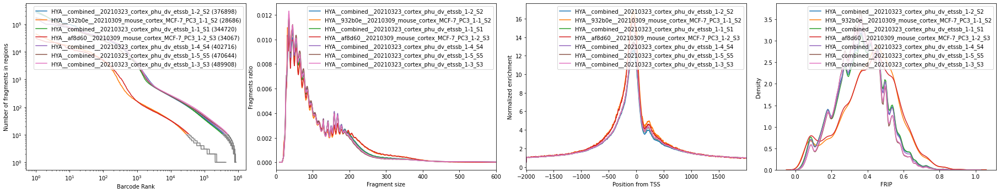

In [279]:
plot_sample_metrics(
           profile_data_dict,
           profile_list=['barcode_rank_plot', 'insert_size_distribution', 'profile_tss', 'frip'],
           insert_size_distriubtion_xlim=[0,600],
           #legend_outside=True,
           ncol=4,
           cmap='Paired',
           plot=True,
           save=cistopic_out + 'sample_metrics.pdf')

In [280]:
def plot_frag_qc(x, y, 
                 ax,
                 x_thr_min=None, x_thr_max=None,
                 y_thr_min=None, y_thr_max=None,
                 ylab=None,
                 xlab="Number of (unique) fragments",
                 cmap='viridis',
                 density_overlay=False,
                 s=10,
                 marker='+',
                 c='#343434',
                 xlim=None,
                 ylim=None,
                 **kwargs
                ):
    assert all(x.index == y.index)
    barcodes = x.index.values
    if density_overlay:
        pdf,axes = fastKDE.pdf(x.to_numpy(),y.to_numpy())
        xy = np.vstack([np.log(x),y])
        z = gaussian_kde(xy)(xy)
        idx = z.argsort()
        x, y, z, barcodes = x[idx], y[idx], z[idx], barcodes[idx]
    else:
        z=c
    barcodes_to_keep=[]
    sp=ax.scatter(x, y, c=z, s=s, edgecolors=None, marker=marker, cmap=cmap, **kwargs)
    #fig.colorbar(sp)
    if ylim is not None:
        ax.set_ylim(ylim[0], ylim[1])
    if xlim is not None:
        ax.set_xlim(xlim[0], xlim[1])
    # thresholds:
    if x_thr_min is not None:    
        ax.axvline(x=x_thr_min, color='r', linestyle='--')
        barcodes_to_keep.append(barcodes[x>x_thr_min])
    if x_thr_max is not None:    
        ax.axvline(x=x_thr_max, color='r', linestyle='--')
        barcodes_to_keep.append(barcodes[x<x_thr_max])
    if y_thr_min is not None:    
        ax.axhline(y=y_thr_min, color='r', linestyle='--')
        barcodes_to_keep.append(barcodes[y>y_thr_min])
    if y_thr_max is not None:    
        ax.axhline(y=y_thr_max, color='r', linestyle='--')
        barcodes_to_keep.append(barcodes[y<y_thr_max])
    ax.set_xscale("log")
    ax.set_xmargin(0.01)
    ax.set_ymargin(0.01)
    ax.set_xlabel(xlab,fontsize=10)
    ax.set_ylabel(ylab,fontsize=10)
    #ax.colorbar().set_label('Density')
    #return barcodes_to_keep
    if len(barcodes_to_keep)>0:
        return list(set.intersection(*map(set, barcodes_to_keep)))
    else:
        return barcodes


In [281]:
# define cell filters:
# screen regions:
# second number is min frags
frags_lower = [1000, 1000, 1000, 1000, 1000, 1000, 1000]
tss_lower = [5, 5, 5, 5, 5, 5, 5]
filter_frags_lower = {samples[i]: frags_lower[i] for i in range(len(samples))}
filter_tss_lower = {samples[i]: tss_lower[i] for i in range(len(samples))}

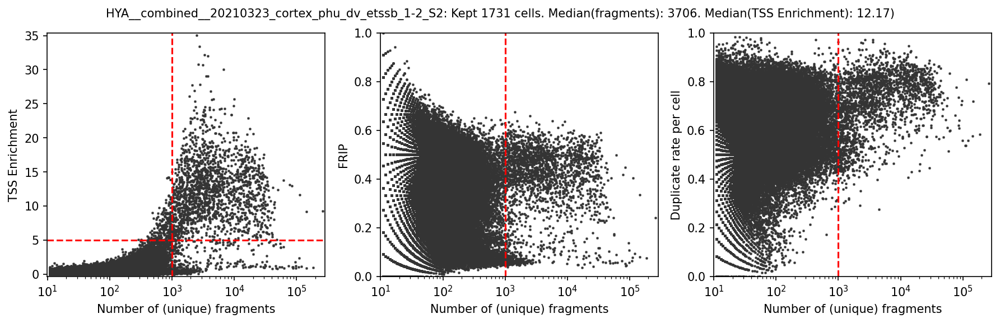

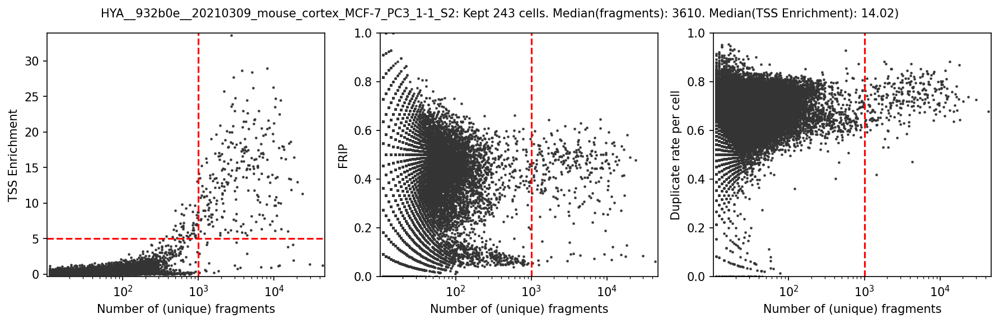

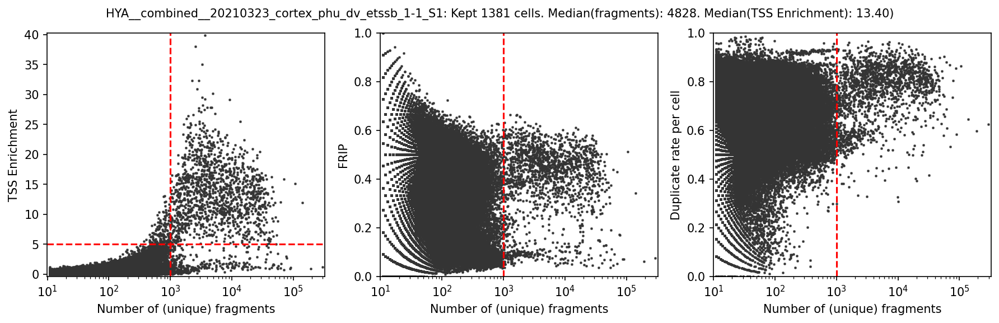

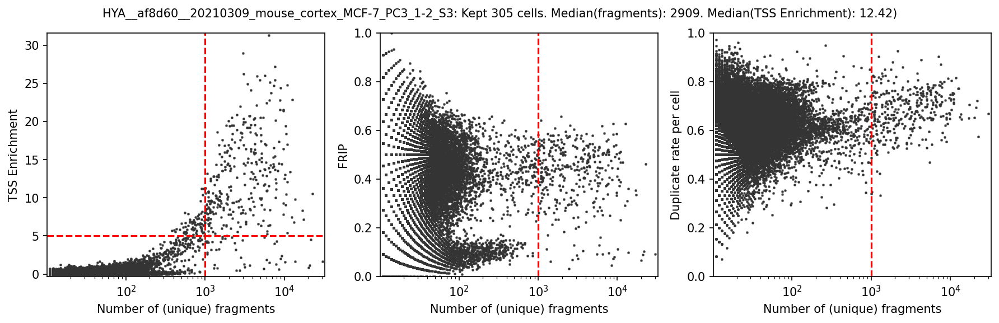

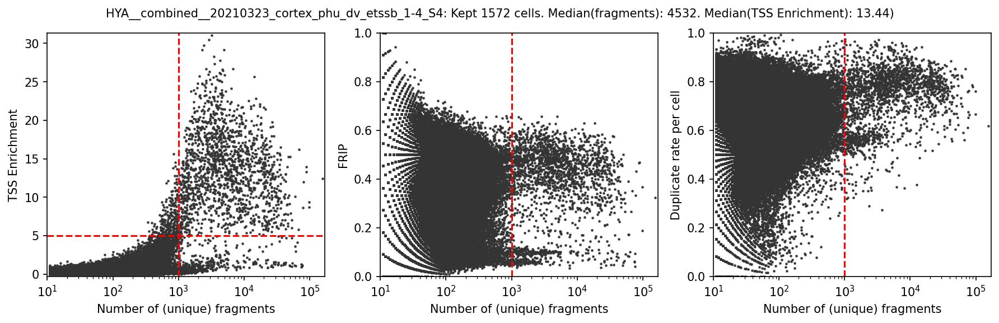

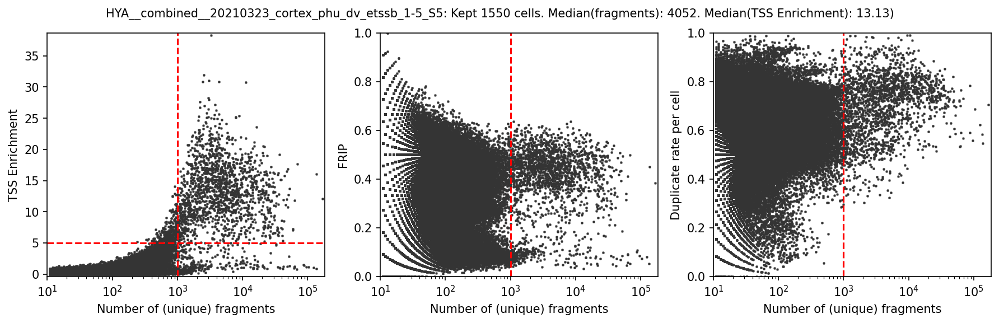

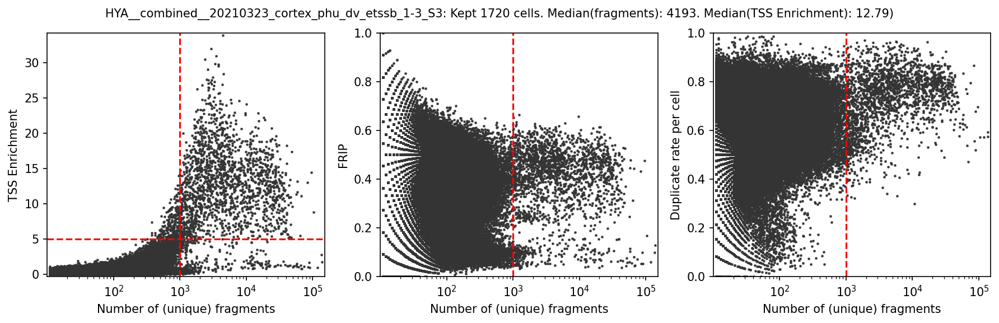

In [282]:
include_kde = False # set to False for faster draft-quality plots
detailed_title=True
s=4
bc_passing_filters = {}
for k,v in metadata_bc_dict.items():
    fig, (ax1,ax2,ax3) = plt.subplots(1,3, figsize=(12,4), dpi=150 )
    p1_cells = plot_frag_qc(
        x = metadata_bc_dict[k]['Unique_nr_frag'],
        y = metadata_bc_dict[k]['TSS_enrichment'],
        ylab = 'TSS Enrichment',
        s=s,
        x_thr_min=filter_frags_lower[k],
        y_thr_min=filter_tss_lower[k],
        density_overlay=include_kde,
        ax=ax1
    )
    p2_cells = plot_frag_qc(
        x = metadata_bc_dict[k]['Unique_nr_frag'],
        y = metadata_bc_dict[k]['FRIP'],
        x_thr_min=filter_frags_lower[k],
        ylab = 'FRIP',
        s=s,
        ylim=[0,1],
        density_overlay=include_kde,
        ax=ax2
    )
    p3_cells = plot_frag_qc(
        x = metadata_bc_dict[k]['Unique_nr_frag'],
        y = metadata_bc_dict[k]['Dupl_rate'],
        x_thr_min=filter_frags_lower[k],
        ylab = 'Duplicate rate per cell',
        s=s,
        ylim=[0,1],
        density_overlay=include_kde,
        ax=ax3
    )
    bc_passing_filters[k] = list(set(p1_cells) & set(p2_cells) & set(p3_cells))
    if detailed_title:
        med_nf = metadata_bc_dict[k].loc[bc_passing_filters[k],'Unique_nr_frag'].median()
        med_tss = metadata_bc_dict[k].loc[bc_passing_filters[k],'TSS_enrichment'].median()
        title = f"{k}: Kept {len(bc_passing_filters[k])} cells. Median(fragments): {med_nf:.0f}. Median(TSS Enrichment): {med_tss:.2f})"
    else:
        title = k
    fig.suptitle(title, x=0.5, y=0.95, fontsize=10)
    plt.tight_layout()
    plt.savefig(cistopic_out + k + "_consensus.png", bbox_inches = "tight", transparent=False, facecolor='w', edgecolor='w', dpi=150)

In [283]:
with open(cistopic_out + 'bc_passing_filters_consensusregions.pkl', 'wb') as f:
  pickle.dump(bc_passing_filters, f)

In [284]:
Audio(sound_file, autoplay=True)

## create merged figure 

In [ ]:
metadata_bc_dict_merged = pd.concat(metadata_bc_dict.values(), ignore_index=True)

In [ ]:
k, v = metadata_bc_dict_merged.items()

In [ ]:
include_kde = True # set to False for faster draft-quality plots
detailed_title=True
s=2
bc_passing_filters = {}
filter_frags_lower = 1000
filter_tss_lower = 5
fig, (ax1,ax2,ax3) = plt.subplots(1,3, figsize=(12,4), dpi=150 )
p1_cells = plot_frag_qc(
	x = metadata_bc_dict_merged['Unique_nr_frag'],
	y = metadata_bc_dict_merged['TSS_enrichment'],
	ylab = 'TSS Enrichment',
	s=s,
	x_thr_min=filter_frags_lower,
	y_thr_min=filter_tss_lower,
	density_overlay=include_kde,
	ax=ax1
)
p2_cells = plot_frag_qc(
	x = metadata_bc_dict_merged['Unique_nr_frag'],
	y = metadata_bc_dict_merged['FRIP'],
	x_thr_min=filter_frags_lower,
	ylab = 'FRIP',
	s=s,
	ylim=[0,1],
	density_overlay=include_kde,
	ax=ax2
)
p3_cells = plot_frag_qc(
	x = metadata_bc_dict_merged['Unique_nr_frag'],
	y = metadata_bc_dict_merged['Dupl_rate'],
	x_thr_min=filter_frags_lower,
	ylab = 'Duplicate rate per cell',
	s=s,
	ylim=[0,1],
	density_overlay=include_kde,
	ax=ax3
)
bc_passing_filters = list(set(p1_cells) & set(p2_cells) & set(p3_cells))
if detailed_title:
	med_nf = metadata_bc_dict_merged.loc[bc_passing_filters,'Unique_nr_frag'].median()
	med_tss = metadata_bc_dict_merged.loc[bc_passing_filters,'TSS_enrichment'].median()
	title = f"{k}: Kept {len(bc_passing_filters)} cells. Median(fragments): {med_nf:.0f}. Median(TSS Enrichment): {med_tss:.2f})"
else:
	title = 'merged'
fig.suptitle(title, x=0.5, y=0.95, fontsize=10)
plt.tight_layout()
plt.savefig(cistopic_out + 'merged' + "_nokde_consensus.png", bbox_inches = "tight", transparent=False, facecolor='w', edgecolor='w', dpi=150)

In [ ]:
Audio(sound_file, autoplay=True)

In [293]:
# Metrics
infile = open(cistopic_out + '/metadata_bc_consensusregions.pkl', 'rb')
metadata_bc = pickle.load(infile)
infile.close()
# Valid barcodes
infile = open(cistopic_out + 'bc_passing_filters_consensusregions.pkl', 'rb')
bc_passing_filters = pickle.load(infile)
infile.close()

In [294]:
from pycisTopic.cistopic_class import create_cistopic_object_from_fragments

In [295]:
path_to_blacklist = '/ddn1/vol1/staging/leuven/stg_00002/lcb/cbravo/Multiomics_pipeline/pycisTopic/blacklist/mm10-blacklist.v2.bed'
# path_to_blacklist = '/ddn1/vol1/staging/leuven/stg_00002/lcb/cbravo/Multiomics_pipeline/pycisTopic/blacklist/hg38-blacklist.v2.bed'

In [298]:
path_to_regions.keys() == metadata_bc_dict.keys() == fragments_dict.keys() == bc_passing_filters.keys()

True

In [299]:
#Create all objects
cistopic_obj_list=[create_cistopic_object_from_fragments(path_to_fragments=fragments_dict[key],
                                               path_to_regions=path_to_regions[key],
                                               path_to_blacklist=path_to_blacklist,
                                               metrics=metadata_bc_dict[key],
                                               valid_bc=bc_passing_filters[key],
                                               n_cpu=16,
                                               project=key) for key in fragments_dict.keys()]

2021-04-10 18:35:03,846 cisTopic     INFO     Reading data for HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2
2021-04-10 18:35:47,594 cisTopic     INFO     metrics provided!
2021-04-10 18:35:56,988 cisTopic     INFO     valid_bc provided, selecting barcodes!
2021-04-10 18:36:00,063 cisTopic     INFO     Counting fragments in regions


2021-04-10 18:36:06,089	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


2021-04-10 18:36:17,436 cisTopic     INFO     Creating fragment matrix
2021-04-10 18:36:34,918 cisTopic     INFO     Converting fragment matrix to sparse matrix
2021-04-10 18:36:39,653 cisTopic     INFO     Removing blacklisted regions
2021-04-10 18:36:41,522 cisTopic     INFO     Creating CistopicObject
2021-04-10 18:36:42,281 cisTopic     INFO     Done!
2021-04-10 18:36:42,705 cisTopic     INFO     Reading data for HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2
2021-04-10 18:36:47,190 cisTopic     INFO     metrics provided!
2021-04-10 18:36:47,695 cisTopic     INFO     valid_bc provided, selecting barcodes!
2021-04-10 18:36:47,951 cisTopic     INFO     Counting fragments in regions


2021-04-10 18:36:53,729	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


2021-04-10 18:37:02,227 cisTopic     INFO     Creating fragment matrix
2021-04-10 18:37:03,569 cisTopic     INFO     Converting fragment matrix to sparse matrix
2021-04-10 18:37:03,970 cisTopic     INFO     Removing blacklisted regions
2021-04-10 18:37:04,635 cisTopic     INFO     Creating CistopicObject
2021-04-10 18:37:04,979 cisTopic     INFO     Done!
2021-04-10 18:37:05,010 cisTopic     INFO     Reading data for HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1
2021-04-10 18:37:45,297 cisTopic     INFO     metrics provided!
2021-04-10 18:37:53,475 cisTopic     INFO     valid_bc provided, selecting barcodes!
2021-04-10 18:37:56,674 cisTopic     INFO     Counting fragments in regions


2021-04-10 18:38:02,586	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


2021-04-10 18:38:12,640 cisTopic     INFO     Creating fragment matrix
2021-04-10 18:38:26,975 cisTopic     INFO     Converting fragment matrix to sparse matrix
2021-04-10 18:38:31,756 cisTopic     INFO     Removing blacklisted regions
2021-04-10 18:38:32,858 cisTopic     INFO     Creating CistopicObject
2021-04-10 18:38:33,587 cisTopic     INFO     Done!
2021-04-10 18:38:33,976 cisTopic     INFO     Reading data for HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3
2021-04-10 18:38:38,909 cisTopic     INFO     metrics provided!
2021-04-10 18:38:39,479 cisTopic     INFO     valid_bc provided, selecting barcodes!
2021-04-10 18:38:39,770 cisTopic     INFO     Counting fragments in regions


2021-04-10 18:38:45,681	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


2021-04-10 18:38:54,677 cisTopic     INFO     Creating fragment matrix
2021-04-10 18:38:56,250 cisTopic     INFO     Converting fragment matrix to sparse matrix
2021-04-10 18:38:56,696 cisTopic     INFO     Removing blacklisted regions
2021-04-10 18:38:57,382 cisTopic     INFO     Creating CistopicObject
2021-04-10 18:38:57,743 cisTopic     INFO     Done!
2021-04-10 18:38:57,777 cisTopic     INFO     Reading data for HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4
2021-04-10 18:39:41,262 cisTopic     INFO     metrics provided!
2021-04-10 18:39:51,504 cisTopic     INFO     valid_bc provided, selecting barcodes!
2021-04-10 18:39:55,773 cisTopic     INFO     Counting fragments in regions


2021-04-10 18:40:02,059	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


2021-04-10 18:40:13,690 cisTopic     INFO     Creating fragment matrix
2021-04-10 18:40:29,484 cisTopic     INFO     Converting fragment matrix to sparse matrix
2021-04-10 18:40:34,993 cisTopic     INFO     Removing blacklisted regions
2021-04-10 18:40:36,068 cisTopic     INFO     Creating CistopicObject
2021-04-10 18:40:36,794 cisTopic     INFO     Done!
2021-04-10 18:40:37,230 cisTopic     INFO     Reading data for HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5
2021-04-10 18:41:21,903 cisTopic     INFO     metrics provided!
2021-04-10 18:41:31,747 cisTopic     INFO     valid_bc provided, selecting barcodes!
2021-04-10 18:41:36,107 cisTopic     INFO     Counting fragments in regions


2021-04-10 18:41:42,516	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


2021-04-10 18:41:52,462 cisTopic     INFO     Creating fragment matrix
2021-04-10 18:42:07,523 cisTopic     INFO     Converting fragment matrix to sparse matrix
2021-04-10 18:42:13,000 cisTopic     INFO     Removing blacklisted regions
2021-04-10 18:42:14,148 cisTopic     INFO     Creating CistopicObject
2021-04-10 18:42:14,866 cisTopic     INFO     Done!
2021-04-10 18:42:15,346 cisTopic     INFO     Reading data for HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3
2021-04-10 18:43:05,480 cisTopic     INFO     metrics provided!
2021-04-10 18:43:15,691 cisTopic     INFO     valid_bc provided, selecting barcodes!
2021-04-10 18:43:18,951 cisTopic     INFO     Counting fragments in regions


2021-04-10 18:43:25,700	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


2021-04-10 18:43:37,541 cisTopic     INFO     Creating fragment matrix
2021-04-10 18:43:55,795 cisTopic     INFO     Converting fragment matrix to sparse matrix
2021-04-10 18:44:01,943 cisTopic     INFO     Removing blacklisted regions
2021-04-10 18:44:03,952 cisTopic     INFO     Creating CistopicObject
2021-04-10 18:44:04,750 cisTopic     INFO     Done!


In [300]:
cistopic_obj = merge(cistopic_obj_list)

2021-04-10 18:44:07,161 cisTopic     INFO     cisTopic object 1 merged
2021-04-10 18:44:09,630 cisTopic     INFO     cisTopic object 2 merged
2021-04-10 18:44:12,160 cisTopic     INFO     cisTopic object 3 merged
2021-04-10 18:44:14,901 cisTopic     INFO     cisTopic object 4 merged
2021-04-10 18:44:17,686 cisTopic     INFO     cisTopic object 5 merged
2021-04-10 18:44:20,772 cisTopic     INFO     cisTopic object 6 merged


In [301]:
cistopicobjname = 'cistopicobj_merged_from_individual_samples_400it_consensusregions.pkl'
cistopicobjpath = cistopic_out + 'cistopicobj/' + cistopicobjname
with open(cistopicobjpath, 'wb') as f:
  pickle.dump(cistopic_obj, f)

# Scrublet

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.31
Detected doublet rate = 7.1%
Estimated detectable doublet fraction = 53.0%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 13.4%
Elapsed time: 55.6 seconds
Detected doublet rate = 6.0%
Estimated detectable doublet fraction = 48.5%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 12.3%


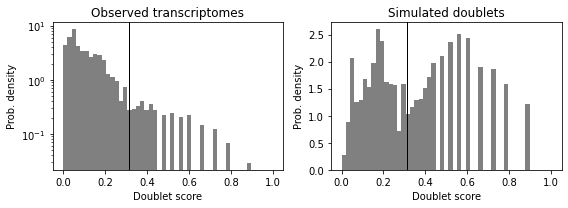

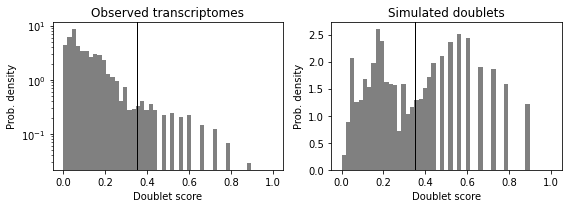

In [302]:
import scrublet as scr
scrub = scr.Scrublet(cistopic_obj.fragment_matrix.T, expected_doublet_rate=0.1)
doublet_scores, predicted_doublets = scrub.scrub_doublets()
scrub.plot_histogram();
scrub.call_doublets(threshold=0.35)
scrub.plot_histogram();
scrublet = pd.DataFrame([scrub.doublet_scores_obs_, scrub.predicted_doublets_], columns=cistopic_obj.cell_names, index=['Doublet_scores_fragments', 'Predicted_doublets_fragments']).T

In [303]:
cistopic_obj.add_cell_data(scrublet)

In [304]:
sum(cistopic_obj.cell_data.Predicted_doublets_fragments == True)

506

In [305]:
# Remove doublets 
singlets = cistopic_obj.cell_data[cistopic_obj.cell_data.Predicted_doublets_fragments == False].index.tolist()
# Subset cisTopic object
cistopic_obj_noDBL = cistopic_obj.subset(singlets, copy=True)
print(cistopic_obj_noDBL)

CistopicObject from project cisTopic_merge with n_cells × n_regions = 7996 × 326824


In [306]:
cistopicobjname = 'cistopicobj_merged_from_individual_samples_400it_consensusregions_noDBL.pkl'
cistopicobjpath = cistopic_out + 'cistopicobj/' + cistopicobjname
with open(cistopicobjpath, 'wb') as f:
  pickle.dump(cistopic_obj_noDBL, f)

# Run Models

In [307]:
cistopicobjname = 'cistopicobj_merged_from_individual_samples_400it_consensusregions_noDBL.pkl'
cistopicobjpath = cistopic_out + 'cistopicobj/' + cistopicobjname
infile = open(cistopicobjpath, 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

In [ ]:
ray.shutdown()
niterations = 400
topics = [2, 5, 10, 15, 20, 25, 30, 35, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 60, 65, 70]
models=run_cgs_models(cistopic_obj,
                    n_topics=topics,
                    n_cpu=len(topics),
                    n_iter=niterations,
                    random_state=555,
                    alpha=50,
                    alpha_by_topic=True,
                    eta=0.1,
                    eta_by_topic=False,
                    save_path=None)

In [309]:
modelpath = cistopic_out + 'models/'
if not os.path.exists(modelpath):
    os.makedirs(modelpath)

# Save
# modelpath = cistopic_out + 'models/model_merged_from_individual_samples.pkl'
modelpath = cistopic_out + 'models/model_merged_from_individual_samples_consensusregions_noDBL.pkl'
with open(modelpath, 'wb') as f:
  pickle.dump(models, f)

In [310]:
Audio(sound_file, autoplay=True)

# select models

In [311]:
modelpath = cistopic_out + 'models/model_merged_from_individual_samples_consensusregions_noDBL.pkl'
infile = open(modelpath, 'rb')
models = pickle.load(infile)
infile.close()

In [316]:
ntopics = 50

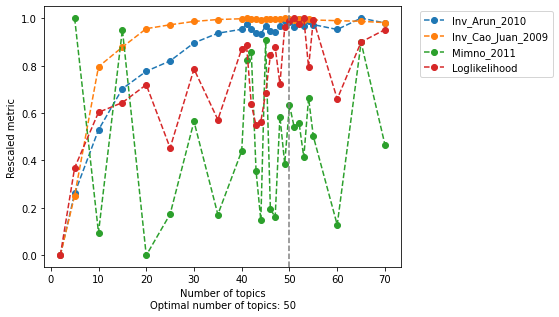

In [317]:
modelpath = cistopic_out + 'models/model_merged_from_individual_samples_consensusregions_noDBL.pkl'
model=evaluate_models(models,
                     select_model=ntopics, 
                     return_model=True, 
                     metrics=['Arun_2010','Cao_Juan_2009', 'Minmo_2011', 'loglikelihood'],
                     plot_metrics=False,
                     save=model_selectionpath)

In [318]:
cistopic_obj.add_LDA_model(model)

In [320]:
cistopicobjname = 'cistopicobj_merged_from_individual_samples_400it_consensusregions_noDBL.pkl'
cistopicobjpath = cistopic_out + 'cistopicobj/' + cistopicobjname
with open(cistopicobjpath, 'wb') as f:
  pickle.dump(cistopic_obj, f)

# Annotation

In [28]:
# Load cisTopic object
import pickle
cistopicobjname = 'cistopicobj_merged_from_individual_samples_400it_consensusregions_noDBL.pkl'
cistopicobjpath = cistopic_out + 'cistopicobj/' + cistopicobjname

infile = open(cistopicobjpath, 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

### Dimensionality reduction

In [31]:
from pycisTopic.clust_vis import *

In [33]:
nk = 10
nres = 0.6
from pycisTopic.clust_vis import *
find_clusters(cistopic_obj,
                 target  = 'cell',
                 k = nk,
                 res = nres,
                 prefix = 'pycisTopic_'+str(niterations)+'it_')

nres = 0.9
from pycisTopic.clust_vis import *
find_clusters(cistopic_obj,
                 target  = 'cell',
                 k = nk,
                 res = nres,
                 prefix = 'pycisTopic_'+str(niterations)+'it_')

nres = 1.2
from pycisTopic.clust_vis import *
find_clusters(cistopic_obj,
                 target  = 'cell',
                 k = nk,
                 res = nres,
                 prefix = 'pycisTopic_'+str(niterations)+'it_')

run_umap(cistopic_obj, target  = 'cell')
run_tsne(cistopic_obj, target  = 'cell')

2021-06-02 01:01:31,330 cisTopic     INFO     Finding neighbours
2021-06-02 01:01:32,928 cisTopic     INFO     Finding clusters
2021-06-02 01:01:33,038 cisTopic     INFO     Running UMAP
2021-06-02 01:02:08,995 cisTopic     INFO     Running TSNE


/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:465: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)


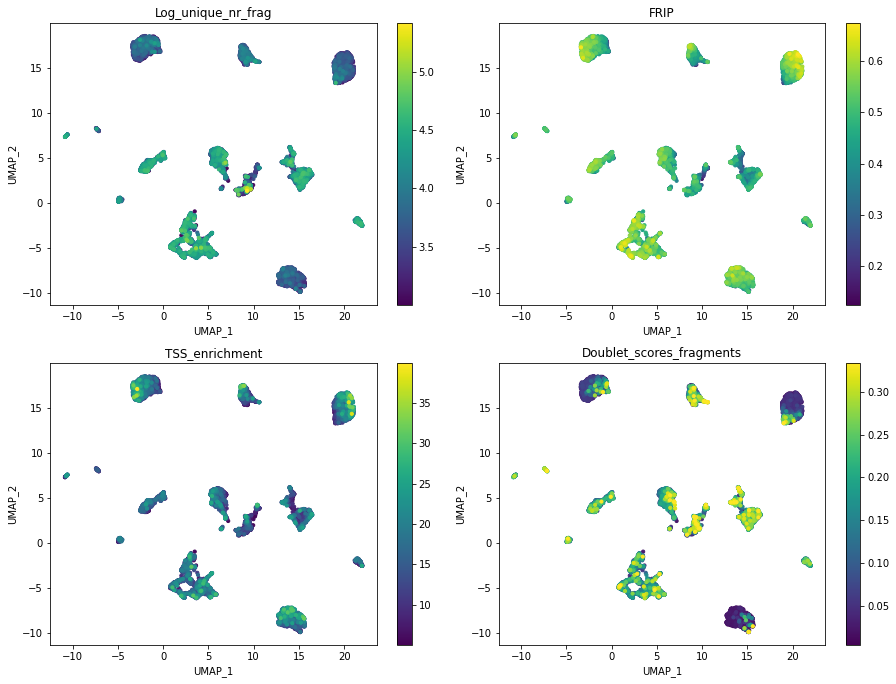

In [34]:
plot_metadata(cistopic_obj,
                 reduction_name='UMAP',
                 variables=['Log_unique_nr_frag', 'FRIP', 'TSS_enrichment', 'Doublet_scores_fragments'], # Labels from RNA and new clusters
                 target='cell', num_columns=2)

/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:413: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)


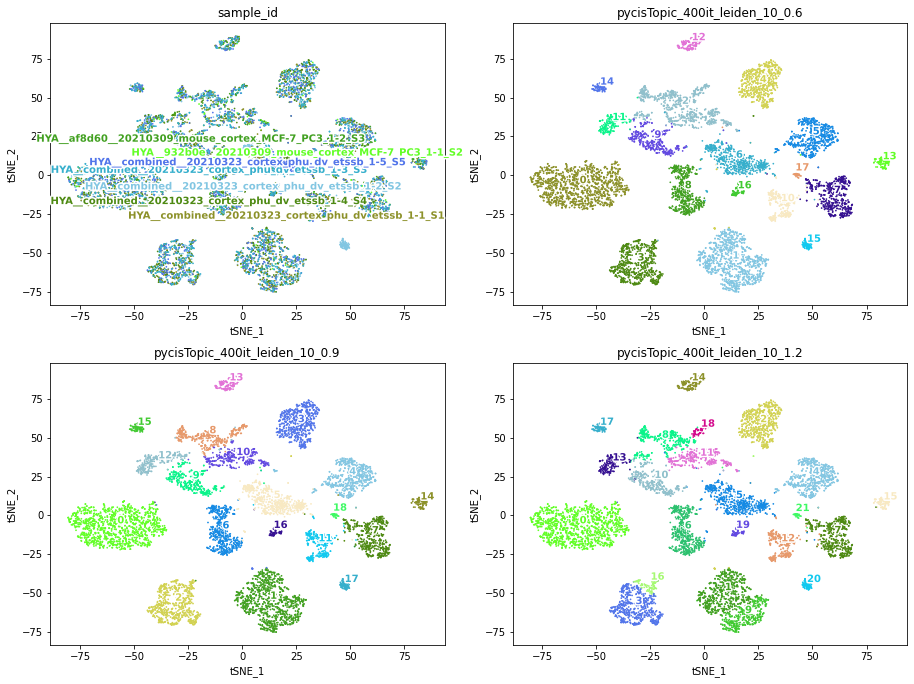

In [46]:
plot_metadata(cistopic_obj,
                 reduction_name='tSNE',
                 variables=['sample_id', 'pycisTopic_'+str(niterations)+'it_leiden_10_0.6', 'pycisTopic_'+str(niterations)+'it_leiden_10_0.9', 'pycisTopic_'+str(niterations)+'it_leiden_10_1.2'], # Labels from RNA and new clusters
                 target='cell', num_columns=2, dot_size=0.5)

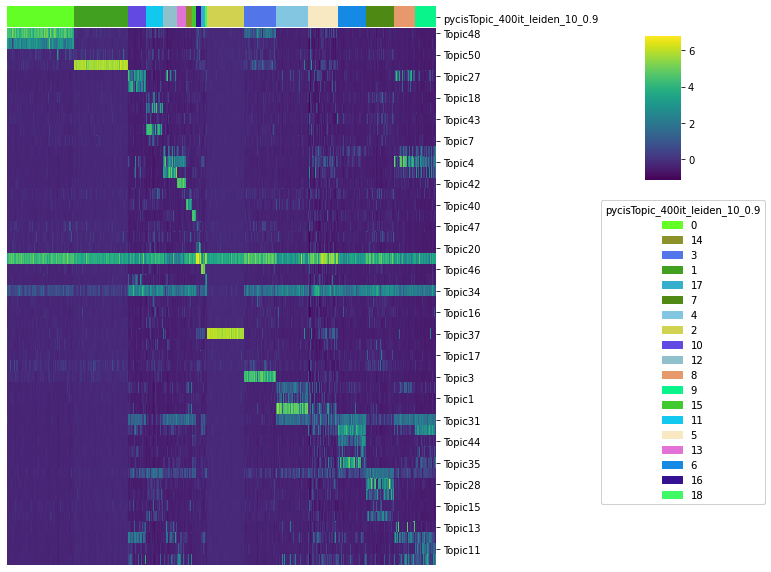

In [47]:
cell_topic_heatmap(cistopic_obj,
                     variables = ['pycisTopic_'+str(niterations)+'it_leiden_10_0.9'],
                     scale = True,
                     legend_loc_x = 1.05,
                     legend_loc_y = -1.2,
                     legend_dist_y = -1,
                     figsize=(10,10))

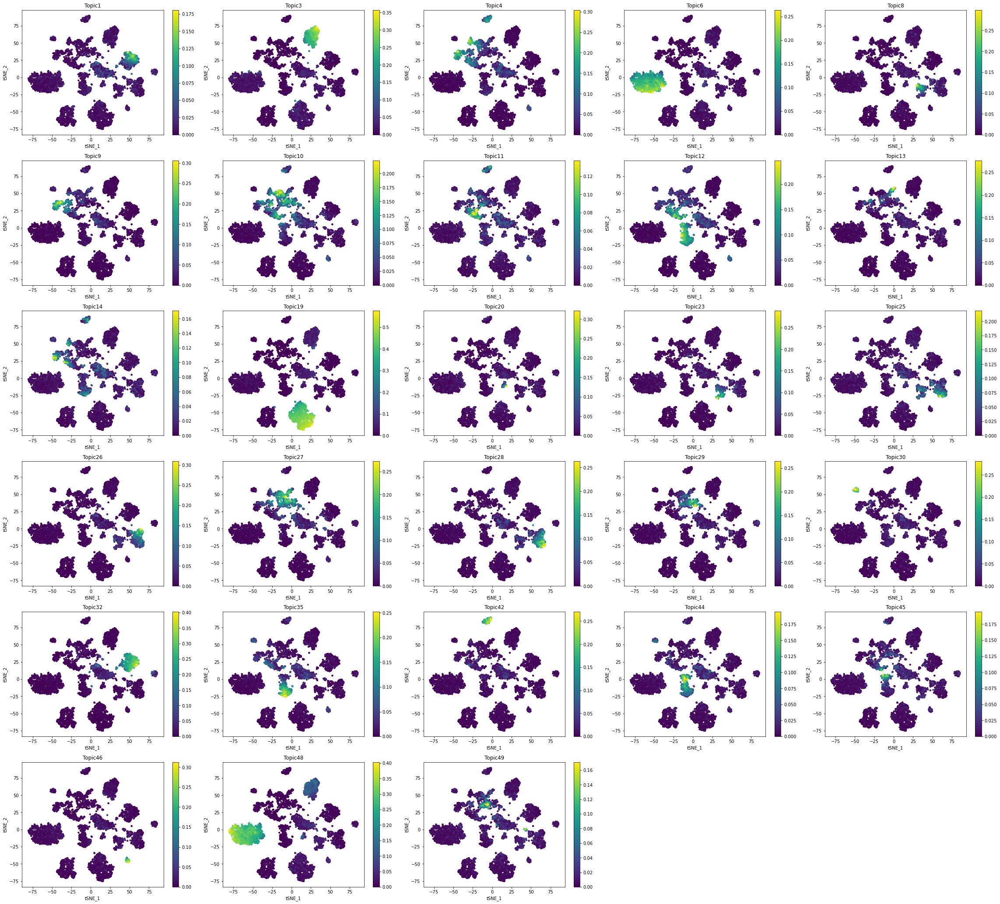

In [18]:
seltopics = [1, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 19, 20, 23, 25, 26, 27, 28, 29, 30, 32, 35, 42, 44, 45, 46, 48, 49]
plot_topic(cistopic_obj,
            reduction_name = 'tSNE',
            target = 'cell',
           selected_topics = seltopics,
            num_columns=5)

### Topic binarization

/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/topic_binarization.py:124: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, j)


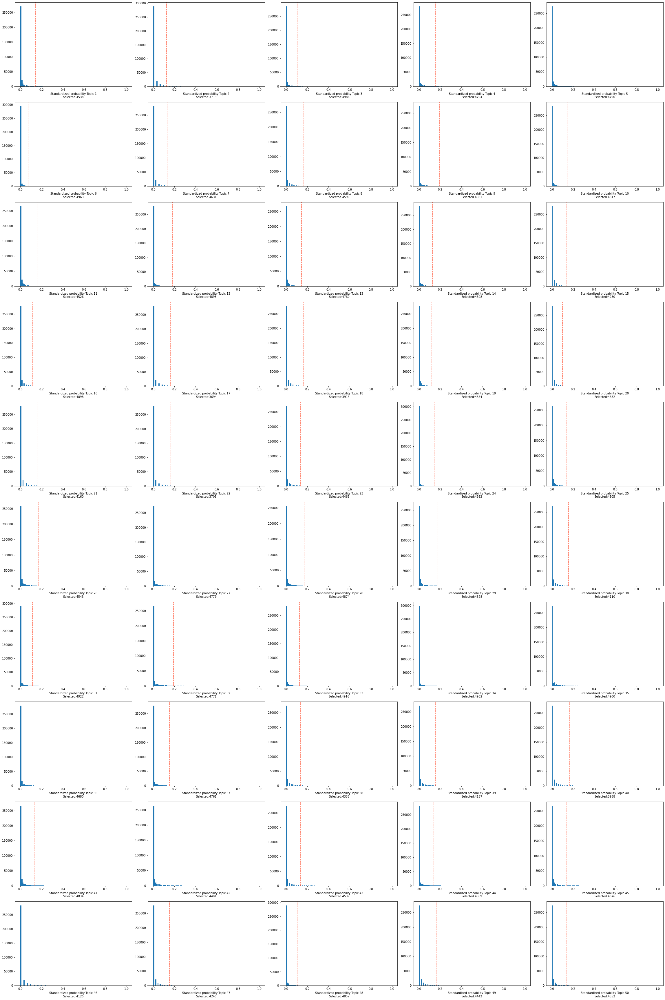

In [23]:
from pycisTopic.topic_binarization import *
region_bin_topics = binarize_topics(cistopic_obj, method='ntop', ntop=5000, plot=True, num_columns=5)

In [29]:
predifined_thr={'Topic33':0.1, 'Topic34':0.1} # inspected visually and this seemed better

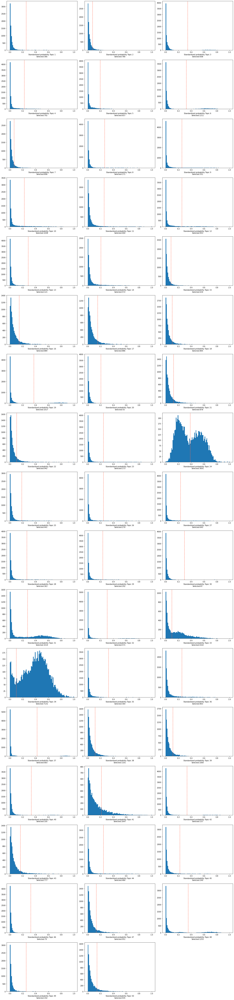

In [30]:
binarized_cell_topic = binarize_topics(cistopic_obj, target='cell', method='otsu', plot=True, num_columns=3, nbins=100, predifined_thr=predifined_thr)

In [31]:
from pycisTopic.topic_qc import *
topic_qc_metrics = compute_topic_metrics(cistopic_obj)

In [32]:
fig_dict={}
fig_dict['CoherenceVSAssignments']=plot_topic_qc(topic_qc_metrics, var_x='Coherence', var_y='Log10_Assignments', var_color='Gini_index', plot=False, return_fig=True)
fig_dict['AssignmentsVSCells_in_bin']=plot_topic_qc(topic_qc_metrics, var_x='Log10_Assignments', var_y='Cells_in_binarized_topic', var_color='Gini_index', plot=False, return_fig=True)
fig_dict['CoherenceVSCells_in_bin']=plot_topic_qc(topic_qc_metrics, var_x='Coherence', var_y='Cells_in_binarized_topic', var_color='Gini_index', plot=False, return_fig=True)
fig_dict['CoherenceVSRegions_in_bin']=plot_topic_qc(topic_qc_metrics, var_x='Coherence', var_y='Regions_in_binarized_topic', var_color='Gini_index', plot=False, return_fig=True)
fig_dict['CoherenceVSMarginal_dist']=plot_topic_qc(topic_qc_metrics, var_x='Coherence', var_y='Marginal_topic_dist', var_color='Gini_index', plot=False, return_fig=True)
fig_dict['CoherenceVSGini_index']=plot_topic_qc(topic_qc_metrics, var_x='Coherence', var_y='Gini_index', var_color='Gini_index', plot=False, return_fig=True)

In [ ]:
# Plot topic stats in one figure
fig=plt.figure(figsize=(40, 43))
i = 1
for fig_ in fig_dict.keys():
    plt.subplot(2, 3, i)
    img = fig2img(fig_dict[fig_]) #To convert figures to png to plot together, see .utils.py. This converts the figure to png.
    plt.imshow(img)
    plt.axis('off')
    i += 1
plt.subplots_adjust(wspace=0, hspace=-0.70)
plt.show()

# Save binarization

In [ ]:

with open(cistopic_out + 'topic_binarization/Topic_qc_metrics.pkl', 'wb') as f:
  pickle.dump(topic_qc_metrics, f)
with open(cistopic_out + 'topic_binarization/binarized_cell_topic.pkl', 'wb') as f:
  pickle.dump(binarized_cell_topic, f)
with open(cistopic_out + 'topic_binarization/binarized_topic_region.pkl', 'wb') as f:
  pickle.dump(region_bin_topics, f)

In [90]:
topic_qc_metrics = pd.DataFrame()
from pycisTopic.topic_qc import *
topic_annot = topic_annotation(cistopic_obj, annot_var='pycisTopic_leiden_10_0.9', binarized_cell_topic=binarized_cell_topic, general_topic_thr = 0.2)
topic_qc_metrics = pd.concat([topic_annot[['pycisTopic_leiden_10_0.9', 'Ratio_cells_in_topic', 'Ratio_group_in_population']], topic_qc_metrics], axis=1)

In [91]:
seltopics = [1, 3, 4, 6, 8, 9, 10, 11, 12, 13, 14, 19, 20, 23, 25, 26, 27, 28, 29, 30, 32, 35, 42, 44, 45, 46, 48, 49]
for i in range(len(seltopics)):
    seltopics[i] = seltopics[i] - 1
print(seltopics)

[0, 2, 3, 5, 7, 8, 9, 10, 11, 12, 13, 18, 19, 22, 24, 25, 26, 27, 28, 29, 31, 34, 41, 43, 44, 45, 47, 48]


### 4. Imputed accessibility

In [13]:
infile = open(cistopic_out + 'topic_binarization/Topic_qc_metrics.pkl', 'rb')
topic_qc_metrics = pickle.load(infile)
infile.close()

infile = open(cistopic_out + 'topic_binarization/binarized_cell_topic.pkl', 'rb')
binarized_cell_topic = pickle.load(infile)
infile.close()

infile = open(cistopic_out + 'topic_binarization/binarized_topic_region.pkl', 'rb')
region_bin_topics = pickle.load(infile)
infile.close()

In [19]:
from pycisTopic.diff_features import *
imputed_acc_obj = impute_accessibility(cistopic_obj, selected_cells=None, selected_regions=None, scale_factor=10**6)

2021-04-11 13:39:14,146 cisTopic     INFO     Imputing drop-outs
2021-04-11 13:39:16,638 cisTopic     INFO     Removing small values
2021-04-11 13:39:28,607 cisTopic     INFO     Converting to sparse matrix
2021-04-11 13:40:40,653 cisTopic     INFO     Scaling
2021-04-11 13:40:43,026 cisTopic     INFO     Keep non zero rows
2021-04-11 13:40:44,964 cisTopic     INFO     Filter rows with only zeros
2021-04-11 13:40:50,400 cisTopic     INFO     Create CistopicImputedFeatures object
2021-04-11 13:40:50,402 cisTopic     INFO     Done!


In [ ]:
with open(cistopic_out + 'DARs/Imputed_accessibility.pkl', 'wb') as f:
  pickle.dump(imputed_acc_obj, f, protocol=4)

### 5. Gene activity
Now, we calculate gene activity based on accessibility near genes. This is imperative for cell annotation

In [40]:
# Get TSS annotations
import pybiomart as pbm
import pyranges as pr
# For mouse
dataset = pbm.Dataset(name='mmusculus_gene_ensembl',  host='http://nov2020.archive.ensembl.org/')
# For human
#dataset = pbm.Dataset(name='hsapiens_gene_ensembl',  host='http://www.ensembl.org')
# For fly
#dataset = pbm.Dataset(name='dmelanogaster_gene_ensembl',  host='http://www.ensembl.org')
annot = dataset.query(attributes=['chromosome_name', 'start_position', 'end_position', 'strand', 'external_gene_name', 'transcription_start_site', 'transcript_biotype'])
annot['Chromosome/scaffold name'] = 'chr' + annot['Chromosome/scaffold name'].astype(str)
annot.columns=['Chromosome', 'Start', 'End', 'Strand', 'Gene','Transcription_Start_Site', 'Transcript_type']
annot = annot[annot.Transcript_type == 'protein_coding']
annot.Strand[annot.Strand == 1] = '+'
annot.Strand[annot.Strand == -1] = '-'
pr_annotation = pr.PyRanges(annot.dropna(axis = 0))

In [41]:
# Get chromosome sizes
import pandas as pd
import requests
target_url='http://hgdownload.cse.ucsc.edu/goldenPath/mm10/bigZips/mm10.chrom.sizes'
chromsizes=pd.read_csv(target_url, sep='\t', header=None)
chromsizes.columns=['Chromosome', 'End']
chromsizes['Start']=[0]*chromsizes.shape[0]
chromsizes=chromsizes.loc[:,['Chromosome', 'Start', 'End']]
chromsizes=pr.PyRanges(chromsizes)

I use a 10 kb window.

In [22]:
from pycisTopic.gene_activity import *
gene_act_10k, weights_10k = get_gene_activity(imputed_acc_obj, # Region-cell probabilities
                pr_annotation, # Gene annotation
                chromsizes, # Chromosome size
                use_gene_boundaries=False, # Whether to use the whole search space or stop when encountering another gene
                upstream=[1000, 10000], # Search space upstream. The minimum means that even if there is a gene right next to it these bp will be taken (1kbp here)
                downstream=[1000,10000], # Search space downstream
                distance_weight=False, # Whether to add a distance weight (an exponential function, the weight will decrease with distance)
                decay_rate=1, # Exponent for the distance exponential funciton (the higher the faster will be the decrease)
                extend_gene_body_upstream=10000, # Number of bp upstream immune to the distance weight (their value will be maximum for this weight)
                extend_gene_body_downstream=500, # Number of bp downstream immune to the distance weight
                gene_size_weight=False, # Whether to add a weights based on the length of the gene
                gene_size_scale_factor='median', # Dividend to calculate the gene size weigth. Default is the median value of all genes in the genome
                remove_promoters=False, # Whether to remove promoters when computing gene activity scores
                average_scores=True, # Whether to divide by the total number of region assigned to a gene when calculating te gene activity score
                scale_factor=1, # Value to multiply for the final gene activity matrix
                extend_tss=[10,10], # Space to consider a promoter
                gini_weight = True, # Whether to add a gini index weigth. The more unique the region is, the higher this weight will be
                return_weights= True, # Whether to return the final weights
                project='Gene_activity_10k') # Project name for the gene activity object

2021-05-01 22:03:29,961 cisTopic     INFO     Calculating distances
2021-05-01 22:05:07,715 cisTopic     INFO     Calculating gini weights
2021-05-01 22:07:48,705 cisTopic     INFO     Getting gene activity scores
2021-05-01 22:13:13,474 cisTopic     INFO     Creating imputed features object


Save gene activities

In [23]:
with open(cistopic_out + 'DAGs/Gene_activity_10k.pkl', 'wb') as f:
  pickle.dump(gene_act_10k, f)
with open(cistopic_out + 'DAGs/weights_10k.pkl', 'wb') as f:
  pickle.dump(weights_10k, f)

In [34]:
infile = open(cistopic_out + 'DAGs/Gene_activity_10k.pkl', 'rb')
gene_act_10k = pickle.load(infile)
infile.close()

infile = open(cistopic_out + 'DAGs/weights_10k.pkl', 'rb')
weights_10k = pickle.load(infile)
infile.close()

# Annotation
Now, we try to annotate the cell types based on imputed gene activity

In [10]:
import pickle
cistopic_out = 'pycistopic_consensus/'

infile = open(cistopic_out + 'cistopicobj/cist
              ndividual_samples_400it_consensusregions_noDBL', 'rb')
cistopic_obj = pickle.load(infile)
infile.close()

infile = open(cistopic_out + 'DAGs/Gene_activity_10k.pkl', 'rb')
gene_act = pickle.load(infile)
infile.close()

infile = open(cistopic_out + 'DAGs/weights_10k.pkl', 'rb')
weigths = pickle.load(infile)
infile.close()

infile = open(cistopic_out + 'DARs/Imputed_accessibility.pkl', 'rb')
imputed_acc_obj = pickle.load(infile)
infile.close()

infile = open(cistopic_out + 'topic_binarization/Topic_qc_metrics.pkl', 'rb')
topic_qc_metrics = pickle.load(infile)
infile.close()

infile = open(cistopic_out + 'topic_binarization/binarized_cell_topic.pkl', 'rb')
binarized_cell_topic = pickle.load(infile)
infile.close()

infile = open(cistopic_out + 'topic_binarization/binarized_topic_region.pkl', 'rb')
region_bin_topics = pickle.load(infile)
infile.close()

/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:706: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:706: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:706: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anac

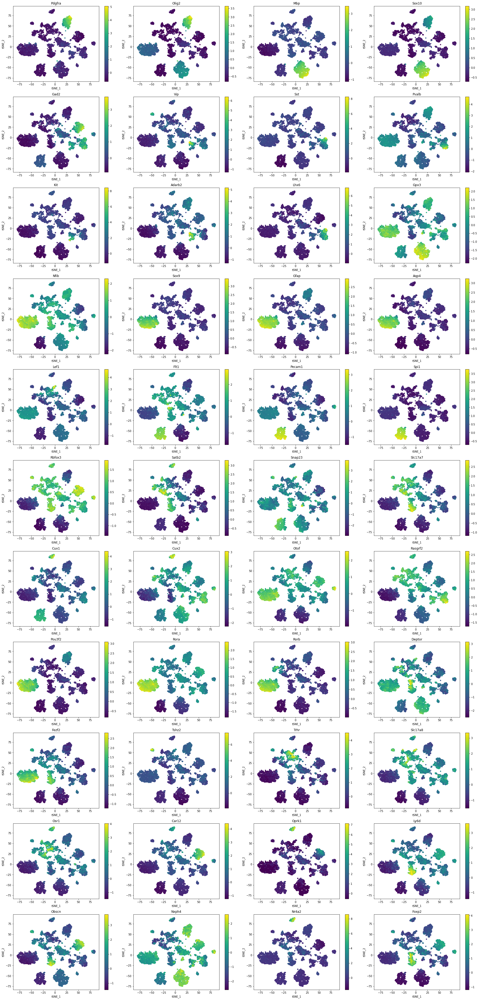

In [16]:
plot_imputed_features(cistopic_obj,
                    reduction_name='tSNE',
                    imputed_data=gene_act,
                    features=['Pdgfra', 'Olig2', 'Mbp', 'Sox10', # Olig differentiation
                              'Gad2', 'Vip', 'Sst', 'Pvalb', # Int
                              'Kit', 'Adarb2', #LGE
                              'Lhx6', 'Gpx3', #MGE
                              'Nfib', 'Sox9', 'Gfap', 'Aqp4',  #Ast
                              'Lef1', 'Flt1','Pecam1', #Endo
                              'Spi1', # Glia
                              'Rbfox3', # Neuron
                              'Satb2', 'Snap23', 'Slc17a7', # Ex
                              'Cux1', 'Cux2', 'Otof','Rasgrf2','Pou3f2', #L2/3
                              'Rora', 'Rorb', # L4
                              'Deptor', 'Fezf2', #L5
                              'Tshz2', 'Trhr', 'Slc17a8', #NP
                              'Osr1', 'Car12', 'Oprk1', #L6IT
                              'Ly6d', 'Obscn', #L6CT
                              'Nxph4', 'Nr4a2', #L6b
                              'Foxp2'], #L6
                    scale=True,
                    num_columns=4)

/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:706: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:706: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:706: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anac

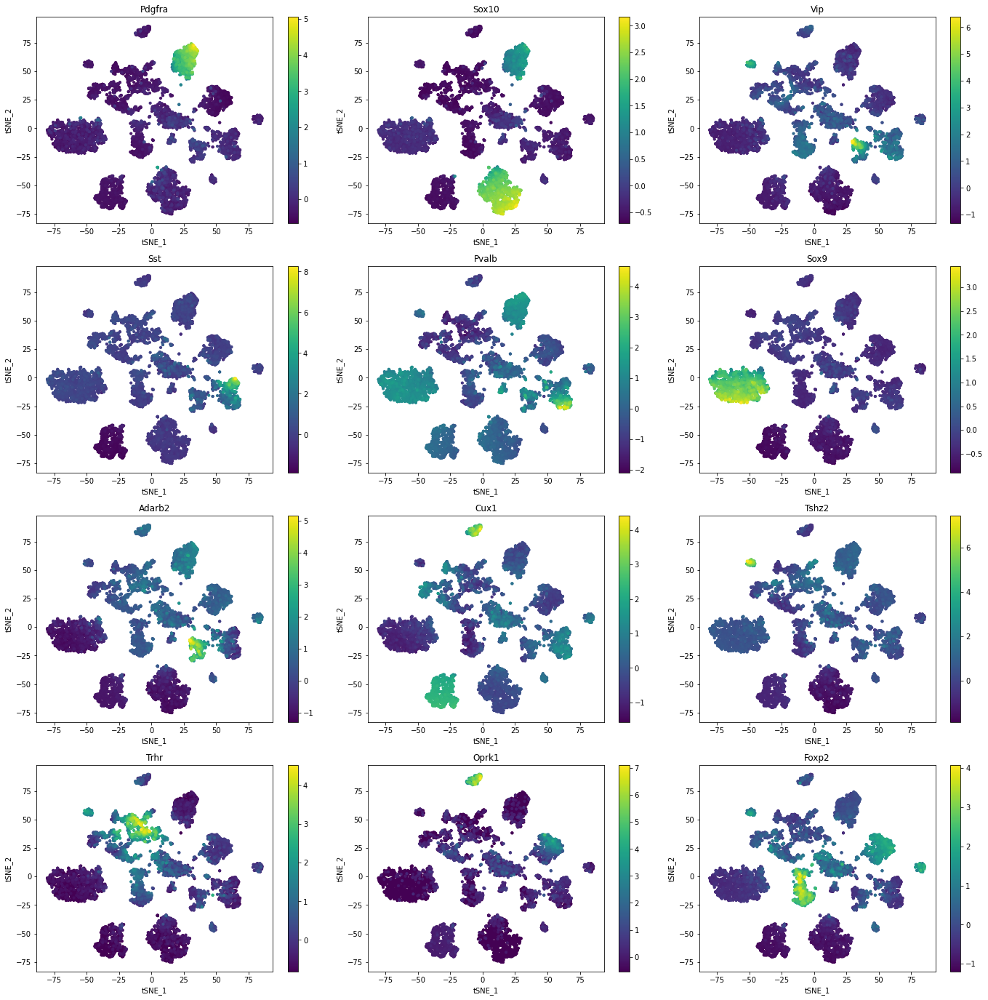

In [73]:
plot_imputed_features(cistopic_obj,
                    reduction_name='tSNE',
                    imputed_data=gene_act,
                    features="Pdgfra Sox10 Vip Sst Pvalb Sox9 Adarb2 Cux1 Tshz2 Trhr Oprk1 Foxp2".split(),
                    scale=True,
                    num_columns=3,
                     save='plts_pub/markergenes.png')

/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:706: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:706: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:706: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anac

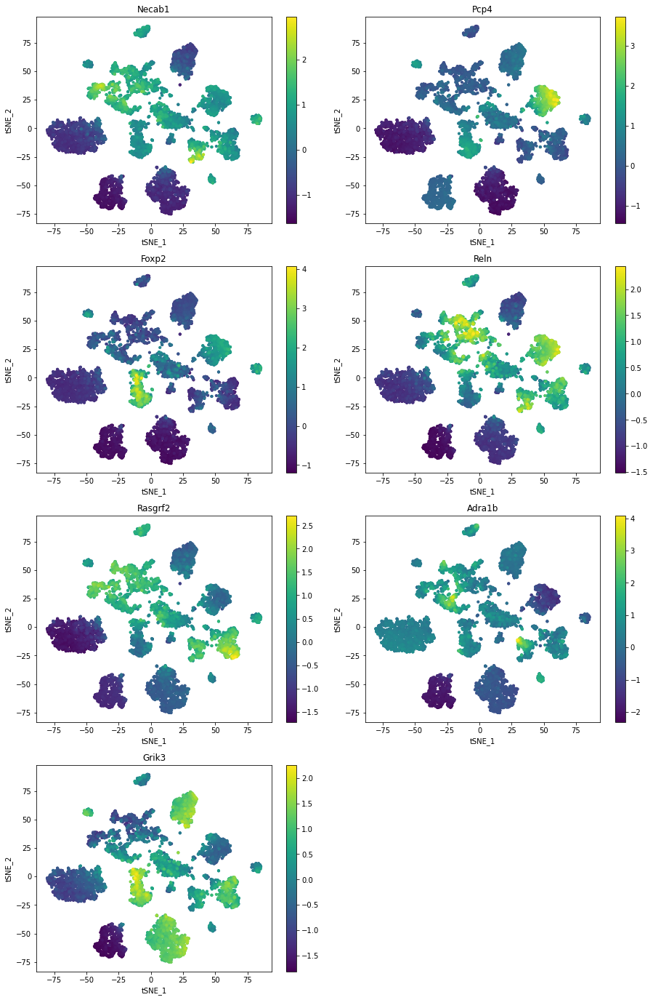

In [31]:
plot_imputed_features(cistopic_obj,
                    reduction_name='tSNE',
                    imputed_data=gene_act,
                    features=['Necab1', 'Pcp4', 'Foxp2', 'Reln', 'Rasgrf2', 'Adra1b', 'Grik3'], 
                    scale=True,
                    num_columns=2)

/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:640: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:640: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:640: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anac

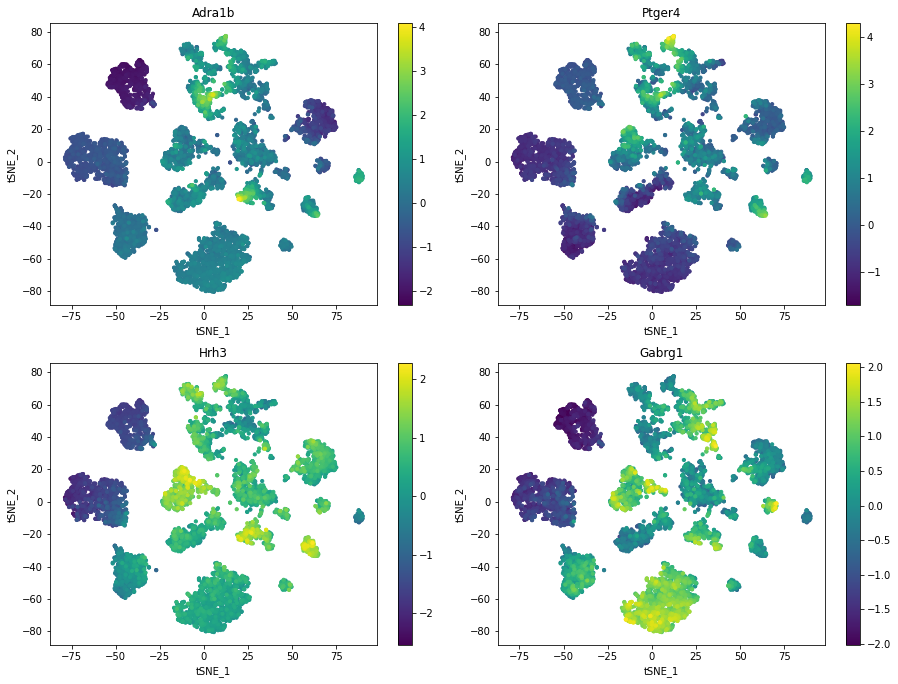

In [166]:
# https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3163272/
# L5
plot_imputed_features(cistopic_obj,
                    reduction_name='tSNE',
                    imputed_data=gene_act,
                    features=['Adra1b', 'Ptger4', 'Hrh3', 'Gabrg1'], #
                    scale=True,
                    num_columns=2)

/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:640: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:640: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:640: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anac

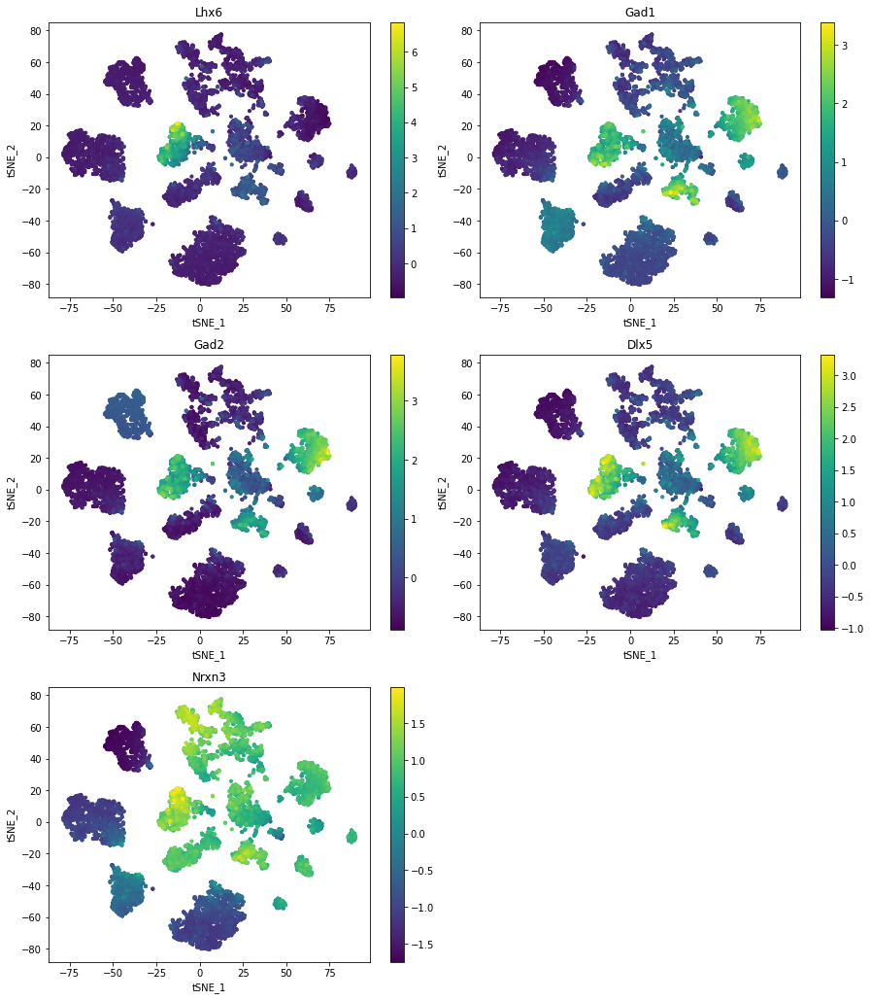

['Lhx6', 'Gad1', 'Gad2', 'Dlx5', 'Nrxn3']

In [56]:
# lge https://www.ncbi.nlm.nih.gov/pmc/articles/PMC5374502/
plot_imputed_features(cistopic_obj,
                    reduction_name='tSNE',
                    imputed_data=gene_act,
                    features='Lhx6 Gad1 Gad2 Dlx5 Nrxn3'.split(), #LGE
                    scale=True,
                    num_columns=2)

# annotate

In [8]:
annot_dict = {}
annot_dict['pycisTopic_leiden_10_0.9'] = {
    '0': 'AST',
    '1': 'MOL',
    '2': 'MGL',
    '3': 'OPC',
    '4':'L5ET',
    '5':'DBL1',
    '6':'L6CT', # it has foxp2
    '7': 'MGE',
    '8': 'L2/3a', # it Reln?
    '9': 'L5/6 ITa', # Adra1b
    '10': 'L2/3b', # it has Reln?
    '11': 'CGE',
    '12': 'L4 IT', # it has Necab1 https://www.bio-connect.nl/cortical-layers/cnt/page/6412
    '13': 'L5/6 ITb',
    '14': 'PIR',
    '15': 'NP',
    '16': 'PER',
    '17': 'PVM',
    '18': 'DBL2',
}

cmap = sns.color_palette("tab20")

keys = cistopic_obj.cell_data['cell_type'].unique()
color_dict = { i : cmap[keys.tolist().index(i)] for i in keys }
color_dict_dict={
    'cell_type': color_dict
}


cistopic_obj.cell_data['cell_type'] = [annot_dict['pycisTopic_leiden_10_0.9'][x] for x in cistopic_obj.cell_data['pycisTopic_leiden_10_0.9'].tolist()]
# https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3163272/

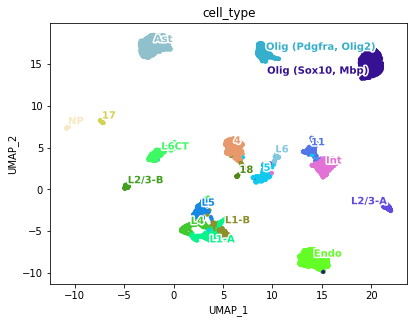

In [5]:
plot_metadata(cistopic_obj,
                 reduction_name='UMAP',
                 variables=['cell_type'], # Labels from RNA and new clusters
                 target='cell', num_columns=1)
                #, save = 'plts_pub/mouse_brain_annotated_2.svg', figsize=(5,5), dot_size=8, alpha=0.8, color_dictionary=color_dict_dict)

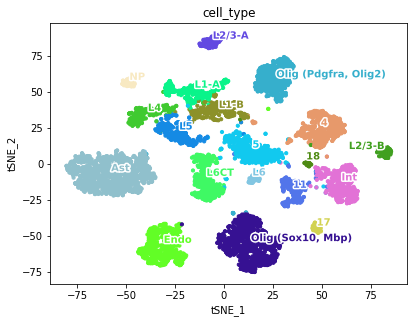

In [6]:
plot_metadata(cistopic_obj,
                 reduction_name='tSNE',
                 variables=['cell_type'], # Labels from RNA and new clusters
                 target='cell', num_columns=1)
                #, save = 'plts_pub/mouse_brain_annotated_2.svg', figsize=(5,5), dot_size=8, alpha=0.8, color_dictionary=color_dict_dict)

# Now, find differentially accessible features

In [26]:
ray.shutdown()
markers_dict= find_diff_features(cistopic_obj, 
                      gene_act_10k,
                      variable='cell_type_finetuned',
                      var_features=None,
                      contrasts=None,
                      adjpval_thr=0.05,
                      log2fc_thr=np.log2(1.5),
                      n_cpu=16) 

2021-05-01 22:16:56,432	INFO services.py:1267 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=46051) 2021-05-01 22:16:59,584 cisTopic     INFO     Computing p-value for AST
(pid=46048) 2021-05-01 22:16:59,625 cisTopic     INFO     Computing p-value for DBL1
(pid=46044) 2021-05-01 22:16:59,625 cisTopic     INFO     Computing p-value for CGE (Vip+)
(pid=46045) 2021-05-01 22:16:59,654 cisTopic     INFO     Computing p-value for DBL2
(pid=46041) 2021-05-01 22:16:59,667 cisTopic     INFO     Computing p-value for END
(pid=46053) 2021-05-01 22:16:59,716 cisTopic     INFO     Computing p-value for CGE (Lamp5+)
(pid=46038) 2021-05-01 22:16:59,855 cisTopic     INFO     Computing p-value for L2/3a
(pid=46046) 2021-05-01 22:17:00,065 cisTopic     INFO     Computing p-value for L2/3b
(pid=46040) 2021-05-01 22:17:00,249 cisTopic     INFO     Computing p-value for L4 IT
(pid=46049) 2021-05-01 22:17:00,458 cisTopic     INFO     Computing p-value for L5/6 ITa
(pid=46043) 2021-05-01 22:17:00,672 cisTopic     INFO     Computing p-value for L5/6 ITb
(pid=46047) 2021-05-01 22:17:00,888 cisTop

In [27]:
x = [print(x + ': '+ str(len(markers_dict[x]))) for x in markers_dict.keys()]

AST: 2328
CGE (Lamp5+): 1203
CGE (Vip+): 1138
DBL1: 910
DBL2: 832
END: 1775
L2/3a: 2166
L2/3b: 1959
L4 IT: 2137
L5/6 ITa: 2233
L5/6 ITb: 1814
L5ET: 1863
L6CT: 1890
L6b: 1770
MGE (Pvalb+): 1481
MGE (Sst+): 1392
MGL: 3530
MOL: 2232
NP: 1557
OPC: 1213
PER: 461
PIR: 1185
PVM: 1165


In [6]:
import pickle
infile = open(cistopic_out + 'DAGs/markers_dict_DAGs_10k.pkl', 'rb')
markers_dict = pickle.load(infile)
infile.close()

In [12]:
for x in markers_dict.keys():
    print(x + ': ' + str(markers_dict[x].index.tolist()[:10]))

AST: ['Olfr1299', 'Olfr1298', 'Esp23', 'Olfr1135', 'Olfr1134', 'Olfr1033', 'Skint5', 'Olfr1034', 'Olfr237', 'Defa3']
CGE (Lamp5+): ['Ifi211', 'Abo', 'Olfr944', 'Olfr1469', 'Rasef', 'Triml1', 'Olfr285', 'Serpina3c', 'Ibsp', 'Dppa2']
CGE (Vip+): ['Olfr1272', 'Olfr525', 'Dppa2', 'Pudp', 'Reg3d', 'Reg3a', 'Reg2', 'Acsm1', 'Krt78', 'Krt79']
DBL1: ['Gm12353', 'Myot', 'Olfr1225', 'Gm9507', 'Serpinb2', 'Mmp7', 'Olfr1226', 'Gm8247', 'Gm5624', 'Gm17490']
DBL2: ['Hsf3', 'Vmn2r26', 'Mc2r', 'Tmprss11f', 'Olfr944', 'Olfr782', 'Zfp42', 'Trim52', 'Rgn', 'Tas2r135']
END: ['Oas1a', 'Prr30', 'Clec4f', 'Olfr419', 'Olfr11', '2310057N15Rik', 'Vmn1r207', '2310034C09Rik', 'Vmn2r87', 'Npvf']
L2/3a: ['Olfr560', 'Mmp27', 'Ogn', 'Amelx', 'Retnlg', 'Gm20594', 'Olfr1360', 'Olfr120', 'Gm15130', 'Calcr']
L2/3b: ['Dppa3', 'Olfr67', 'Olfr68', 'Zfp42', 'AC124764.1', 'H2al3', 'H2ap', 'Gpr141', 'Olfr608', 'Gm28269']
L4 IT: ['Dgkk', 'Gm7579', 'Gm11115', 'Prame', 'Olfr266', 'Olfr1217', 'Olfr568', 'Gzmc', 'Olfr1426', 'Vmn1r1

In [33]:
markers_dict_rna={
'AST': ['Aqp4', 'Fam107a', 'Mlc1'],  #Ast"Fam107a Cbs Ppp1r3g Gm11627".split()
'MGL': "P2ry12 Gpr34 Selplg".split(),
'Olig': ['Olig2', 'Mbp'], # Olig differentiation
'MOL': "Opalin Ninj2".split(),
'OPC': "Pdgfra".split(),
'ENDO': ['Lef1'], #Endo, left out Lef1
'VLM': ['Slc6a13', 'Ptgds', 'Gjb2'],
'MGE': ['Pvalb', 'Sst', 'Pde11a'], #MGE"Lhx6 Gpx3 Pde11a".split()
'INT': ['Gad2'], # Int
'CGE': "Lamp5 Vip Cxcl14".split(),
'LGE': ['Kit', 'Adarb2'], #LGE,
'MSN': ['Ppp1r1b', 'Rarb'],
'L2/3': ['Cux1', 'Cux2','Rasgrf2'], #L2/3
'L4': ['Rora', 'Rorb'], # L4
'L5': "Ptprt Deptor Scube1 Hs3st2".split(),
'NP': ['Tshz2'], #NP
'L6': [ 'Foxp2', 'Rxfp1', 'Car3', 'Oprk1', 'Nr4a2', 'Galnt14'] #L6IT
}

In [28]:
with open(cistopic_out + 'DAGs/markers_dict_DAGs_10k.pkl', 'wb') as f:
  pickle.dump(markers_dict, f)

In [34]:
test = list(markers_dict_rna.values())

In [35]:
flat_list = [item for sublist in test for item in sublist]

In [41]:
cistopic_obj.cell_data['cell_type_finetuned'].value_counts()

AST             1251
MOL             1013
MGL              686
OPC              611
L5ET             582
DBL1             570
L5/6 ITa         374
L6CT             344
L2/3b            339
L2/3a            318
L4 IT            276
MGE (Sst+)       267
MGE (Pvalb+)     255
CGE (Vip+)       192
L6b              177
L5/6 ITb         158
CGE (Lamp5+)     111
PIR              108
NP                86
END               82
PER               80
PVM               80
DBL2              36
Name: cell_type_finetuned, dtype: int64

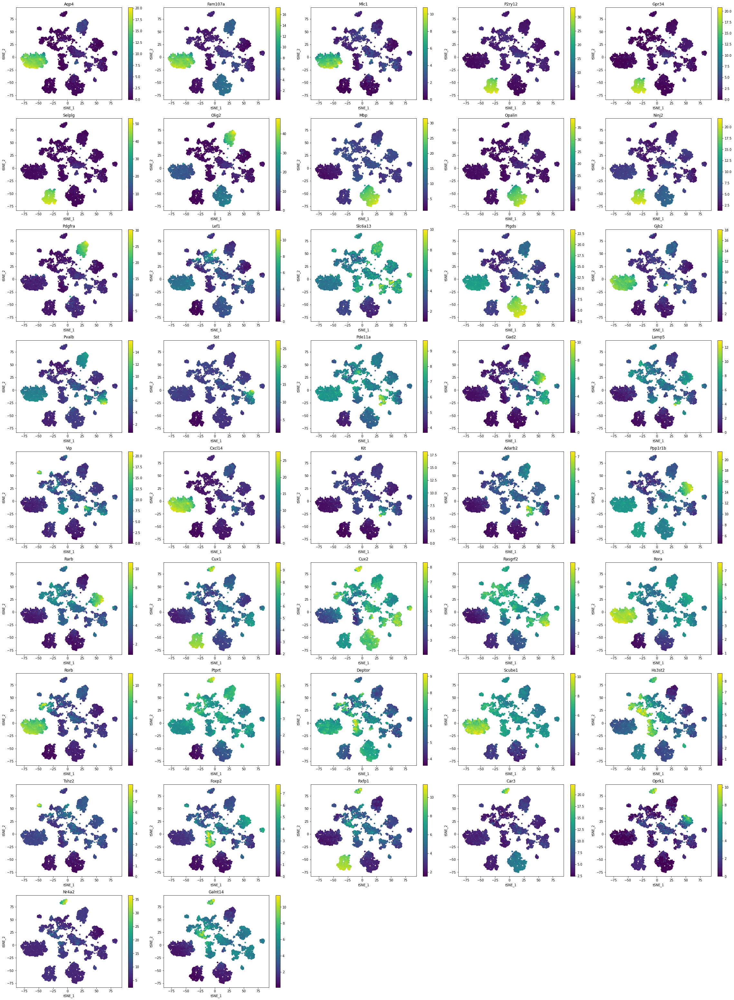

In [37]:
from pycisTopic.clust_vis import *
plot_imputed_features(cistopic_obj,
                    reduction_name='tSNE',
                    imputed_data=gene_act_10k,
                    features=flat_list,
                    scale=False,
                    num_columns=5,
                     save='plts_python/markers_rna.png')

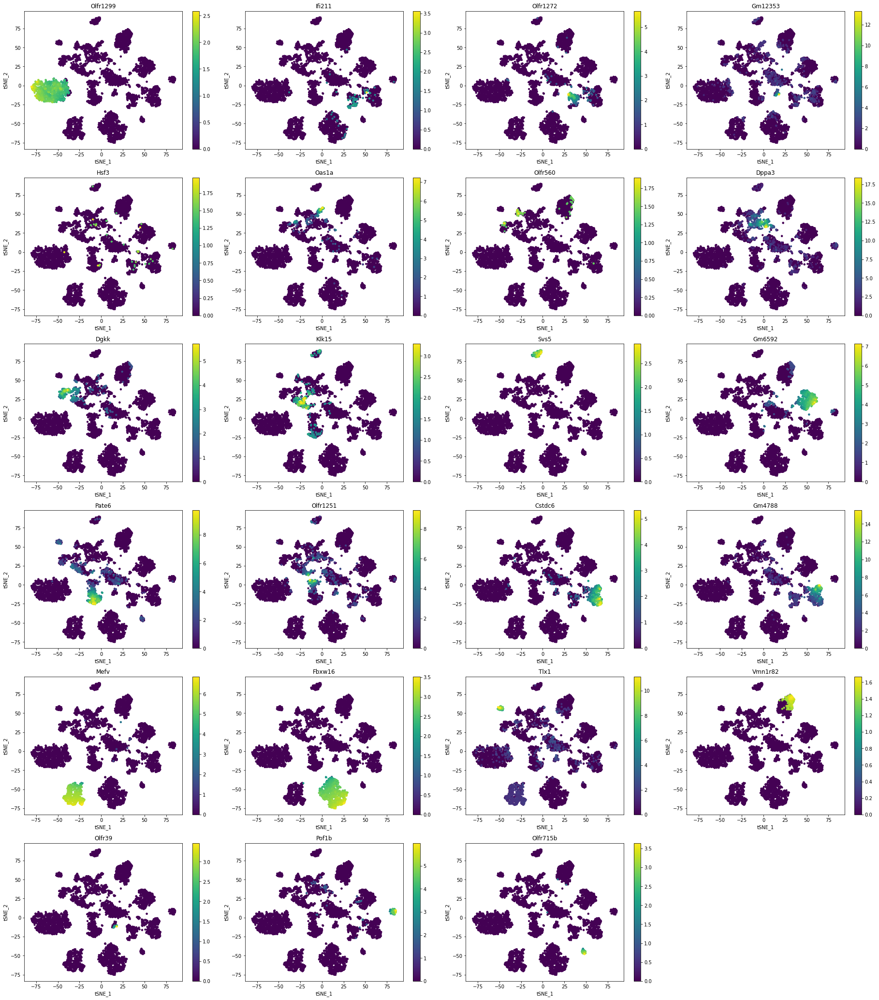

In [43]:
from pycisTopic.clust_vis import *
plot_imputed_features(cistopic_obj,
                    reduction_name='tSNE',
                    imputed_data=gene_act_10k,
                    features=[markers_dict[x].index.tolist()[0] for x in markers_dict.keys()],
                    scale=False,
                    num_columns=4)

# Finetune annotation
Based on imputed gene activity, we can finetune the annotation beyond the leiden clusters.

In [ ]:
annot_dict = {}
annot_dict['pycisTopic_leiden_10_0.9'] = {
    '0': 'AST',
    '1': 'MOL',
    '2': 'MGL',
    '3': 'OPC',
    '4':'L5ET',
    '5':'DBL1',
    '6':'L6CT', # it has foxp2
    '7': 'MGE',
    '8': 'L2/3', # it Reln?
    '9': 'L5/6 ITa', # Adra1b
    '10': 'L2/3', # it has Reln?
    '11': 'CGE',
    '12': 'L4 IT', # it has Necab1 https://www.bio-connect.nl/cortical-layers/cnt/page/6412
    '13': 'L5/6 ITb',
    '14': 'PIR',
    '15': 'NP',
    '16': 'PER',
    '17': 'PVM',
    '18': 'DBL2',
}

cmap = sns.color_palette("tab20")

keys = cistopic_obj.cell_data['cell_type'].unique()
color_dict = { i : cmap[keys.tolist().index(i)] for i in keys }
color_dict_dict={
    'cell_type': color_dict
}


cistopic_obj.cell_data['cell_type'] = [annot_dict['pycisTopic_leiden_10_0.9'][x] for x in cistopic_obj.cell_data['pycisTopic_leiden_10_0.9'].tolist()]
# https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3163272/

In [5]:
annot_dict = {}
annot_dict['cell_type_finetuned'] = {
    '0': 'AST',
    '1': 'MOL',
    '2': 'MGL',
    '3': 'OPC',
    '4':'L5ET',
    '5':'UNK',
    '6':'L6CT', # it has foxp2
    '7': 'MGE',
    '8': 'L2/3', # it Reln?
    '9': 'L5/6 IT', # Adra1b
    '10': 'L2/3', # it has Reln?
    '11': 'CGE',
    '12': 'L4 IT', # it has Necab1 https://www.bio-connect.nl/cortical-layers/cnt/page/6412
    '13': 'L6 IT (Car3+)',
    '14': 'PIR',
    '15': 'NP',
    '16': 'UNK',
    '17': 'UNK',
    '18': 'UNK',
}

cmap = sns.color_palette("tab20")


cistopic_obj.cell_data['cell_type_finetuned'] = [annot_dict['cell_type_finetuned'][x] for x in cistopic_obj.cell_data['pycisTopic_leiden_10_0.9'].tolist()]

# https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3163272/

The csv files below contain barcodes that I selected out using SCOPE.

In [6]:
df_pvalb = pd.read_csv('cell_type_finetuned/pvalb.csv')
df_lamp5 = pd.read_csv('cell_type_finetuned/lamp5.csv')
df_lef1 = pd.read_csv('cell_type_finetuned/lef1.csv')
df_nxph3 = pd.read_csv('cell_type_finetuned/nxph3.csv')

In [7]:
barcodes_pvalb = df_pvalb['cellID']
barcodes_lamp5 = df_lamp5['cellID']
barcodes_lef1 = df_lef1['cellID']
barcodes_nxph3 = df_nxph3['cellID']

In [8]:
cistopic_obj.cell_data['cell_type_finetuned'][barcodes_pvalb] = 'MGE (Pvalb+)'
cistopic_obj.cell_data['cell_type_finetuned'][barcodes_lamp5] = 'CGE (Lamp5+)'
cistopic_obj.cell_data['cell_type_finetuned'][barcodes_lef1] = 'END'
cistopic_obj.cell_data['cell_type_finetuned'][barcodes_nxph3] = 'L6b'

In [9]:
cistopic_obj.cell_data['cell_type_finetuned'].replace('MGE', 'MGE (Sst+)', inplace=True)

In [10]:
cistopic_obj.cell_data['cell_type_finetuned'].replace('CGE', 'CGE (Vip+)', inplace=True)

In [11]:
print(cistopic_obj.cell_data['cell_type_finetuned'].unique())
print(len(cistopic_obj.cell_data['cell_type_finetuned'].unique()))

['AST' 'NP' 'L5/6 IT' 'L6CT' 'MGL' 'MOL' 'MGE (Sst+)' 'L6b' 'L2/3'
 'L6 IT (Car3+)' 'OPC' 'L5ET' 'PIR' 'UNK' 'CGE (Vip+)' 'L4 IT'
 'CGE (Lamp5+)' 'MGE (Pvalb+)' 'END']
19


In [27]:
cmap = sns.color_palette('hls', len(cistopic_obj.cell_data['cell_type_finetuned'].unique()))

keys = cistopic_obj.cell_data['cell_type_finetuned'].unique()
color_dict = { i : cmap[keys.tolist().index(i)] for i in keys }
color_dict_dict={
    'cell_type_finetuned': color_dict
}

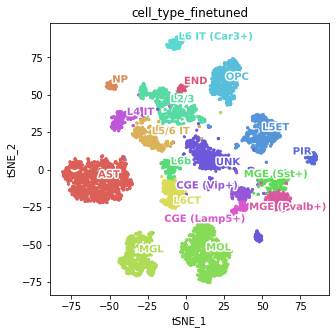

In [28]:
plot_metadata(cistopic_obj,
                 reduction_name='tSNE',
                 variables=['cell_type_finetuned'], # Labels from RNA and new clusters
                 target='cell', num_columns=1,
             save = 'plts_pub/mouse_brain_annotated_finalannotation_finetuned_reduced.svg', figsize=(5,5), dot_size=5, alpha=1, color_dictionary=color_dict_dict)

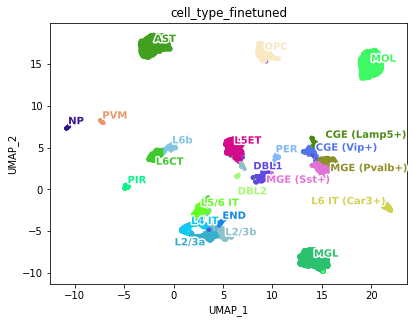

In [100]:
plot_metadata(cistopic_obj,
                 reduction_name='UMAP',
                 variables=['cell_type_finetuned'], # Labels from RNA and new clusters
                 target='cell', num_columns=1)
                #, save = 'plts_pub/mouse_brain_annotated_2.svg', figsize=(5,5), dot_size=8, alpha=0.8, color_dictionary=color_dict_dict)

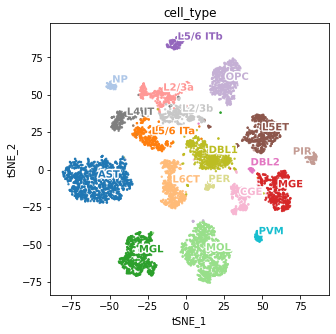

In [13]:
plot_metadata(cistopic_obj,
                 reduction_name='tSNE',
                 variables=['cell_type'], # Labels from RNA and new clusters
                 target='cell', num_columns=1,
             save = 'plts_pub/mouse_brain_annotated_finalannotation.svg', figsize=(5,5), dot_size=2, alpha=0.8, color_dictionary=color_dict_dict)

# Per-cluster bigwigs and peak calling

In [103]:
cistopic_obj.cell_data['cell_type'].unique()

array(['AST', 'NP', 'L5/6 ITa', 'L6CT', 'MGL', 'MOL', 'MGE', 'L2/3',
       'L5/6 ITb', 'OPC', 'L5ET', 'PIR', 'DBL5', 'CGE', 'L4 IT', 'DBL2',
       'DBL1', 'DBL3', 'DBL4'], dtype=object)

In [23]:
import glob as glob
filenames = glob.glob('fragments/*.fragments.NONEGS.tsv.gz')
samples = [item.replace(".sinto.fragments.NONEGS.tsv.gz", "") for item in filenames]
samples = [item.replace("fragments/", "") for item in samples]
fragments_dict = {samples[i]: filenames[i] for i in range(len(samples))}
fragments_dict

{'HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5.sinto.fragments.NONEGS.tsv.gz',
 'HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2': 'fragments/HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2.sinto.fragments.NONEGS.tsv.gz',
 'HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4': 'fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4.sinto.fragments.NONEGS.tsv.gz',
 'HYA__af8d60__20210309_mouse_cortex_MCF-7_PC3_1-2_S3': 'fragments/HYA__af8d60__20210309_mouse_cortex_MC

In [21]:
# Get chromosome sizes (for mm10 here)
import pyranges as pr
import requests
# target_url='http://hgdownload.cse.ucsc.edu/goldenPath/hg38/bigZips/hg38.chrom.sizes'
target_url='https://raw.githubusercontent.com/igvteam/igv/master/genomes/sizes/mm10.chrom.sizes'
chromsizes=pd.read_csv(target_url, sep='\t', header=None)
chromsizes.columns=['Chromosome', 'End']
chromsizes['Start']=[0]*chromsizes.shape[0]
chromsizes=chromsizes.loc[:,['Chromosome', 'Start', 'End']]
# Exceptionally in this case, to agree with CellRangerARC annotations
# chromsizes['Chromosome'] = [chromsizes['Chromosome'][x].replace('v', '.') for x in range(len(chromsizes['Chromosome']))]
# chromsizes['Chromosome'] = [chromsizes['Chromosome'][x].split('_')[1] if len(chromsizes['Chromosome'][x].split('_')) > 1 else chromsizes['Chromosome'][x] for x in range(len(chromsizes['Chromosome']))]
chromsizes=pr.PyRanges(chromsizes)

In [105]:
nclusters = len(cistopic_obj.cell_data['cell_type'].unique())

you can put nthreads of all the subsequent jobs to nclusters. more is not necessary.

!!! make sure that the annot res clusters is correct

In [107]:
from pycisTopic.pseudobulk_peak_calling import *

In [24]:
import numexpr
nclusters = 16
numexpr.set_num_threads(nclusters)
ray.shutdown()
bw_paths, bed_paths = export_pseudobulk(input_data = cistopic_obj.cell_data,
                 variable = 'cell_type_finetuned',
                 chromsizes = chromsizes,
                 bed_path = 'pycistopic_consensus/pseudobulk_bed_afterconsensusregions_finalannotation_finetuned_reduced',
                 bigwig_path =  'pycistopic_consensus/pseudobulk_bigwig_afterconsensusregions_finalannotation_finetuned_reduced',
                 path_to_fragments = fragments_dict,
                 n_cpu = nclusters,
                 normalize_bigwig = True,
                 remove_duplicates = True)

2021-05-06 17:50:01,096 cisTopic     INFO     Reading fragments from fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-1_S1.sinto.fragments.NONEGS.tsv.gz
2021-05-06 17:50:35,779 cisTopic     INFO     Reading fragments from fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-5_S5.sinto.fragments.NONEGS.tsv.gz
2021-05-06 17:51:12,987 cisTopic     INFO     Reading fragments from fragments/HYA__932b0e__20210309_mouse_cortex_MCF-7_PC3_1-1_S2.sinto.fragments.NONEGS.tsv.gz
2021-05-06 17:51:16,198 cisTopic     INFO     Reading fragments from fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-3_S3.sinto.fragments.NONEGS.tsv.gz
2021-05-06 17:51:58,727 cisTopic     INFO     Reading fragments from fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-2_S2.sinto.fragments.NONEGS.tsv.gz
2021-05-06 17:52:36,179 cisTopic     INFO     Reading fragments from fragments/HYA__combined__20210323_cortex_phu_dv_etssb_1-4_S4.sinto.fragments.NONEGS.tsv.gz
2021-05-06 17:53:14,025 cisTopic     IN

2021-05-06 17:53:18,668	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=3870) 2021-05-06 17:53:30,543 cisTopic     INFO     Creating pseudobulk for AST
(pid=3870) 2021-05-06 17:53:30,543 cisTopic     INFO     Creating pseudobulk for AST
(pid=3870) 2021-05-06 17:53:35,706 numexpr.utils INFO     Note: NumExpr detected 36 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
(pid=3870) 2021-05-06 17:53:35,706 numexpr.utils INFO     Note: NumExpr detected 36 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
(pid=3868) 2021-05-06 17:53:37,557 cisTopic     INFO     Creating pseudobulk for CGE_Lamp5_
(pid=3868) 2021-05-06 17:53:37,557 cisTopic     INFO     Creating pseudobulk for CGE_Lamp5_
(pid=3868) 2021-05-06 17:53:41,230 numexpr.utils INFO     Note: NumExpr detected 36 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
(pid=3868) 2021-05-06 17:53:41,230 numexpr.utils INFO     Note: NumExpr detected 36 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
(pid=3869) 2021-05-06 17:5

In [25]:
cistopic_obj.cell_data['cell_type_finetuned'].unique()

array(['AST', 'NP', 'L5/6 IT', 'L6CT', 'MGL', 'MOL', 'MGE (Sst+)', 'L6b',
       'L2/3', 'L6 IT (Car3+)', 'OPC', 'L5ET', 'PIR', 'UNK', 'CGE (Vip+)',
       'L4 IT', 'CGE (Lamp5+)', 'MGE (Pvalb+)', 'END'], dtype=object)

In [ ]:
import pickle 
with open('pycistopic_consensus/pseudobulk_bed_afterconsensusregions/bed_paths.pkl', 'wb') as f:
  pickle.dump(bed_paths, f)

import pickle 
with open('pycistopic_consensus/pseudobulk_bigwig_afterconsensusregions/bigwig_paths.pkl', 'wb') as f:
  pickle.dump(bw_paths, f)

# Calculate DARs

In [11]:
from pycisTopic.diff_features import *
imputed_acc_obj = impute_accessibility(cistopic_obj, selected_cells=None, selected_regions=None, scale_factor=10**6)

2021-04-20 14:05:33,946 cisTopic     INFO     Imputing drop-outs


KeyboardInterrupt: 

In [13]:
import pickle
# infile = open(cistopic_out + 'DARs/Imputed_accessibility.pkl', 'rb')
# imputed_acc_obj = pickle.load(infile)
# infile.close()

infile = open(cistopic_out + 'DARs/Imputed_accessibility.pkl', 'rb')
imputed_acc_obj = pickle.load(infile)
infile.close()

infile = open(cistopic_out + 'DARs/DARs.pkl', 'rb')
markers_dict = pickle.load(infile)
infile.close()

In [14]:
normalized_imputed_acc_obj = normalize_scores(imputed_acc_obj, scale_factor=10**4)

2021-05-06 17:30:37,718 cisTopic     INFO     Normalizing imputed data
2021-05-06 17:31:25,535 cisTopic     INFO     Done!


2021-05-06 17:33:37,856 cisTopic     INFO     Calculating mean and variance


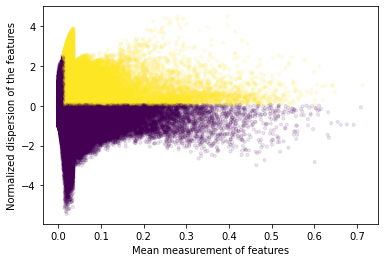

2021-05-06 17:35:24,247 cisTopic     INFO     Done!


In [15]:
variable_regions = find_highly_variable_features(normalized_imputed_acc_obj,
                                           min_disp = 0.05,
                                           min_mean = 0.0125, 
                                           max_mean = 3,
                                           max_disp = np.inf,
                                           n_bins=20, 
                                           n_top_features=None,
                                           plot=True,
                                           save=cistopic_out + 'DARs/HVR_plot.pdf')

In [16]:
ray.shutdown()

In [17]:
markers_dict= find_diff_features(cistopic_obj, 
                      imputed_acc_obj,
                      variable='cell_type_finetuned',
                      var_features=variable_regions,
                      contrasts=None,
                      adjpval_thr=0.05,
                      log2fc_thr=np.log2(1.5),
                      n_cpu=12)

2021-05-06 17:35:30,880	INFO services.py:1174 -- View the Ray dashboard at http://127.0.0.1:8265


(pid=29026) 2021-05-06 17:35:41,012 cisTopic     INFO     Computing p-value for L5ET
(pid=29023) 2021-05-06 17:35:42,074 cisTopic     INFO     Computing p-value for L2/3
(pid=29017) 2021-05-06 17:35:42,229 cisTopic     INFO     Computing p-value for CGE (Lamp5+)
(pid=29022) 2021-05-06 17:35:42,282 cisTopic     INFO     Computing p-value for L6 IT (Car3+)
(pid=29016) 2021-05-06 17:35:42,257 cisTopic     INFO     Computing p-value for L4 IT
(pid=29013) 2021-05-06 17:35:42,242 cisTopic     INFO     Computing p-value for END
(pid=29020) 2021-05-06 17:35:42,289 cisTopic     INFO     Computing p-value for AST
(pid=29010) 2021-05-06 17:35:42,368 cisTopic     INFO     Computing p-value for L5/6 IT
(pid=29027) 2021-05-06 17:35:42,369 cisTopic     INFO     Computing p-value for CGE (Vip+)
(pid=29024) 2021-05-06 17:35:42,770 cisTopic     INFO     Computing p-value for L6CT
(pid=29004) 2021-05-06 17:35:43,535 cisTopic     INFO     Computing p-value for L6b
(pid=29008) 2021-05-06 17:35:44,560 cisTo

In [18]:
x = [print(x + ': '+ str(len(markers_dict[x]))) for x in markers_dict.keys()]

AST: 18461
CGE (Lamp5+): 10894
CGE (Vip+): 11463
END: 21575
L2/3: 30967
L4 IT: 28773
L5/6 IT: 34197
L5ET: 20392
L6 IT (Car3+): 23963
L6CT: 25421
L6b: 22323
MGE (Pvalb+): 13170
MGE (Sst+): 11881
MGL: 18311
MOL: 18193
NP: 13894
OPC: 13716
PIR: 12917
UNK: 12468


# Write dars to bed file 

In [19]:
for x in cistopic_obj.cell_data['cell_type_finetuned'].unique():
    markers = markers_dict[x].index.tolist()
    df = pd.DataFrame(markers)
    df[[0,1]] = df[0].str.split(':',expand=True)
    df[[1,2]] = df[1].str.split('-',expand=True)
    df[3] = markers_dict[x].index.tolist()
    df[3] = x + '_' + df[3].astype(str)
    score = markers_dict[x]['Log2FC']
    score = score.reset_index(drop=True)
    df[4] = score
    name = x.replace(' ', '_')
    name = name.replace('/', '-')
    df.to_csv('DAR_beds_finalannotation_finetuned_reduced/'+name+'_DARs.bed', sep='\t', header=False, index=False)

2021-05-06 17:44:05,620 numexpr.utils INFO     Note: NumExpr detected 36 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.


In [ ]:
markers = markers_dict[x]

## Plot DAGs

In [ ]:
import pickle
infile = open('pycistopic_consensus/DAGs/DAGs.pkl', 'rb')
dags = pickle.load(infile)
infile.close()

/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:706: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:706: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda3/lib/python3.7/site-packages/pycisTopic/clust_vis.py:706: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  plt.subplot(num_rows, num_columns, i)
/staging/leuven/stg_00002/lcb/fderop/software_2/anac

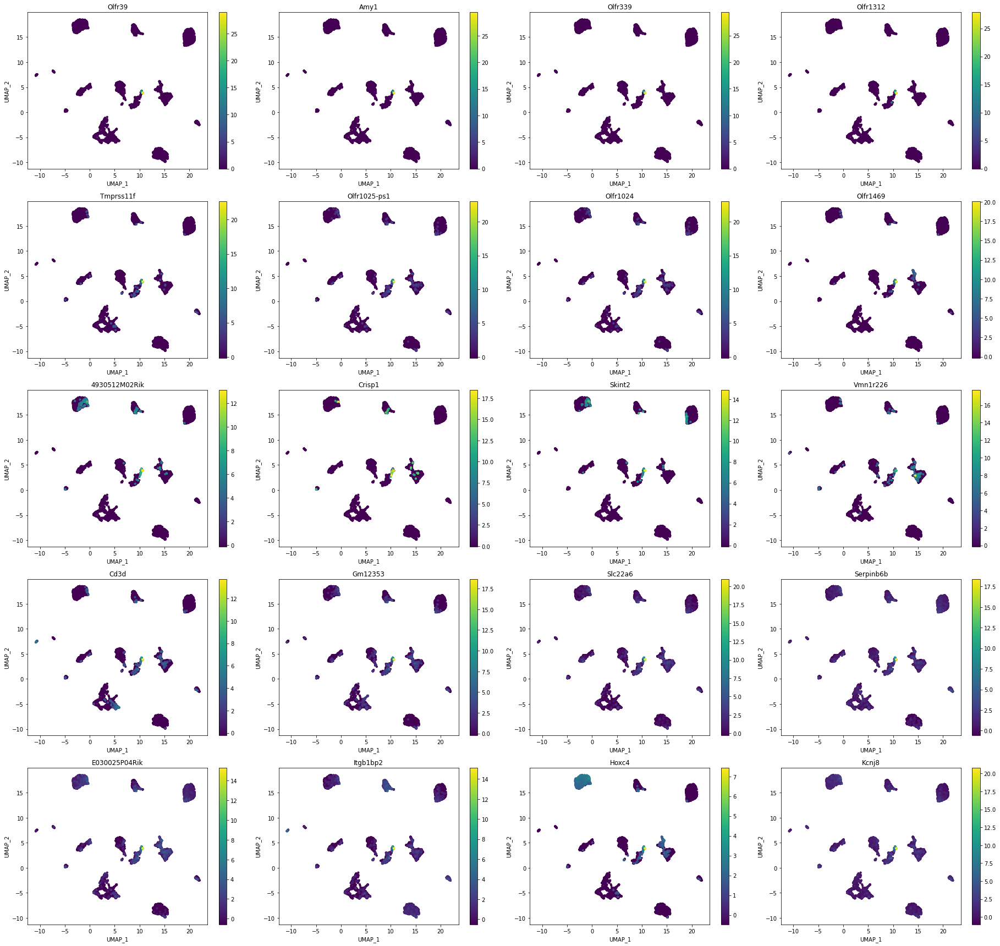

In [159]:
#from pycisTopic.clust_vis import *
plot_imputed_features(cistopic_obj,
                    reduction_name='UMAP',
                    imputed_data=gene_act,
                    features=[markers_dict[x].index.tolist()[0:20] for x in ['DBL3']][0],
                    scale=True,
                    num_columns=4,
                    save='pycistopic_consensus/DAGs/example_best_DAGs_UMAP_DBL3.png')

In [158]:
[markers_dict[x].index.tolist()[0:20] for x in ['DBL4']][0],

(['Olfr715b',
  'Tas2r108',
  'Olfr1130',
  'Gm20767',
  'Olfr813',
  'Olfr812',
  'Esp5',
  'Gm44501',
  'Vmn1r12',
  'Cst11',
  'Lce1a1',
  'Heph',
  'Olfr639',
  'Olfr640',
  'Olfr638',
  'Sele',
  'Smdt1',
  'Pheta2',
  'Eqtn',
  'Olfr463'],)

In [41]:
#from pycisTopic.clust_vis import *
plot_imputed_features(cistopic_obj,
                    reduction_name='UMAP',
                    imputed_data=gene_act,
                    features=[markers_dict[x].index.tolist()[0:10] for x in ['DBL4']][0],
                    scale=True,
                    num_columns=4,
                    save='pycistopic_consensus/DAGs/example_best_DAGs_UMAP_DBL4.png')

KeyError: 'DBL4'

# Write loom file

In [193]:
#Load class
class loom_file_creation:
    import os
    import matplotlib as mpl
    import matplotlib.pyplot as plt
    import pandas as pd
    import numpy as np
    import seaborn as sns
    import scanpy as sc
    def __init__(self,dgem,meta):
        import numpy as np
        import pandas as pd
        self.dgem = dgem
        self.meta = meta
        self.CPM = self.dgem/self.dgem.sum()*1e6
        self.logCPM = np.log1p(self.CPM)
        self.metaJson = {}
        self.metaJson["metrics"] = []
        self.metaJson["annotations"] = []
        #initialize counters
        self.default_embedding_counter = 0
        self.embeddings_id = 1
        self.clusterings_id = 0
        self.col_attrs_counter = 0
        self.row_attrs_counter = 0
        self.attrs_counter = 0
        #add other embeddings
        self.Embeddings_X = pd.DataFrame()
        self.Embeddings_Y = pd.DataFrame()
        #add clusterings
        self.clusterings = pd.DataFrame(index=self.meta.index)
    def add_default_embedding(self,x,y,name="default"):
        self.main_dr = self.meta[[x,y]]
        self.main_dr.columns = ['_X', '_Y']
        self.metaJson['embeddings'] = [
        {
            "id": -1,
            "name": name
        }]
        self.default_embedding_counter = 1
    def add_other_embedding(self,x,y,name):
        #every extra embedding is put in these dataframes as columns
        self.Embeddings_X[str(self.embeddings_id)] = self.meta[x]
        self.Embeddings_Y[str(self.embeddings_id)] = self.meta[y]
        self.metaJson['embeddings'].append(
            {
                "id": self.embeddings_id,
                "name": name
            }
        )
        self.embeddings_id += 1
    #here you can add description of the cluster
    def add_numeric_clustering(self,res,group,name,annotated=None):
        #add all cluster IDs to meta
        if self.clusterings_id==0:
            self.metaJson["clusterings"] = [{
                    "id": self.clusterings_id,
                    "group": group,
                    "name": name,
                    "clusters": [],                
                }]
        if self.clusterings_id>0:
            #add all cluster IDs to meta
            self.metaJson["clusterings"].append({
                        "id": self.clusterings_id,
                        "group": group,
                        "name": name,
                        "clusters": [],                
                    })
        #get annotation for numeric values (count annotation for each numeric value, take the annotation that occurs the most)
        if annotated in self.meta.columns:
            annotation_dataframe = pd.DataFrame(meta.groupby(res)[annotated].value_counts().groupby(res).head(n=1))
            annotation_dataframe.columns = ['test']
            annotation_dataframe = annotation_dataframe.reset_index()
            annotation_dataframe.index = annotation_dataframe[res]
            annotation_dataframe.drop(res,axis=1,inplace=True)
            annotation_dataframe.drop('test',axis=1,inplace=True)
            for i in range(max(set([int(x) for x in self.meta[res]])) + 1):
                clustDict = {}
                clustDict['id'] = i
                clustDict['description'] = annotation_dataframe.loc[i,annotated]
                self.metaJson['clusterings'][self.clusterings_id]['clusters'].append(clustDict)
        else:
            for i in range(max(set([int(x) for x in self.meta[res]])) + 1):
                clustDict = {}
                clustDict['id'] = i
                clustDict['description'] = f'Unannotated Cluster {i}'
                self.metaJson['clusterings'][self.clusterings_id]['clusters'].append(clustDict)
        #add cluster IDs for every cell to dataframe
        self.clusterings[str(self.clusterings_id)] = self.meta[res].values.astype(np.int64)
        #increase counter
        self.clusterings_id += 1
    def dfToNamedMatrix(df):
        arr_ip = [tuple(i) for i in df.values]
        dtyp = np.dtype(list(zip(df.dtypes.index, df.dtypes)))
        arr = np.array(arr_ip, dtype=dtyp)
        return arr
    def make_col_attributes(self):
        #define col attributes
        if self.embeddings_id>1:
            if self.clusterings_id>0:
                self.col_attrs = {"CellID": np.array(self.meta.index),
                                  "Embedding": dfToNamedMatrix(self.main_dr),
                                  "Embeddings_X": dfToNamedMatrix(self.Embeddings_X),
                                  "Embeddings_Y": dfToNamedMatrix(self.Embeddings_Y),
                                  "Clusterings": dfToNamedMatrix(self.clusterings),
                                  "ClusterID": np.array(self.clusterings[str(self.clusterings_id-1)].values)}
            else:
                self.col_attrs = {"CellID": np.array(self.meta.index),
                                  "Embedding": dfToNamedMatrix(self.main_dr),
                                  "Embeddings_X": dfToNamedMatrix(self.Embeddings_X),
                                  "Embeddings_Y": dfToNamedMatrix(self.Embeddings_Y)}
        elif self.clusterings_id>0:
            self.col_attrs = {"CellID": np.array(self.meta.index),
                              "Embedding": dfToNamedMatrix(self.main_dr),
                              "Clusterings": dfToNamedMatrix(self.clusterings),
                              "ClusterID": np.array(self.clusterings[str(self.clusterings_id-1)].values)}
        else:
            self.col_attrs = {"CellID": np.array(self.meta.index),
                              "Embedding": dfToNamedMatrix(self.main_dr)}
        self.col_attrs_counter = 1
    def add_annotation(self,annotation):
        if self.col_attrs_counter<1:
            print("first run make_col_attributes")
        self.metaJson["annotations"].append(
                    {
                        "name": annotation,
                        "values": list(set(self.meta[annotation].values))
                    }
                )
        self.col_attrs[annotation] = np.array(self.meta[annotation].values)
    def add_metric(self,metric):
        if self.col_attrs_counter<1:
            print("first run make_col_attributes")
        self.metaJson["metrics"].append(
                    {
                        "name": metric
                    }
                )
        self.col_attrs[metric] = np.array(self.meta[metric].values)
    def make_row_attributes(self):
        self.row_attrs = {"Gene": np.array(self.dgem.index)}
        self.row_attrs_counter = 1
    def make_attributes(self):
        import json
        import base64
        import zlib
        self.attrs = {"MetaData": json.dumps(self.metaJson)}
        self.attrs['MetaData'] = base64.b64encode(zlib.compress(json.dumps(self.metaJson).encode('ascii'))).decode('ascii')
        self.attrs_counter = 1
    def create_loomfile(self,path):
        import loompy as lp
        if self.col_attrs_counter == 1 and self.row_attrs_counter == 1 and self.default_embedding_counter == 1 and self.attrs_counter == 1:
            lp.create(filename=path,
                      layers=(self.dgem).values, 
                      row_attrs=self.row_attrs, 
                      col_attrs=self.col_attrs, 
                      file_attrs=self.attrs)
        else:
            print("Make sure that col_attr, row_attrs, attrs and embedding have been run")

2021-04-20 13:04:13,743 get_version  INFO     dirname: Trying to get version of get_version from dirname /vsc-hard-mounts/leuven-user/330/vsc33042/.local/lib/python3.7/site-packages
2021-04-20 13:04:13,745 get_version  INFO     dirname: Failed; Does not match re.compile('get[_-]version-([\\d.]+?)(?:\\.dev(\\d+))?(?:[_+-]([0-9a-zA-Z.]+))?$')
2021-04-20 13:04:13,746 get_version  INFO     git: Trying to get version from git in directory /vsc-hard-mounts/leuven-user/330/vsc33042/.local/lib/python3.7/site-packages
2021-04-20 13:04:14,273 get_version  INFO     git: Failed; directory is not managed by git
2021-04-20 13:04:14,276 get_version  INFO     metadata: Trying to get version for get_version in dir /user/leuven/330/vsc33042/.local/lib/python3.7/site-packages
2021-04-20 13:04:14,278 get_version  INFO     metadata: Succeeded
2021-04-20 13:04:14,280 get_version  INFO     dirname: Trying to get version of legacy_api_wrap from dirname /vsc-hard-mounts/leuven-user/330/vsc33042/.local/lib/pyth

In [194]:
def dfToNamedMatrix(df):
    arr_ip = [tuple(i) for i in df.values]
    dtyp = np.dtype(list(zip(df.dtypes.index, df.dtypes)))
    arr = np.array(arr_ip, dtype=dtyp)
    return arr

In [195]:
# make sure cell types contain no illegal characters such as γ
df = pd.DataFrame(gene_act.mtx.T, columns=gene_act.feature_names, index=gene_act.cell_names).T
meta = cistopic_obj.cell_data

In [196]:
loomfile = loom_file_creation(df,meta)
meta['UMAP_X'] = cistopic_obj.projections['cell']['UMAP']['UMAP_1']
meta['UMAP_Y'] = cistopic_obj.projections['cell']['UMAP']['UMAP_2']
loomfile.add_default_embedding(x='UMAP_X',y='UMAP_Y')
# loomfile.add_numeric_clustering(res="pycisTopic_leiden_10_0.9",group="pycisTopic_leiden_10_0.9",name="pycisTopic_leiden_10_0.9",annotated='cell_type')
#loomfile.add_numeric_clustering(res="integrated_snn_res.2",group="Louvain",name="Unannotated")
loomfile.make_col_attributes()
loomfile.make_row_attributes()
loomfile.add_annotation(annotation="cell_type")
loomfile.add_metric(metric="Total_nr_frag")
# loomfile.add_metric(metric="n_genes")
loomfile.make_attributes()
loomfile.create_loomfile("plts_pub/hydrop-atac_cortex_umap_finalannotation.loom")

# Use some Scanpy visualisations on the cistopic obj

In [51]:
import scipy
import scanpy as sc

Write a matrix from gene activity.

In [ ]:
scipy.io.mmwrite('scanpy/test.mtx', gene_act.mtx)
adata = sc.read_mtx('scanpy/test.mtx')
adata = adata.T
adata.obs = cistopic_obj.cell_data
adata.obs_names = cistopic_obj.cell_names
adata.var_names = gene_act.feature_names

In [191]:
adata.obs = cistopic_obj.cell_data
adata.obs_names = cistopic_obj.cell_names
adata.var_names = gene_act.feature_names

In [61]:
adata.obs['cell_type_finetuned'].value_counts()

AST             1251
MOL             1013
MGL              686
OPC              611
L5ET             582
DBL1             570
L5/6 ITa         374
L6CT             344
L2/3b            339
L2/3a            318
L4 IT            276
MGE (Sst+)       267
MGE (Pvalb+)     255
CGE (Vip+)       192
L6b              177
L5/6 ITb         158
CGE (Lamp5+)     111
PIR              108
NP                86
END               82
PER               80
PVM               80
DBL2              36
Name: cell_type_finetuned, dtype: int64

Calculate differentially accessible genes

In [62]:
sc.tl.rank_genes_groups(adata, groupby="cell_type_finetuned", method="logreg")
# sc.pl.rank_genes_groups(adata, save='de.png')

... storing 'barcode' as categorical
... storing 'pycisTopic_leiden_10_0.9' as categorical
... storing 'sample_id' as categorical
... storing 'cisTopic_nr_frag' as categorical
... storing 'Doublet_scores_fragments' as categorical
... storing 'Predicted_doublets_fragments' as categorical
... storing 'cisTopic_nr_acc' as categorical
... storing 'pycisTopic_leiden_10_0.6' as categorical
... storing 'cisTopic_log_nr_acc' as categorical
... storing 'cisTopic_log_nr_frag' as categorical
... storing 'pycisTopic_leiden_10_1.2' as categorical
... storing 'cell_type' as categorical
... storing 'AllenSS_harmony_cell.type' as categorical
... storing 'AllenSS_bbknn_cell.type' as categorical
... storing 'AllenSS_scanorama_cell.type' as categorical
... storing 'AllenSS_cca_cell.type' as categorical
... storing 'finetuned_annotation' as categorical
... storing 'cell_types_finetuned' as categorical
... storing 'cell_type_finetuned' as categorical
/staging/leuven/stg_00002/lcb/fderop/software_2/anaconda

In [63]:
markers = pd.DataFrame.from_records(adata.uns["rank_genes_groups"]["names"])

In [64]:
adata.uns["rank_genes_groups"]

{'params': {'groupby': 'cell_type_finetuned',
  'reference': 'rest',
  'method': 'logreg',
  'use_raw': True,
  'layer': None,
  'corr_method': 'benjamini-hochberg'},
 'names': rec.array([('Tppp2', 'Cenpq', 'Olfr1416', 'Prop1', 'Gm11238', 'AW551984', 'Lelp1', 'Ankrd49', 'Olfr1382', 'Spertl', 'Vmn1r195', 'Olfr452', 'Olfr535', 'Apol7b', 'Vmn1r217', 'Crygb', 'Gtsf2', 'Gm1979', 'Ankrd49', 'Dcpp1', 'Zfp868', 'Ankrd49', 'Hoxa7'),
            ('Apoc1', 'Clptm1l', '2310057M21Rik', 'Olfr452', 'BC049762', 'Oas1b', 'Zfp369', 'Zfp369', 'Olfr1381', 'Olfr535', 'Setdb2', 'Prop1', 'Olfr557', 'Hba-a1', 'Nphs2', 'Rnf113a1', 'C1qc', 'Olfr1331', 'Zfp975', 'Dcpp2', 'Zkscan4', 'Bglap2', 'Tssk2'),
            ('Apoe', 'Mmut', 'Krtap29-1', 'Nle1', 'Gm4924', 'Fut1', 'Vpreb1', 'Nle1', 'Wfdc6a', 'Olfr316', 'Gm11034', 'Ufsp2', 'Trim68', 'Gm3250', 'Zfp830', '1700056E22Rik', 'Cebpz', 'Cldn34c1', 'Olfr97', 'Gpr17', 'Fau', 'AW551984', 'Tssk1'),
            ...,
            ('Cfi', 'Cldn34c1', 'Cebpz', 'Clptm1l', 'Cld

And plot them

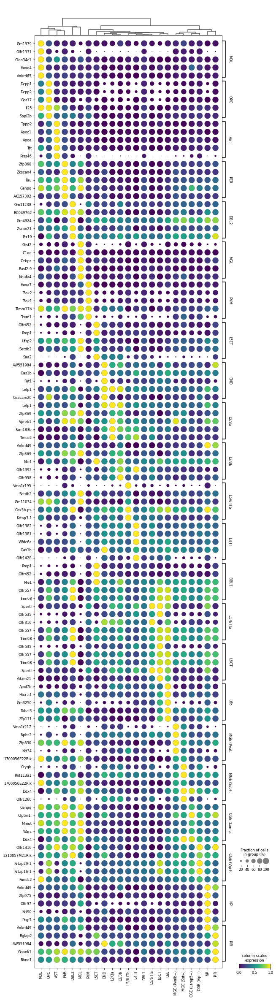

In [66]:
ngenes = 5
mdict = markers.iloc[0:ngenes].to_dict("list")
sc.tl.dendrogram(adata, groupby="cell_type_finetuned")
sc.pl.dotplot(
    adata,
    mdict,
    "cell_type_finetuned",
    standard_scale="var",
    colorbar_title="column scaled\nexpression",
    cmap="viridis",
    dendrogram=True,
    save="cluster_markergenes_dotplot.pdf",
    swap_axes=True,
)
# sc.pl.umap(adata, color='cell_type', save='annotated.svg', palette = sns.color_palette('husl', 24))

the above markers don't work at all

In [84]:
mdict = {
'MOL': ['Plp1', 'Prr5l', 'Mal'],
'OPC': ['Cspg4', 'Pdgfra', 'Gpr17'],
'AST': ['Slco1c1', 'Ntsr2', 'Mertk'],
'MGL': ['C1qc', 'Csf1r', 'Selplg'],
'L5 IT': ['Il1rapl2', 'Deptor', 'Etv1'],
'L5 NP': ['Vwc2l', 'Stard5', 'Lcp1'],
'L5 PT': ['Magi2', 'Gm19410'],
'L5/6 IT': ['Ptprt', 'Galnt14', 'Cdh9'],
'D1 MSN': ['Ebf1', 'Drd1', 'Tac1'],
'D2 MSN': ['Drd2', 'Penk', 'Adora2a'],
'L2/3 IT': ['Dgkb', 'Rgs6', 'Chrm3'],
'L2/3 IT APr': ['Tshz2', 'Lsamp', 'Inpp4b'],
"L2/3 IT'": ['Glis3', 'Rfx3'],
'L4/5 IT': ['Pcdh15', 'Mamdc2', 'Prr16'],
"L4/5 IT'": ['Pld5', 'Myo16', 'Rorb'],
"L4/5 IT''": ['Scn7a', 'Thsd7a', 'Col26a1'],
'L6 CT': ['Foxp2', 'Garnl3', 'Syt6'],
"L6 CT'": ['Rxfp1', 'Cobll1'],
'L6 IT Car3+': ['Col11a1', 'Oprk1', 'B3gat2'],
'CGE Lamp5+': ['Pde11a', 'Adarb2', 'Frem1'],
'CGE Vip+': ['Vip', 'Igf1', 'Adarb2'],
'L6b+': ['Svil', 'Inpp4b'],
'MGE Chodl+': ['Nos1', 'Tacr1', 'Ndst4'],
'MGE Pvalb+': ['Erbb4', 'Gpr176', 'Btbd11'],
'MGE Sst+': ['Sst', 'Grin3a', 'Synpr'],
'L2 IT ENTm': ['Lef1', 'Cpa6', 'Gpc5'],
'L3 IT ENTI': ['Mybpc1', 'Fermt1'],
'L3 RSP ACA': ['Rreb1', 'Cbln1'],
'VLMC': ['Cped1', 'Slc6a13', 'Aebp1'],
'DBL': ['Pdgfra', 'Gpr17', 'Cspg4'],
"DBL'": ['Atp1a2', 'Gja1', 'Slc1a3'],
'L2 IT': ['Glra3', 'Cpa6', 'Npnt'],
}

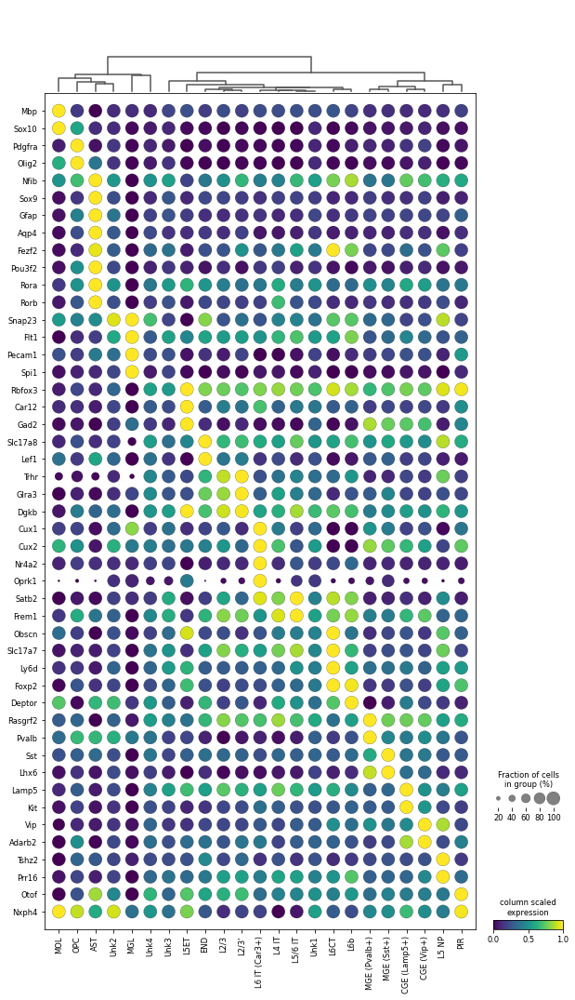

In [196]:
sc.tl.dendrogram(adata, groupby="cell_type_finetuned")
sc.pl.dotplot(
    adata,
    features,
    "cell_type_finetuned",
    standard_scale="var",
    colorbar_title="column scaled\nexpression",
    cmap="viridis",
    dendrogram=True,
    save="cluster_markergenes_dotplot_manual.svg",
    swap_axes=True,
)
# sc.pl.umap(adata, color='cell_type', save='annotated.svg', palette = sns.color_palette('husl', 24))

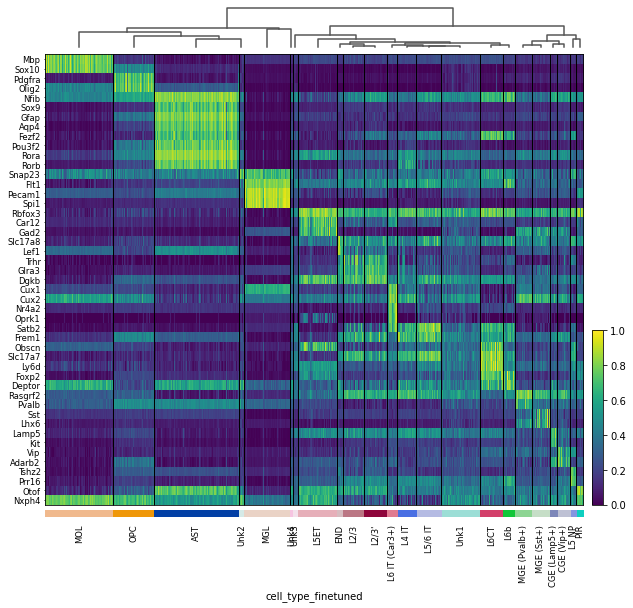

In [200]:
sc.tl.dendrogram(adata, groupby="cell_type_finetuned")
sc.pl.heatmap(
    adata,
    features,
    "cell_type_finetuned",
    standard_scale="var",
    cmap="viridis",
    dendrogram=True,
    save="cluster_markergenes_dotplot_manual.png",
    swap_axes=True,
)
# sc.pl.umap(adata, color='cell_type', save='annotated.svg', palette = sns.color_palette('husl', 24))